In [255]:
##################################
### Import the usual libraries ###
##################################

### Other
import warnings
warnings.filterwarnings('ignore')

### Matplotlib
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
matplotlib.rcParams.update({'font.size': 25})

import numpy as np
import astropy
from astropy.io import fits
from astropy.table import Table

from tqdm import tqdm_notebook

In [8]:
### massive
massive = fits.getdata('/Users/joshuapovick/Desktop/Research/parsec/parsec_massive.fits.gz',0)
massive = massive[np.where((massive['label']==3.0)|(massive['label']==4.0)|(massive['label']==5.0)|
                           (massive['label']==6.0)|(massive['label']==7.0))]
# massive = massive[np.argsort(massive['logAge'])]
massive = Table(massive)['label','MH','logAge','logTe','logg','Gmag','G_BPmag','G_RPmag','Jmag','Hmag','Ksmag']
massive.columns

<TableColumns names=('label','MH','logAge','logTe','logg','Gmag','G_BPmag','G_RPmag','Jmag','Hmag','Ksmag')>

In [175]:
### GCS Data
gcs = fits.getdata('/Users/joshuapovick/Desktop/Research/fits/allStar-r13-l33-58932beta_apa_dist_galvel_gc.fits.gz')
cln = np.where((gcs['FE_H']>-9999.0)&(gcs['AK_TARG']>-9999.0)&(gcs['LOGG']>0.0)&
                (gcs['C_FE']>-9999.0)&(gcs['N_FE']>-9999.0))
gcs = Table(gcs[cln])

### Find Cluster with more than one star

idx = []
for i in range(len(np.unique(gcs['CLUSTER']))):
    idx.append(np.squeeze(np.where(gcs['CLUSTER']==np.unique(gcs['CLUSTER'])[i])))

for i in range(len(idx)):
    try:
        len(idx[i])
    except:
        print('bad: ',i)
        
good_names = []
for i in np.asarray(idx)[np.delete(np.asarray(list(range(len(idx)))),[24,27,37])]:
    if np.size(i)>10:
        good_names.append(gcs['CLUSTER'][i][0])

print(good_names)

good_clus = np.where((gcs['CLUSTER']=='47Tuc')|(gcs['CLUSTER']=='M10')|(gcs['CLUSTER']=='M107')|
                     (gcs['CLUSTER']=='M12')|(gcs['CLUSTER']=='M13')|(gcs['CLUSTER']=='M19')|
                     (gcs['CLUSTER']=='M2')|(gcs['CLUSTER']=='M22')|(gcs['CLUSTER']=='M3')|
                     (gcs['CLUSTER']=='M4')|(gcs['CLUSTER']=='M5')|(gcs['CLUSTER']=='M53')|
                     (gcs['CLUSTER']=='M54')|(gcs['CLUSTER']=='M55')|(gcs['CLUSTER']=='M71')|
                     (gcs['CLUSTER']=='M79')|(gcs['CLUSTER']=='NGC1851')|(gcs['CLUSTER']=='NGC2808')|
                     (gcs['CLUSTER']=='NGC288')|(gcs['CLUSTER']=='NGC3201')|(gcs['CLUSTER']=='NGC362')|
                     (gcs['CLUSTER']=='NGGC6388')|(gcs['CLUSTER']=='NGC6397')|(gcs['CLUSTER']=='NGC6752'))#|
#                      (gcs['CLUSTER']=='omegaCen'))

gcs = gcs[good_clus]

### DR17
dr17 = fits.getdata('/Users/joshuapovick/Desktop/Research/fits/allStarLite-dr17-synspec.fits.gz')
_, gcs_ind, dr17_ind = np.intersect1d(gcs['APOGEE_ID'], dr17['APOGEE_ID'], return_indices=True)

gcsdr17 = dr17[dr17_ind]
gcs = gcs[gcs_ind]

bad:  24
bad:  27
bad:  37
['47Tuc', 'M10', 'M107', 'M12', 'M13', 'M19', 'M2', 'M22', 'M3', 'M4', 'M5', 'M53', 'M54', 'M55', 'M71', 'M79', 'NGC1851', 'NGC2808', 'NGC288', 'NGC3201', 'NGC362', 'NGC6388', 'NGC6397', 'NGC6752', 'omegaCen']


In [177]:
np.where((gcs['APOGEE_ID']==gcsdr17['APOGEE_ID'])!=True)

(array([], dtype=int64),)

In [85]:
gcs_ages = np.array([11.75,11.75,12.00,13.00,12.00,12,11.75,12.50,11.75,11.50,11.50,12.25,11.75,13.00,11.00,11.14,
                     11.00,11.00,11.50,10.75,12.03,13.00,12.50])

gcs_clus = np.unique(gcs['CLUSTER'])

In [179]:
len(gcs_clus)==len(gcs_ages)

True

In [86]:
def closest(data,value):
    '''
    Find nearest value in array to given value
        
    Inputs:
    ------
        data: data to search through 
        value: value of interest
    '''
        
    data = np.asarray(data)
    return data[(np.abs(np.subtract(data,value))).argmin()]

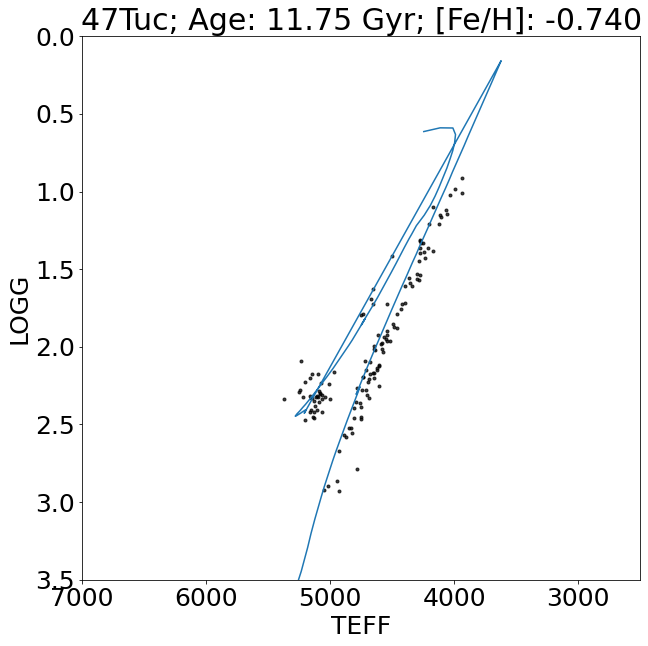

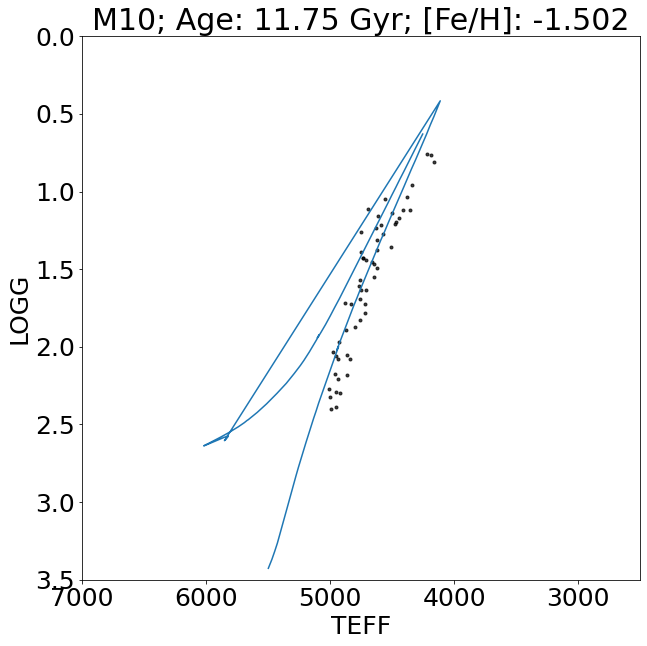

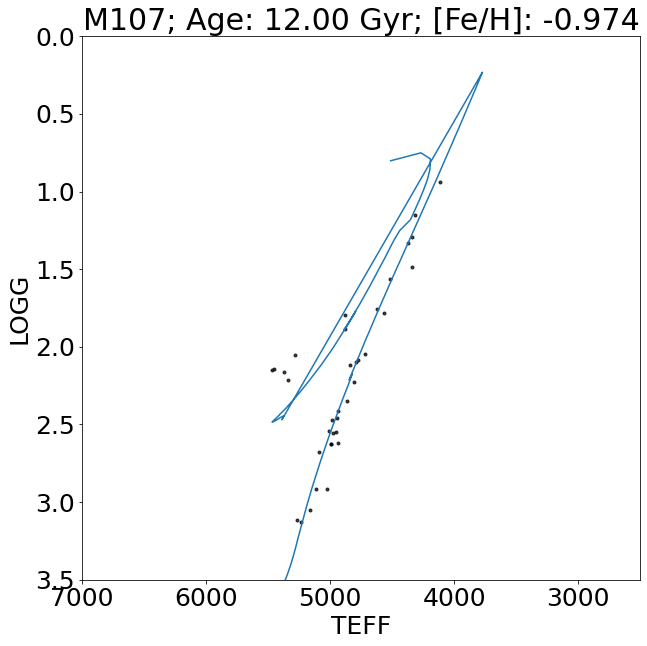

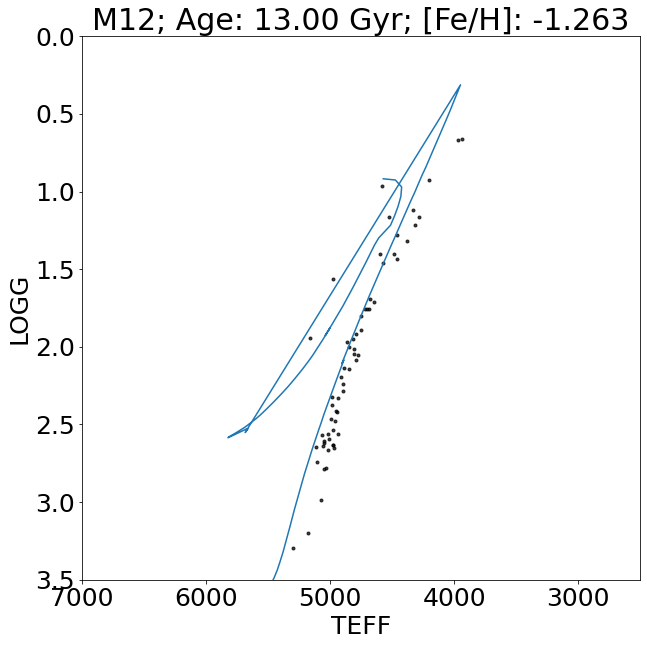

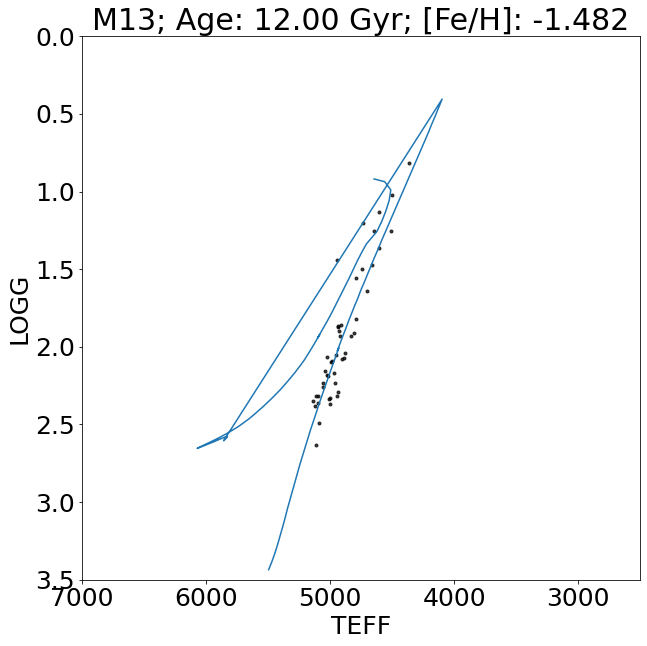

...

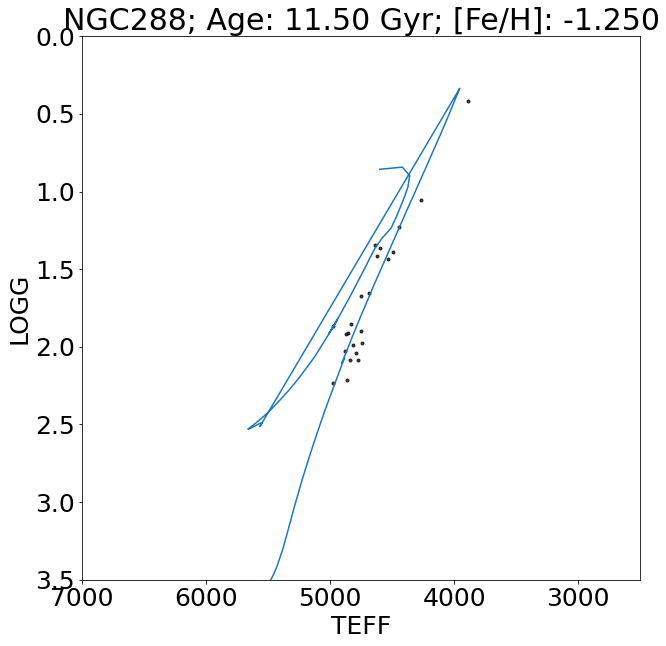

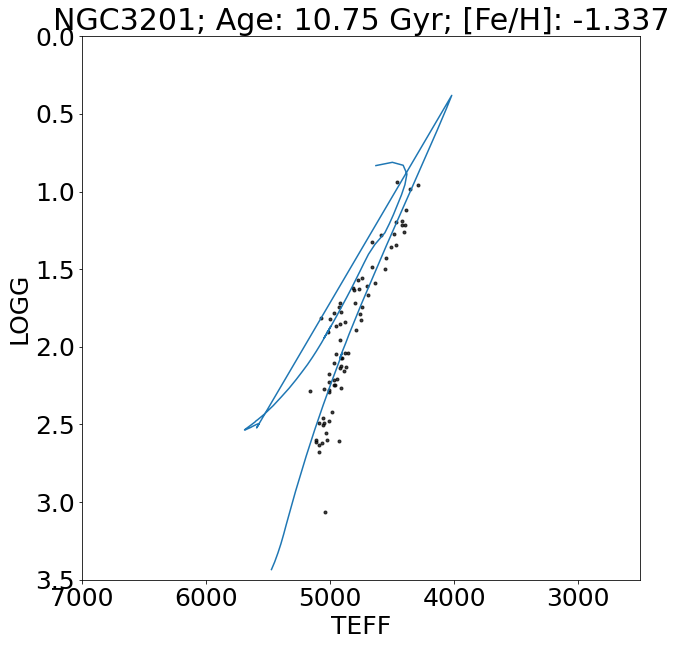

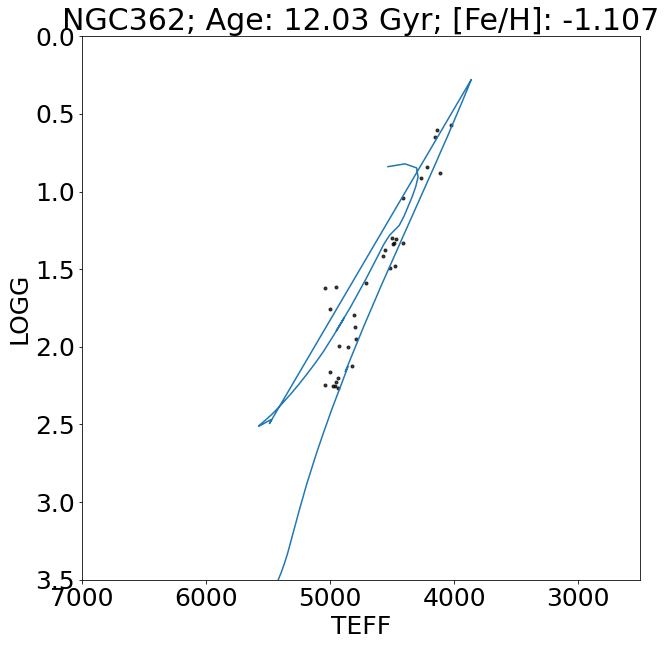

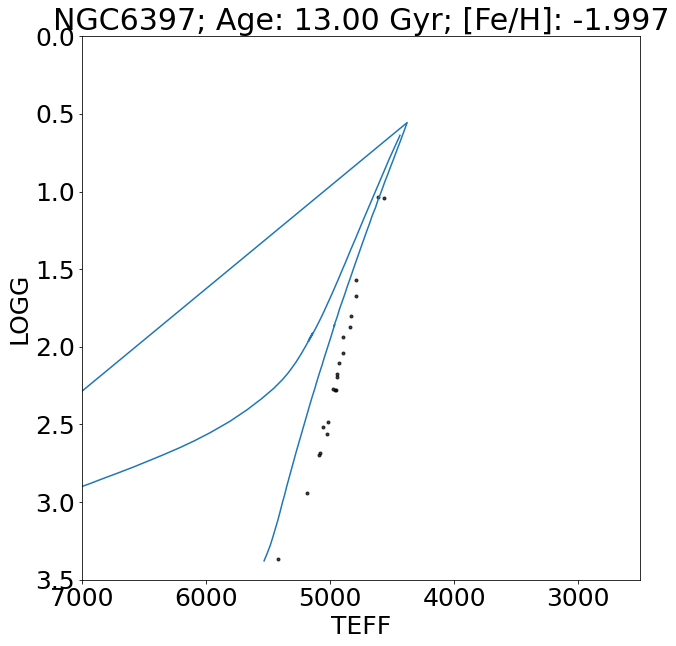

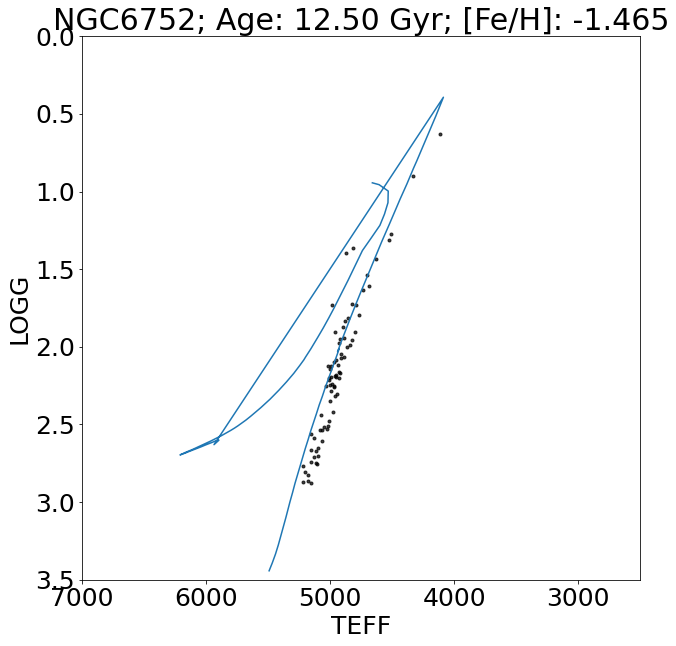

In [184]:
for i in range(len(gcs_clus)):
    # FE_H cut
    clus = np.where(gcs['CLUSTER']==gcs_clus[i])

    isopick1 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(gcsdr17['FE_H'][clus])))&
                        (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    plt.figure(figsize=[10,10])
    
    plt.plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],c='tab:blue')
    plt.scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    plt.xlabel(r'TEFF')
    plt.ylabel(r'LOGG')
    plt.ylim(0,3.5)
    plt.xlim(2500,7000)
    plt.gca().invert_yaxis()
    plt.gca().invert_xaxis()
    
    plt.title(r'{}; Age: {:.2f} Gyr; [Fe/H]: {:.3f}'.format(gcs_clus[i],gcs_ages[i],
                                                                        np.nanmedian(gcsdr17['FE_H'][clus])))
    plt.savefig('{}FullsHRDR17.pdf'.format(gcs_clus[i]),bbox_inches='tight')
    plt.show()

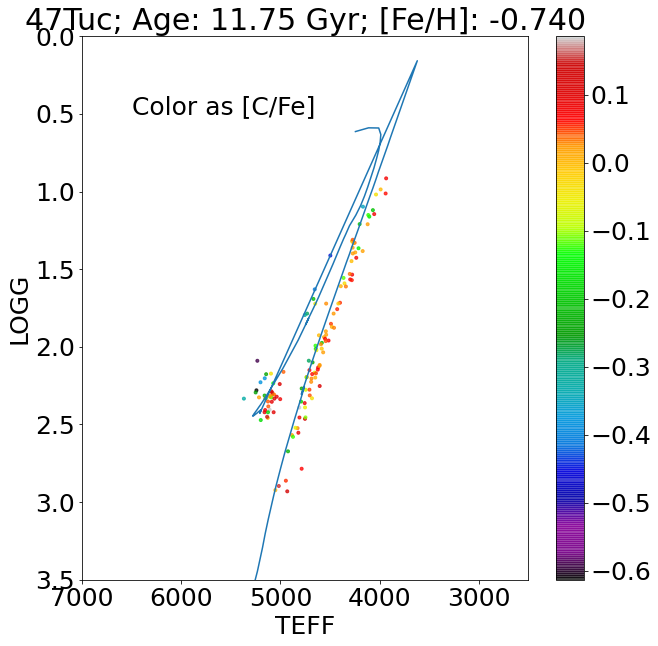

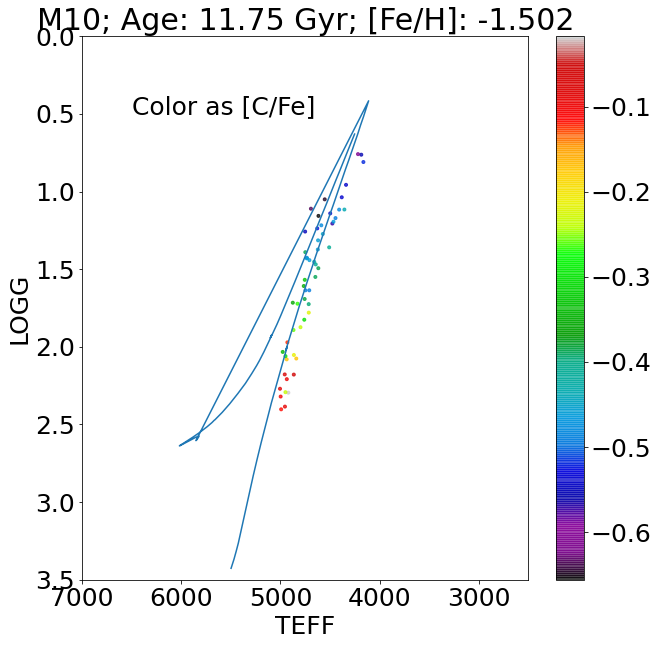

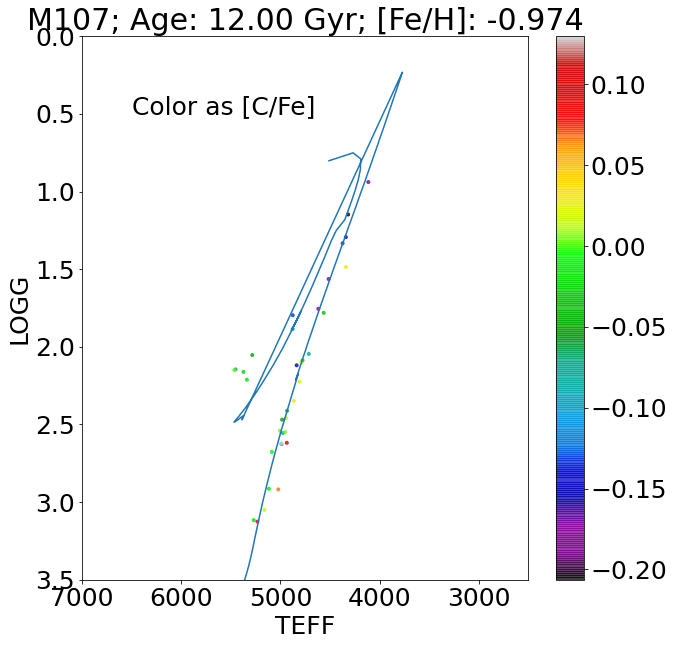

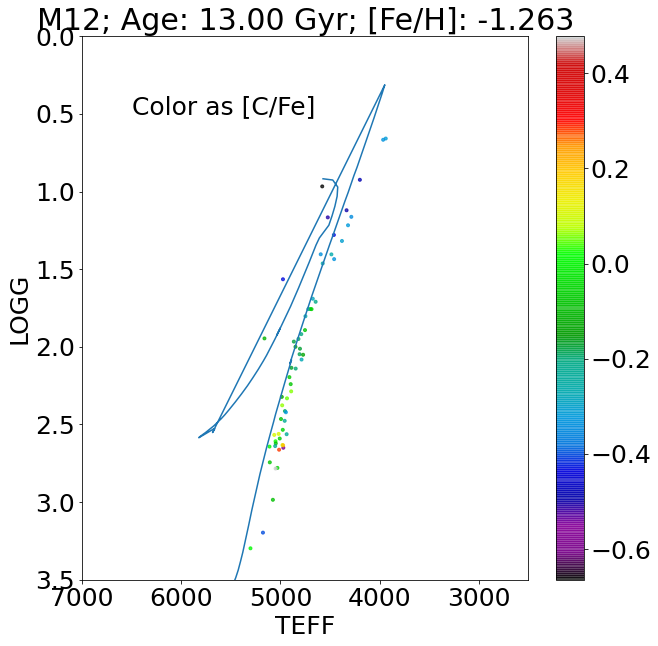

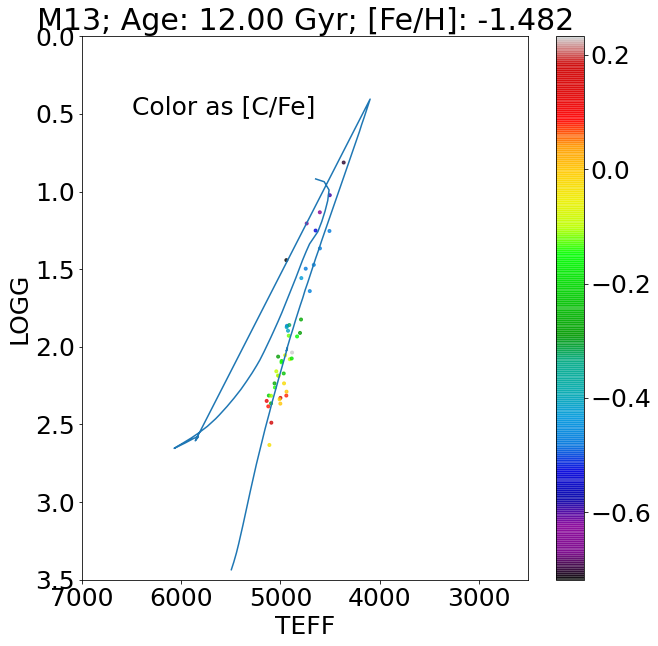

...

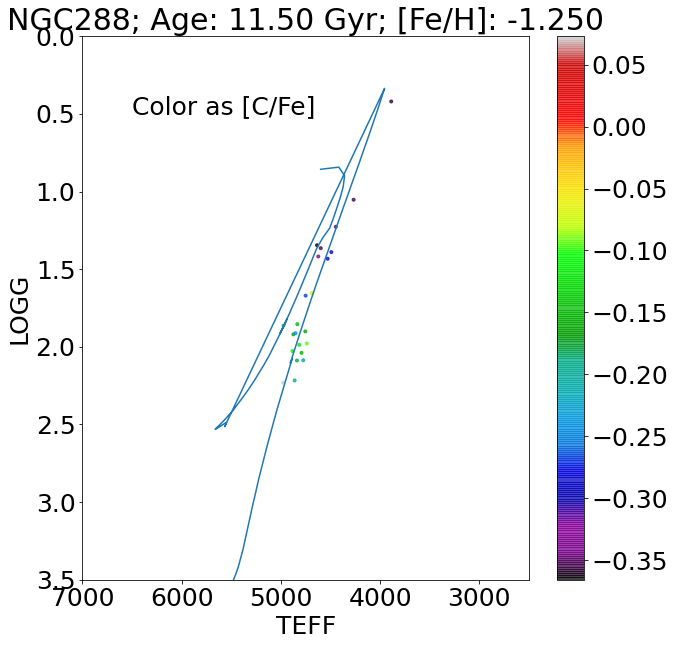

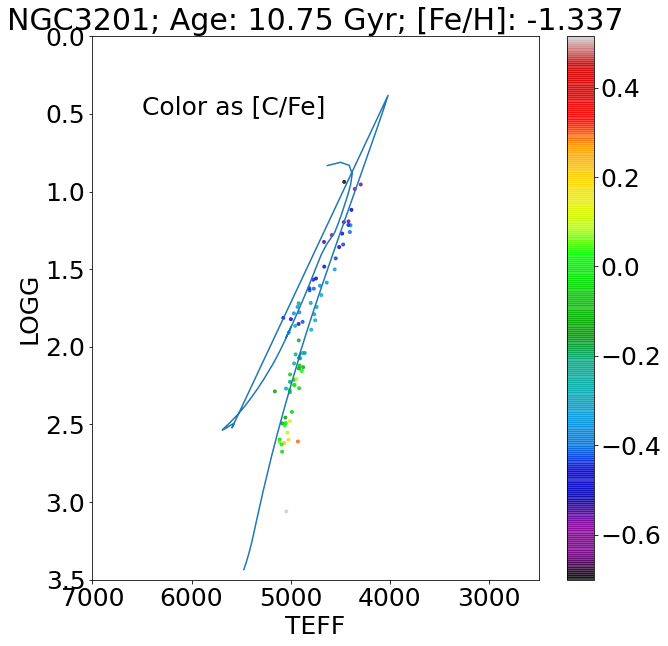

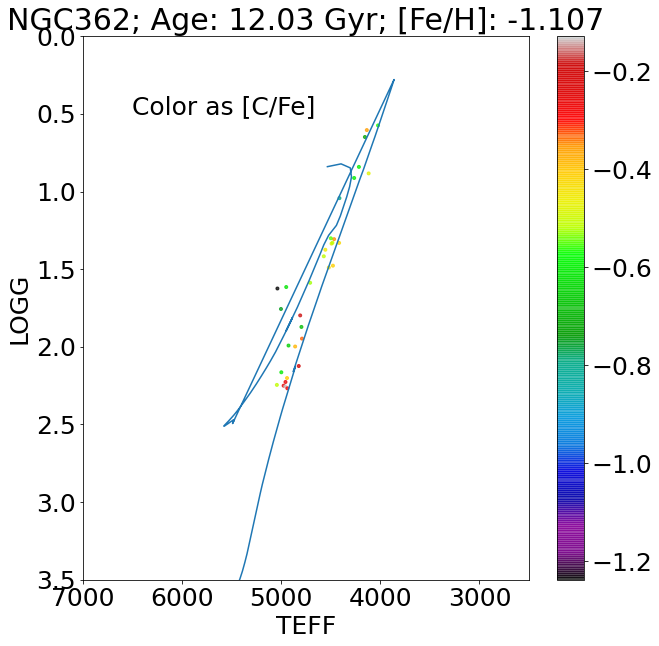

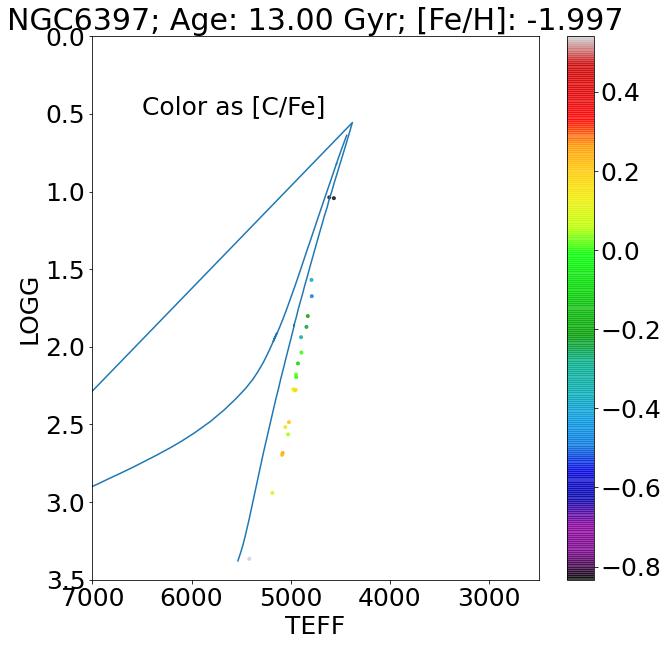

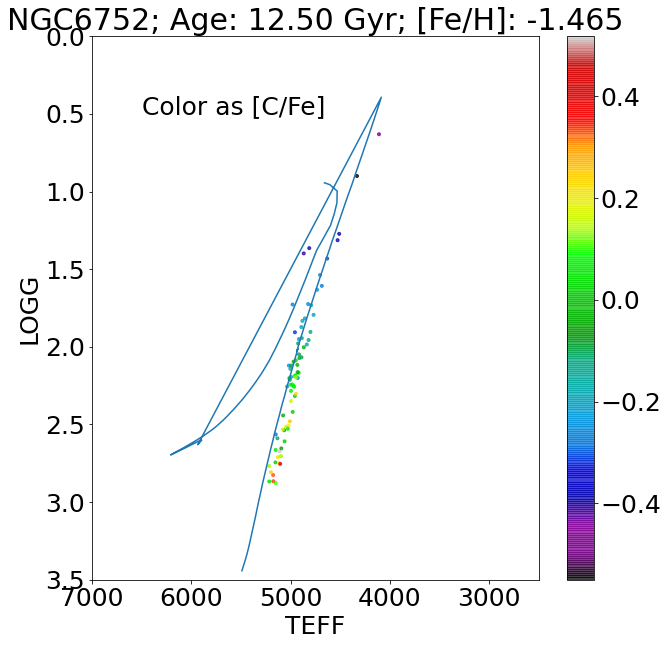

In [185]:
for i in range(len(gcs_clus)):
    clus = np.where(gcs['CLUSTER']==gcs_clus[i])

    isopick1 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(gcsdr17['FE_H'][clus])))&
                        (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    plt.figure(figsize=[10,10])
    
    plt.plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],c='tab:blue')
    plt.scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c=gcsdr17['C_FE'][clus],marker='.',zorder=1,alpha=0.75,
                cmap='nipy_spectral')
    plt.text(6500,0.5,'Color as [C/Fe]')
    plt.colorbar()
    plt.xlabel(r'TEFF')
    plt.ylabel(r'LOGG')
    plt.ylim(0,3.5)
    plt.xlim(2500,7000)
    plt.gca().invert_yaxis()
    plt.gca().invert_xaxis()
    
    plt.title(r'{}; Age: {:.2f} Gyr; [Fe/H]: {:.3f}'.format(gcs_clus[i],gcs_ages[i],
                                                                        np.nanmedian(gcsdr17['FE_H'][clus])))
    plt.savefig('{}CarbonFullsHRDR17.pdf'.format(gcs_clus[i]),bbox_inches='tight')
    plt.show()

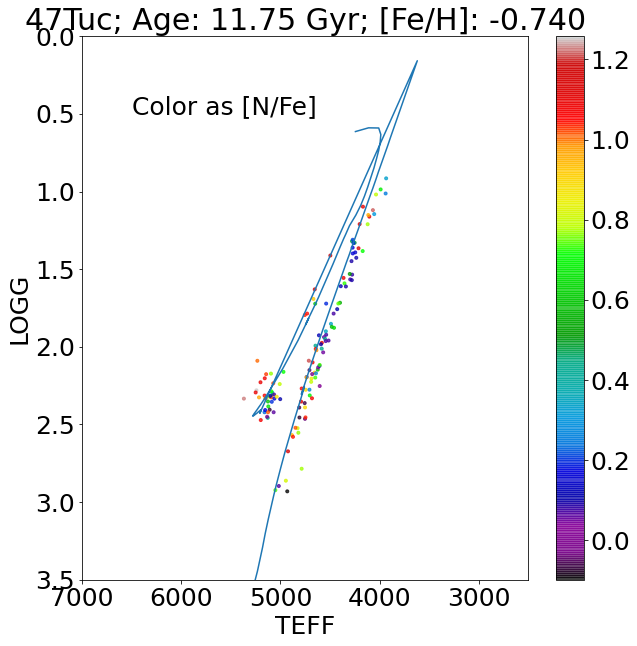

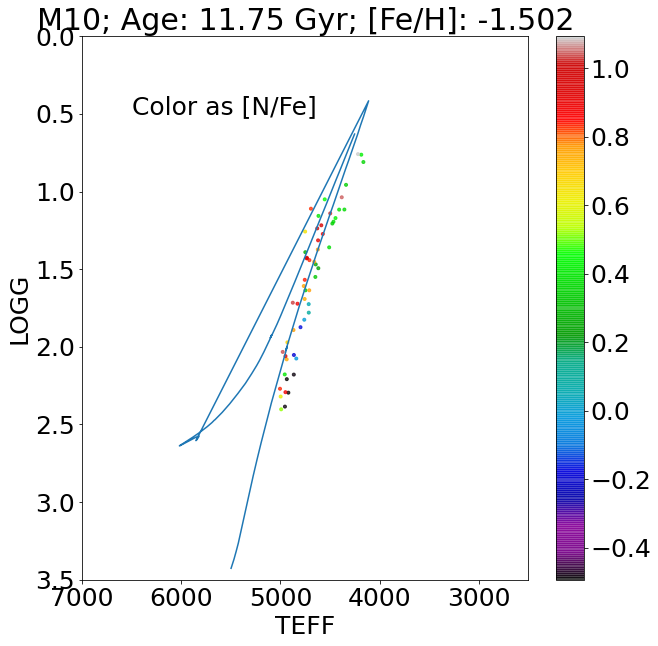

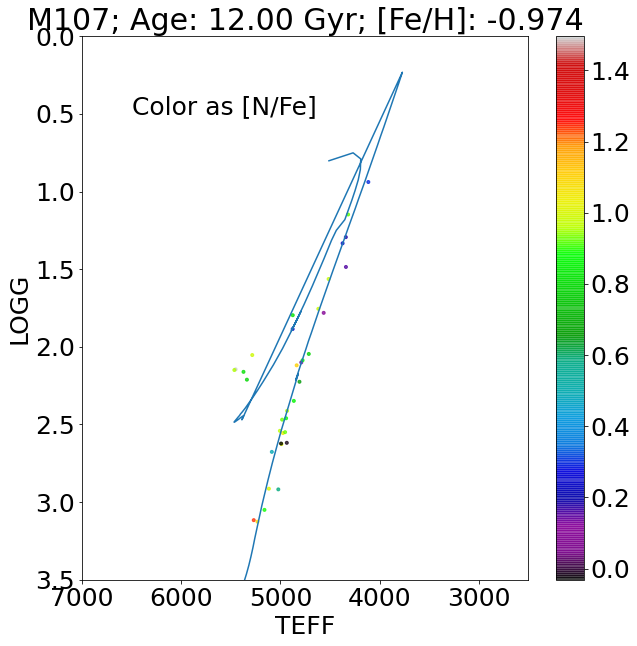

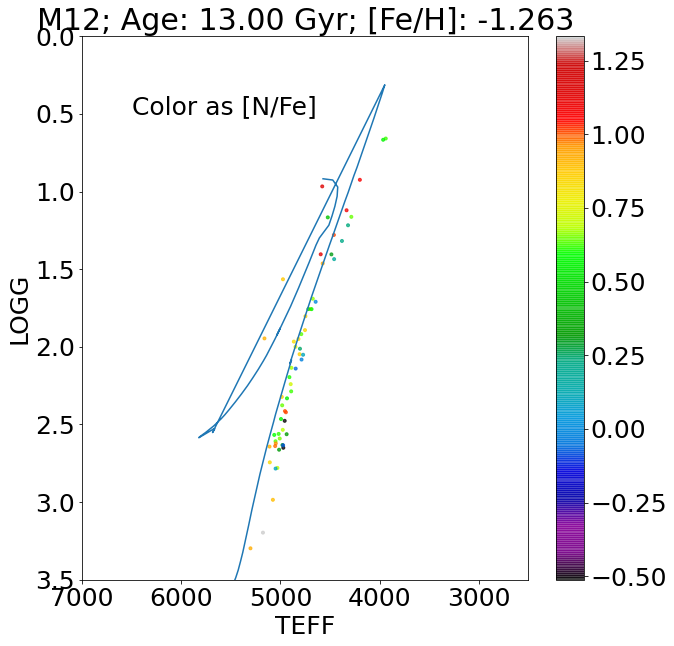

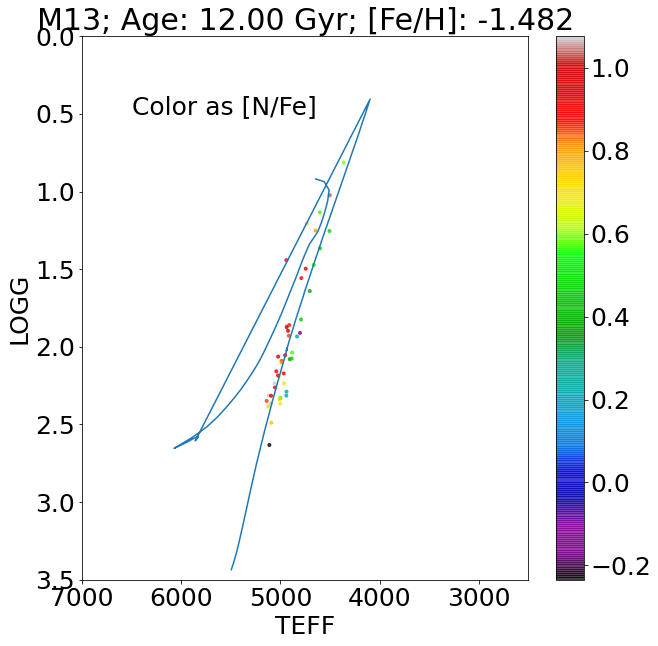

...

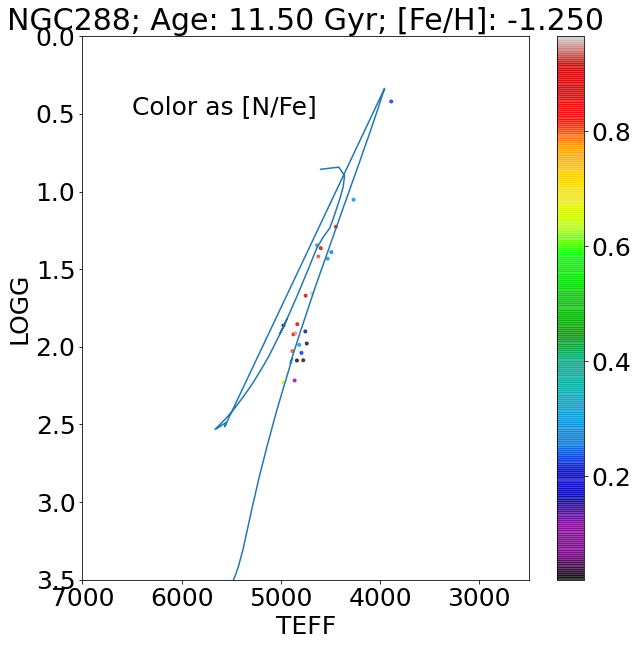

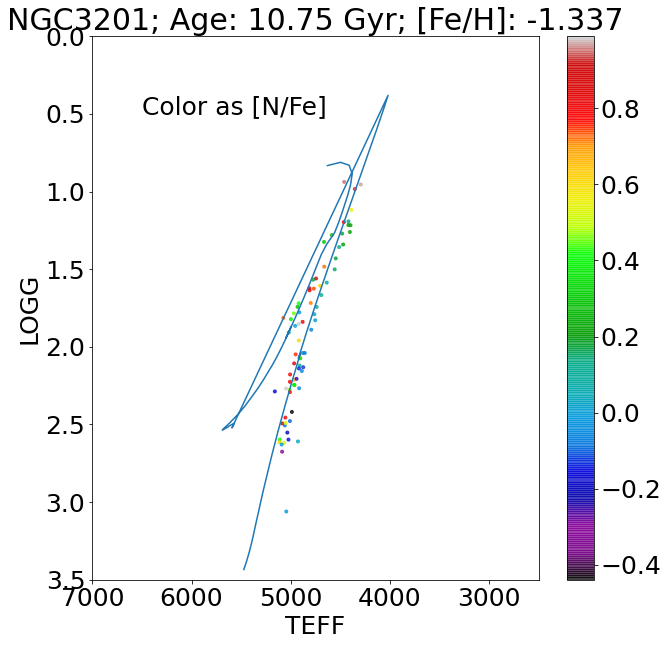

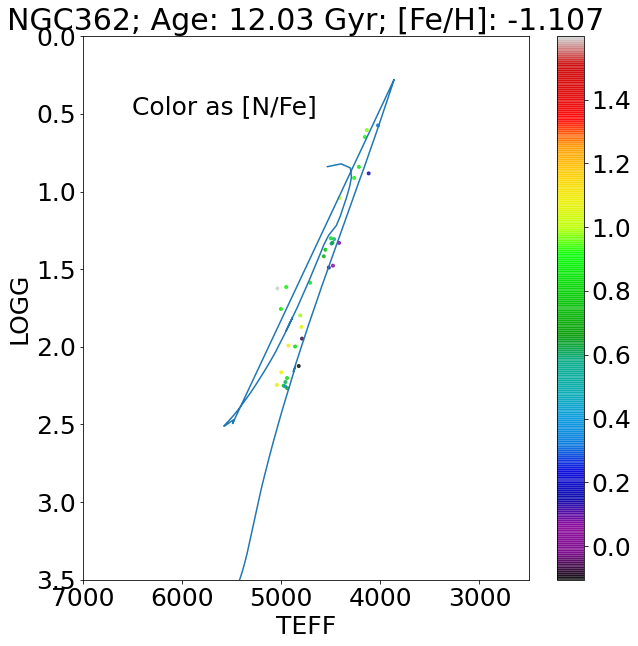

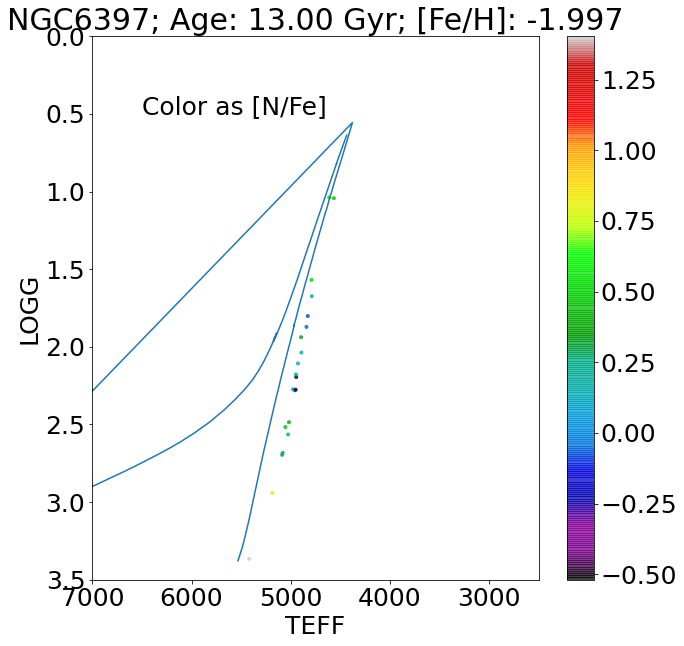

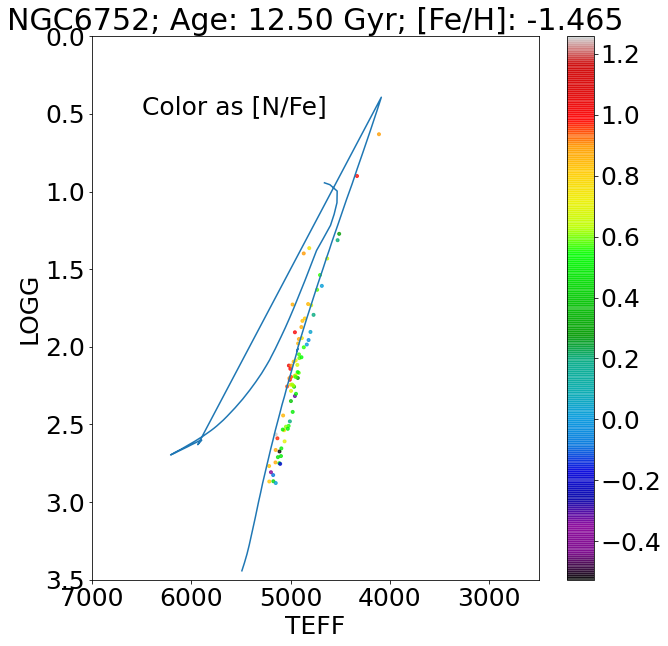

In [186]:
for i in range(len(gcs_clus)):
    clus = np.where(gcs['CLUSTER']==gcs_clus[i])

    isopick1 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(gcsdr17['FE_H'][clus])))&
                        (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    plt.figure(figsize=[10,10])
    
    plt.plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],c='tab:blue')
    plt.scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c=gcsdr17['N_FE'][clus],marker='.',zorder=1,alpha=0.75,
                cmap='nipy_spectral')
    plt.text(6500,0.5,'Color as [N/Fe]')
    plt.colorbar()
    plt.xlabel(r'TEFF')
    plt.ylabel(r'LOGG')
    plt.ylim(0,3.5)
    plt.xlim(2500,7000)
    plt.gca().invert_yaxis()
    plt.gca().invert_xaxis()
    
    plt.title(r'{}; Age: {:.2f} Gyr; [Fe/H]: {:.3f}'.format(gcs_clus[i],gcs_ages[i],
                                                                        np.nanmedian(gcsdr17['FE_H'][clus])))
    plt.savefig('{}NitrogenFullsHRDR17.pdf'.format(gcs_clus[i]),bbox_inches='tight')
    plt.show()

10.070039999999999


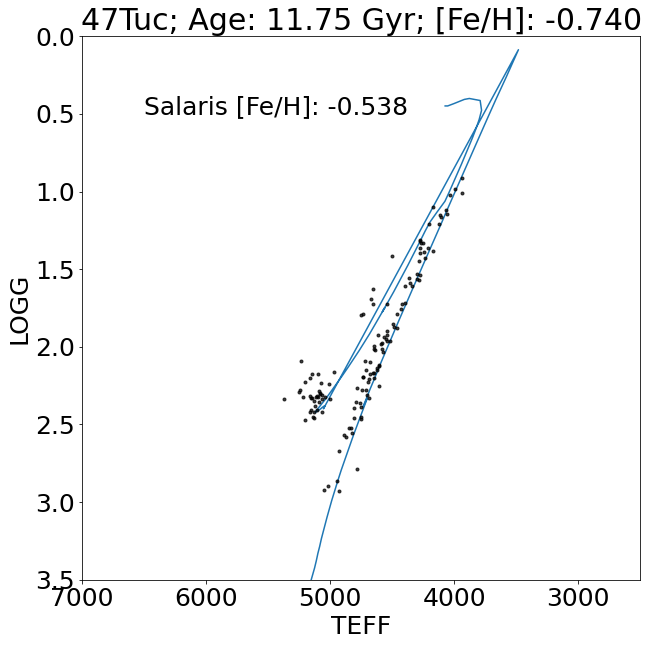

10.070039999999999


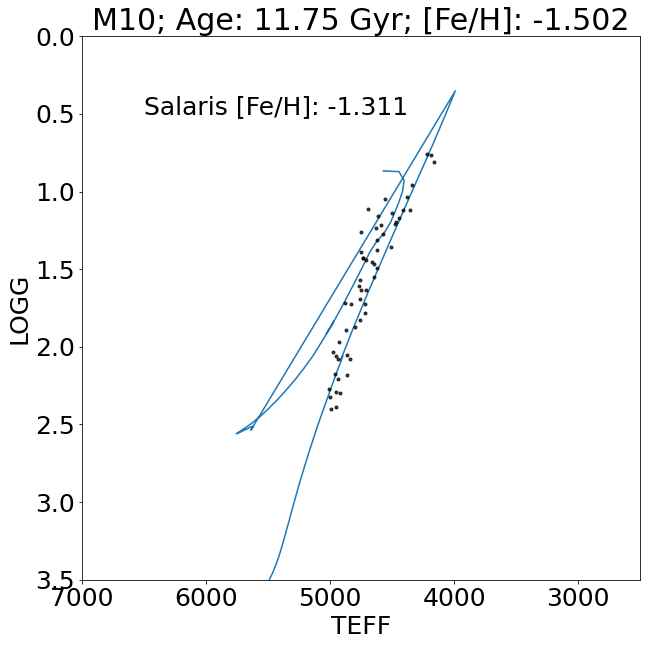

10.079180000000001


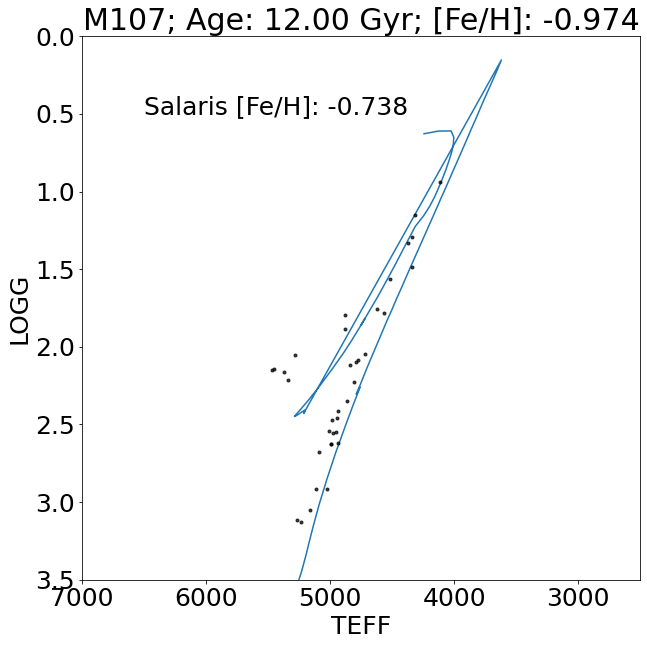

10.11394


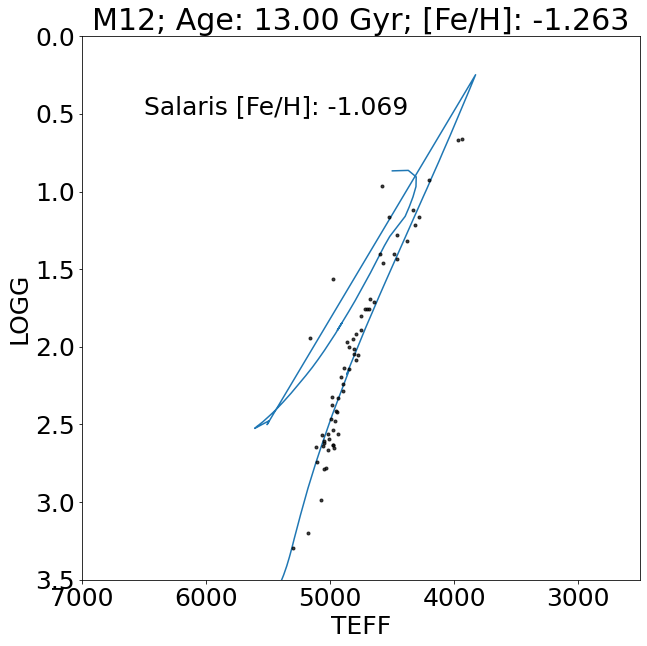

10.079180000000001


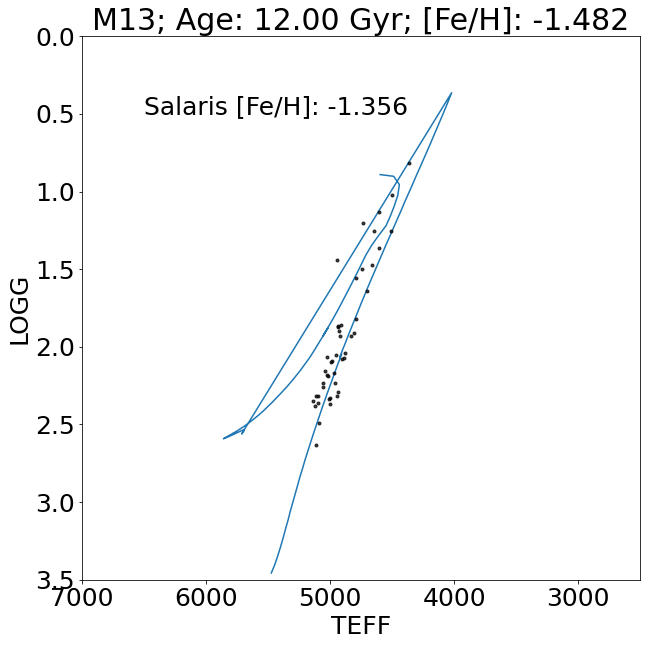

10.079180000000001


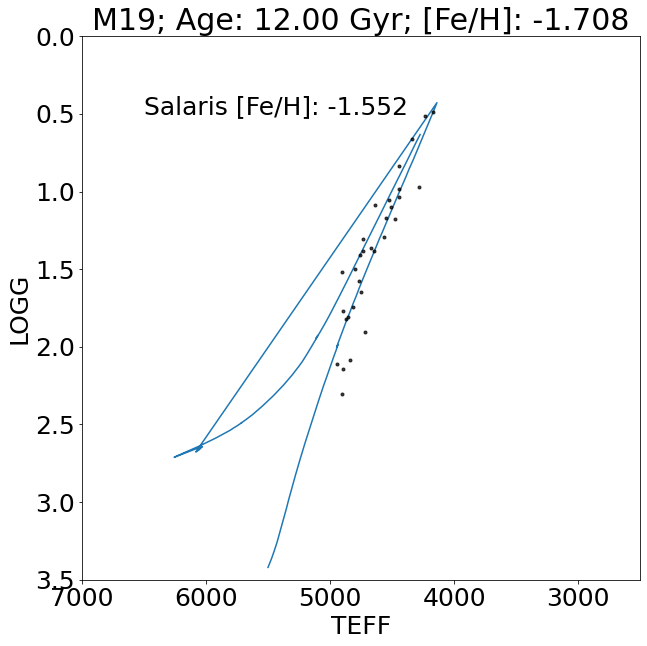

10.070039999999999


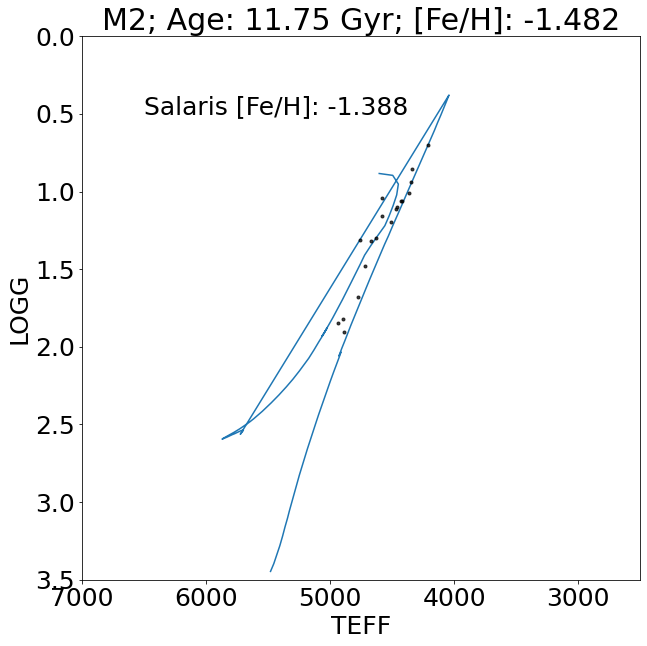

10.096910000000001


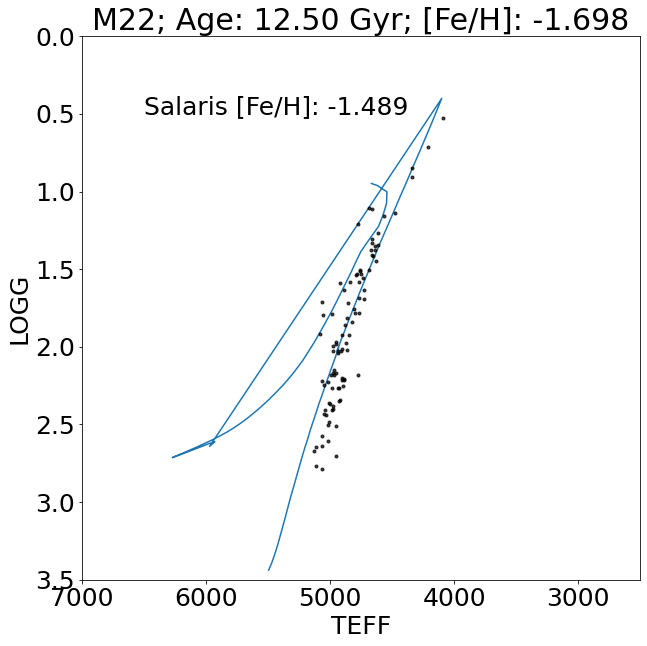

10.070039999999999


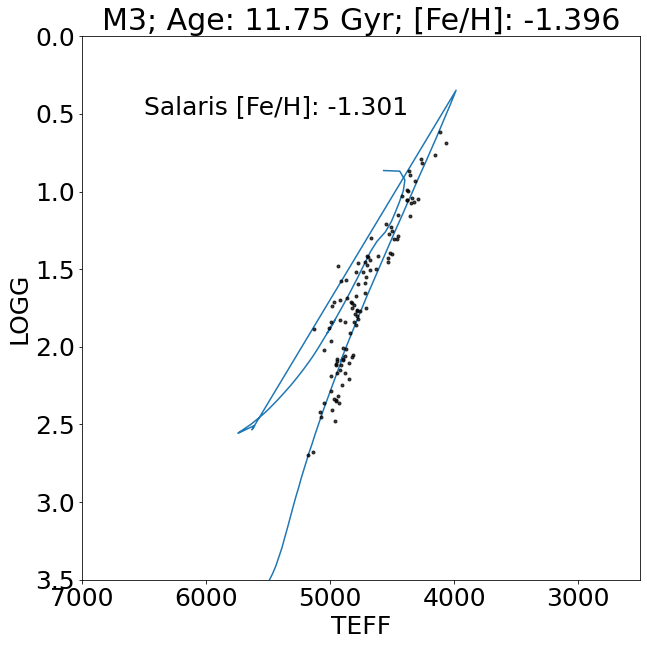

10.0607


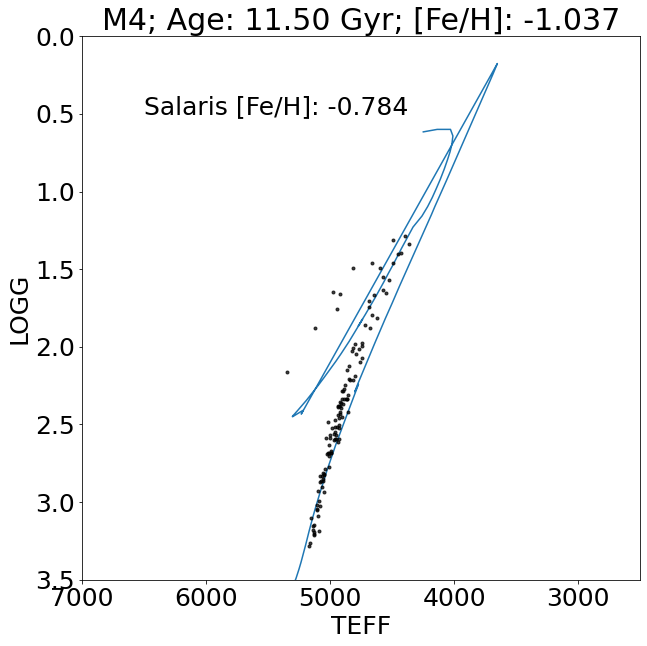

10.0607


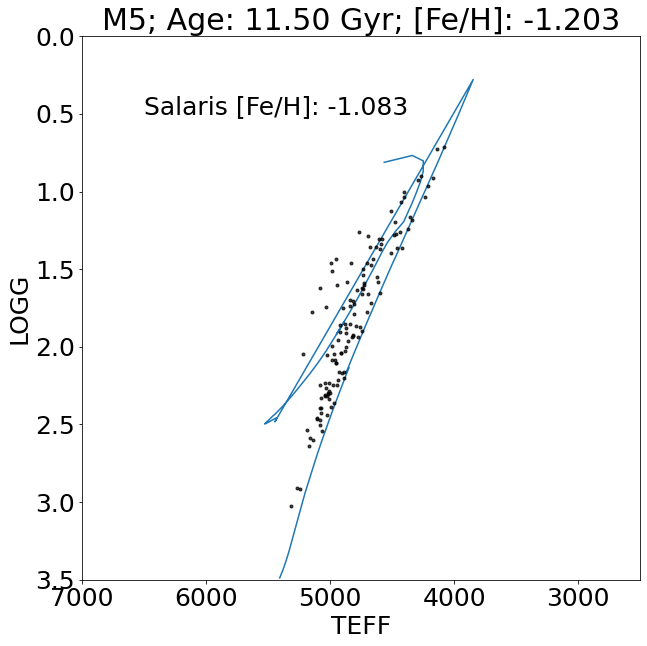

10.08814


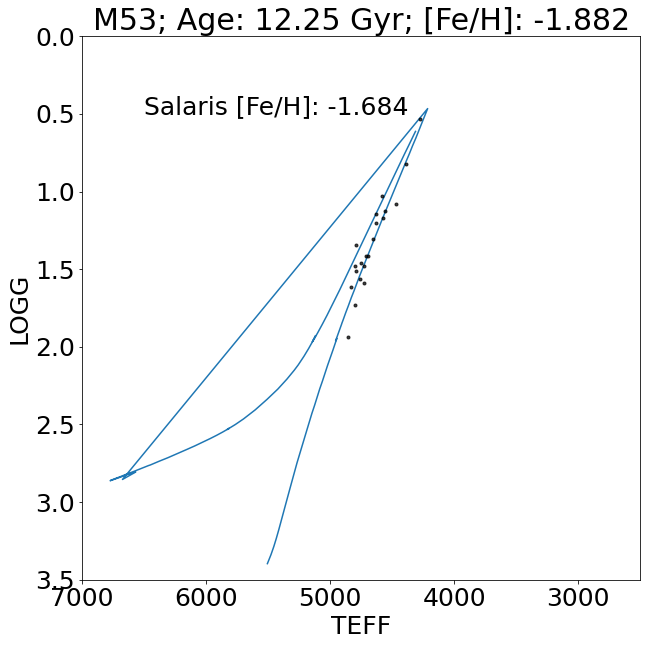

10.070039999999999


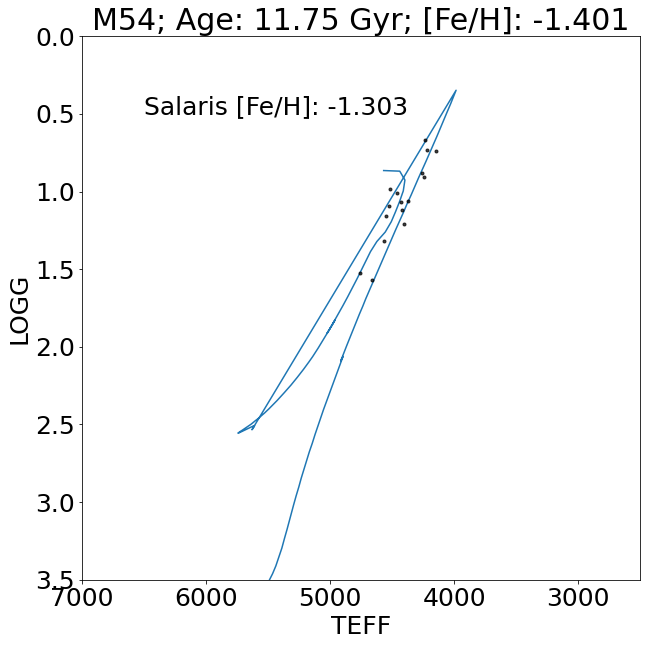

10.11394


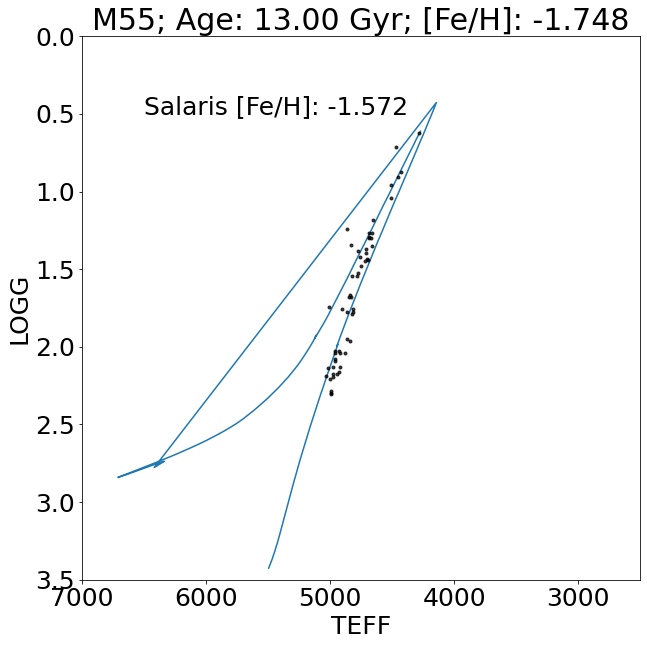

10.04139


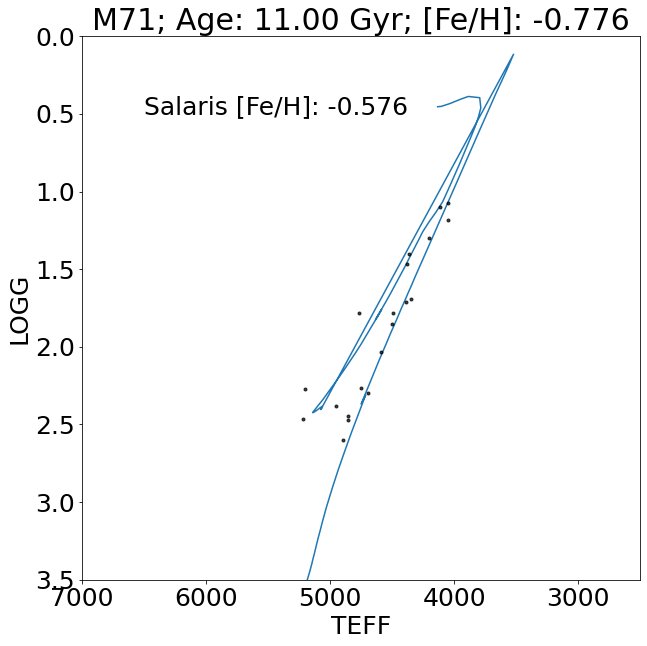

10.04727


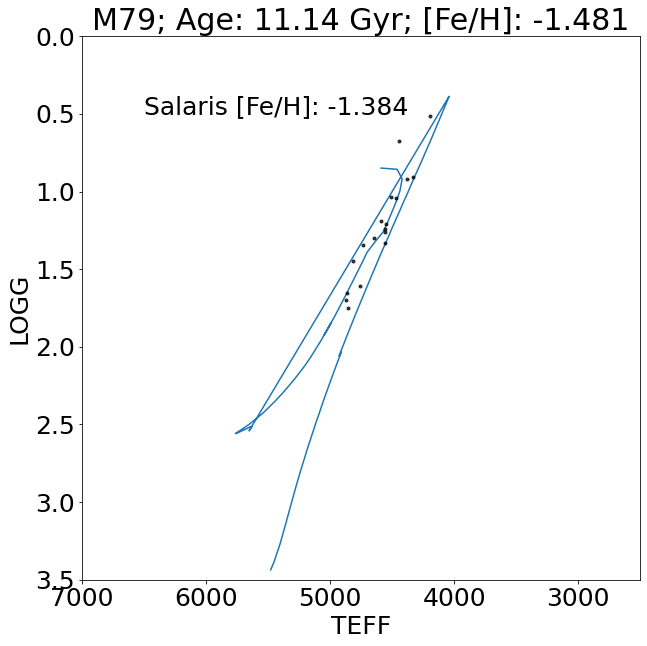

10.04139


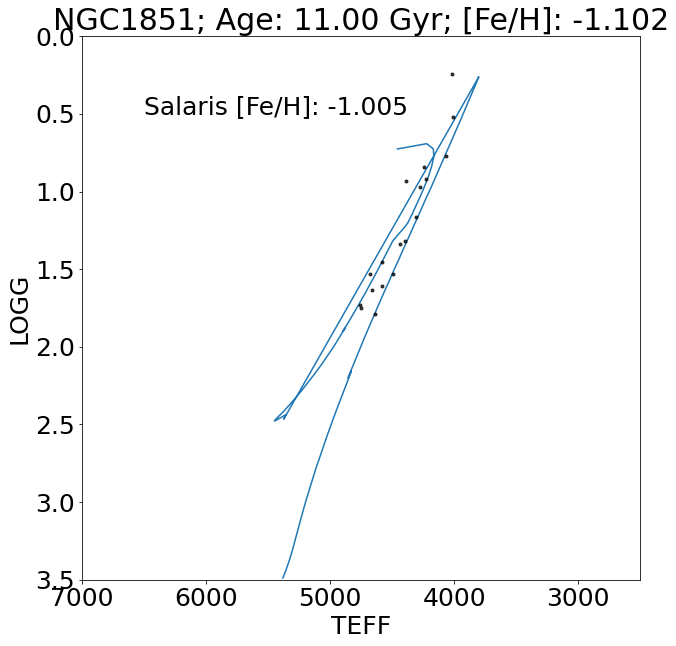

10.04139


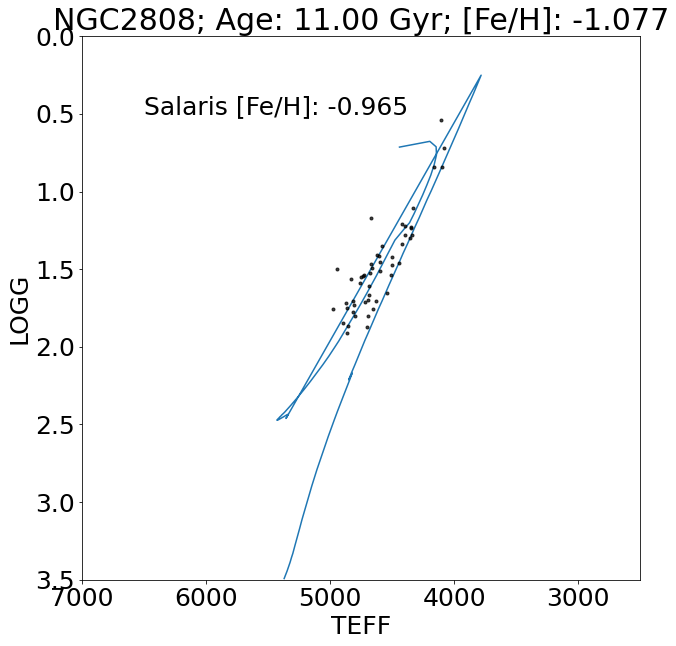

10.0607


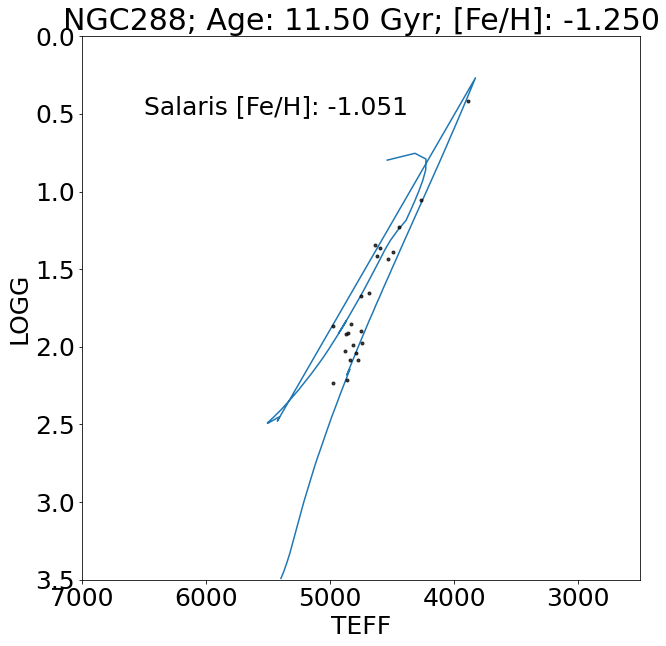

10.031410000000001


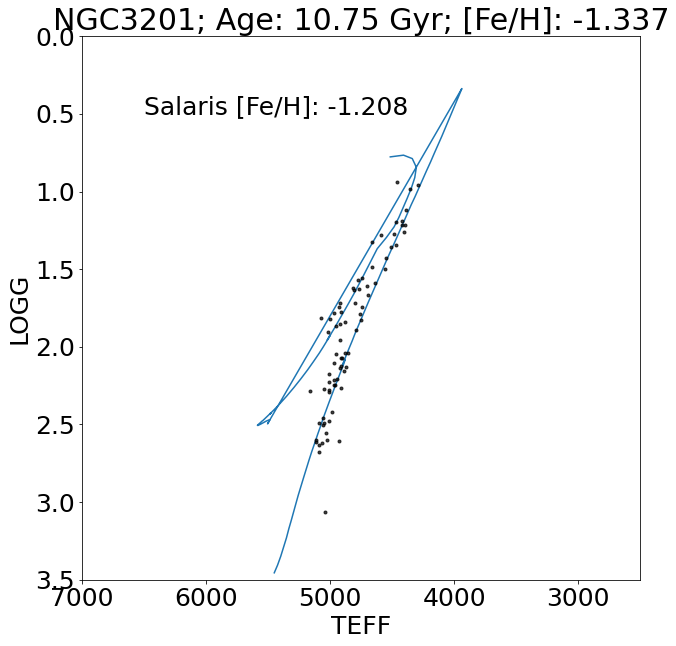

10.08008


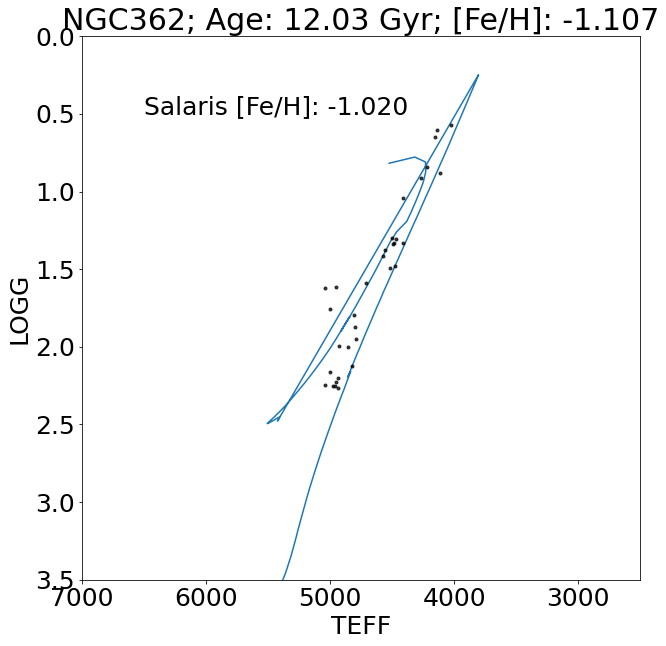

10.11394


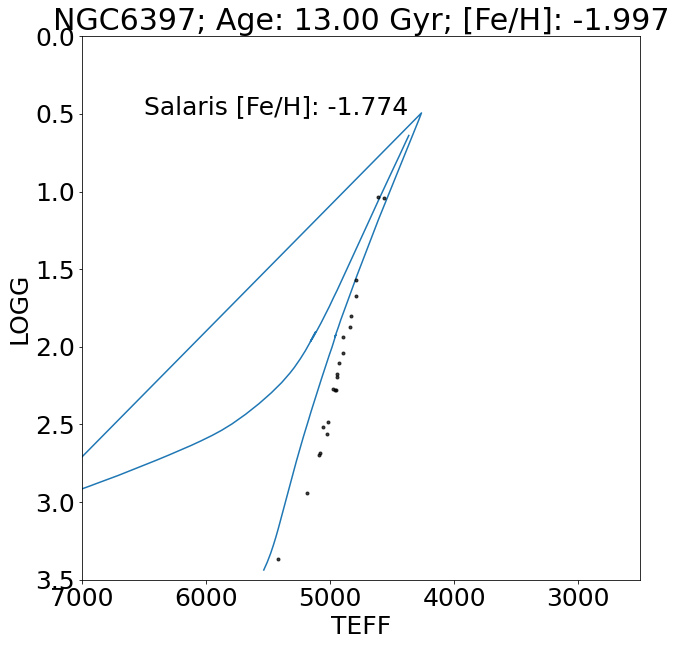

10.096910000000001


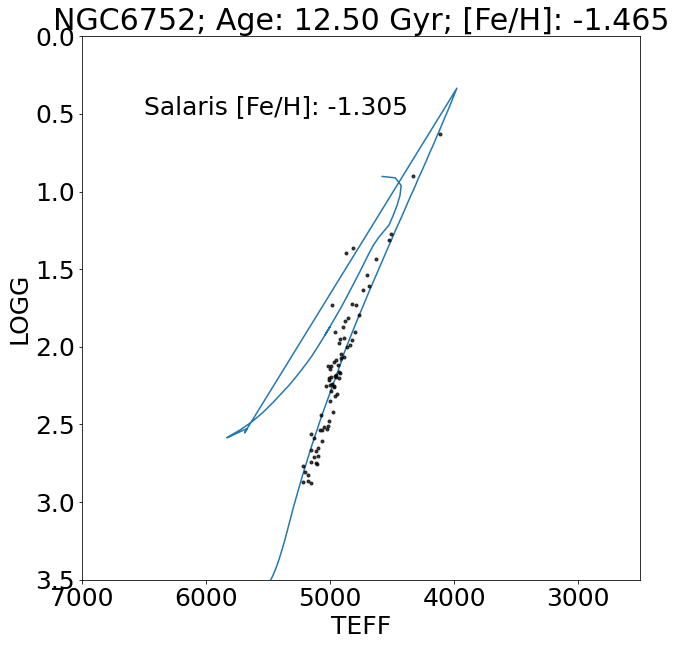

In [187]:
for i in range(len(gcs_clus)):
    clus = np.where(gcs['CLUSTER']==gcs_clus[i])
    isopick = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(gcsdr17['M_H'][clus])+
                                               np.log10(0.638*(10**np.nanmedian(gcsdr17['ALPHA_M'][clus]))+0.362)))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    print(closest(massive['logAge'],np.log10(gcs_ages[i]*10**9)))
    
    plt.figure(figsize=[10,10])
    
#     plt.scatter(10**massive['logTe'][isopick],massive['logg'][isopick],zorder=0,c=massive['label'][isopick],
#                 cmap='nipy_spectral')
#     plt.colorbar()

    plt.plot(10**massive['logTe'][isopick],massive['logg'][isopick],zorder=0)
    plt.text(6500,0.5,r'Salaris [Fe/H]: {:.3f}'.format(np.nanmedian(gcsdr17['M_H'][clus])+
                                                   np.log10(0.638*(10**np.nanmedian(gcsdr17['ALPHA_M'][clus]))+
                                                            0.362)))
    plt.scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    plt.xlabel(r'TEFF')
    plt.ylabel(r'LOGG')
    plt.ylim(0,3.5)
    plt.xlim(2500,7000)
    plt.gca().invert_yaxis()
    plt.gca().invert_xaxis()
    
    plt.title(r'{}; Age: {:.2f} Gyr; [Fe/H]: {:.3f}'.format(gcs_clus[i],gcs_ages[i],
                                                                        np.nanmedian(gcsdr17['FE_H'][clus])))
    plt.savefig('{}SalarisFullsHRDR17.pdf'.format(gcs_clus[i]),bbox_inches='tight')
    plt.show()

In [91]:
#  Mg/Fe vs. Al/Fe

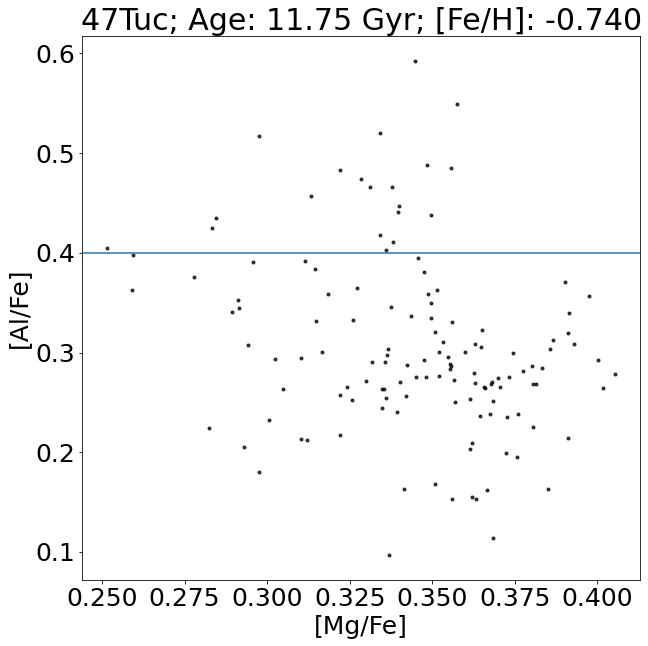

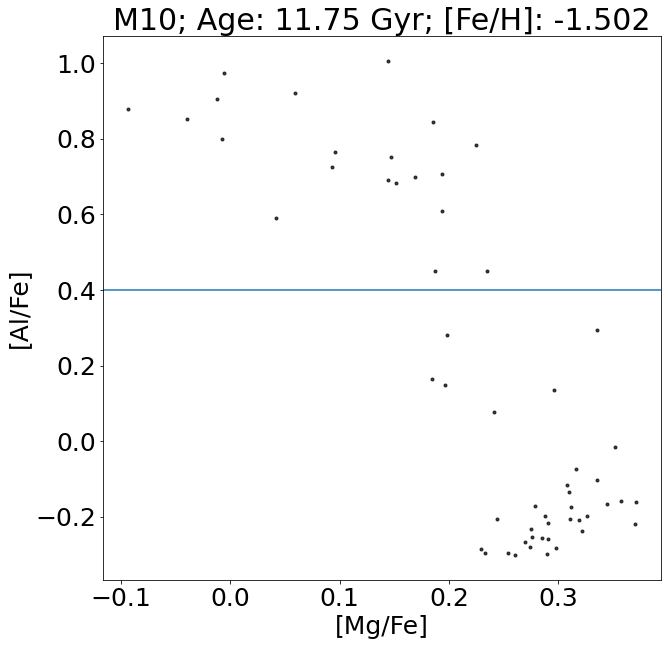

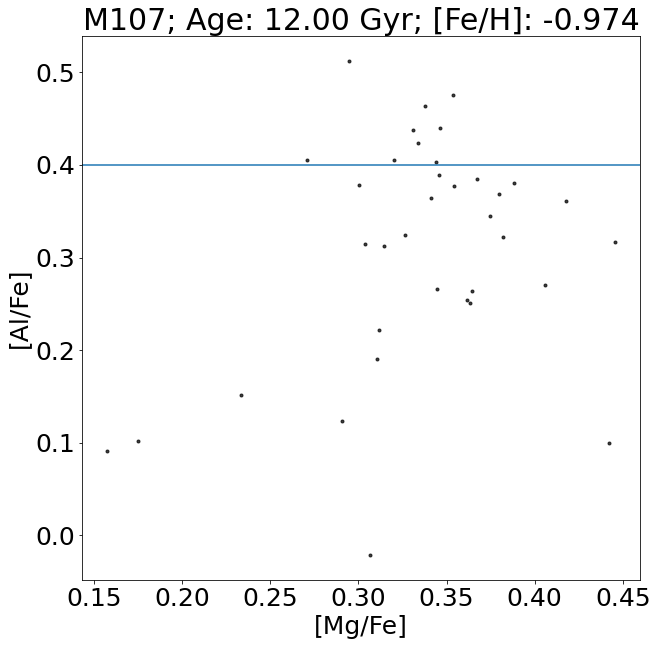

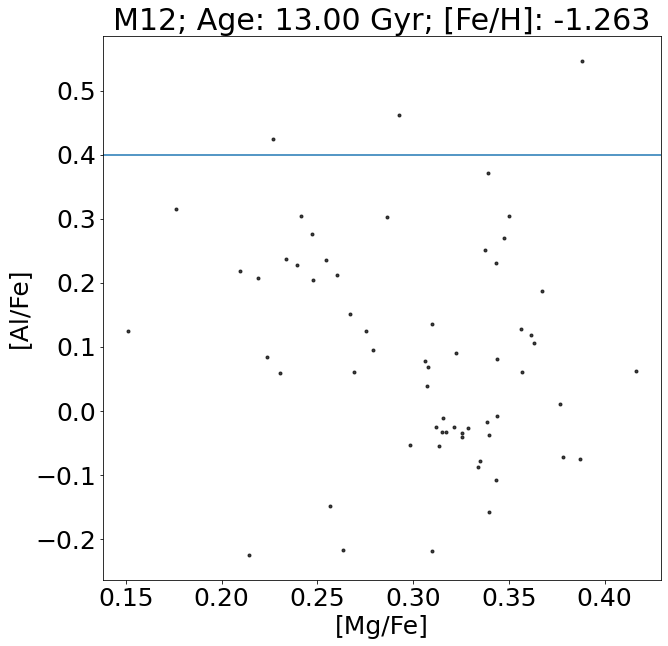

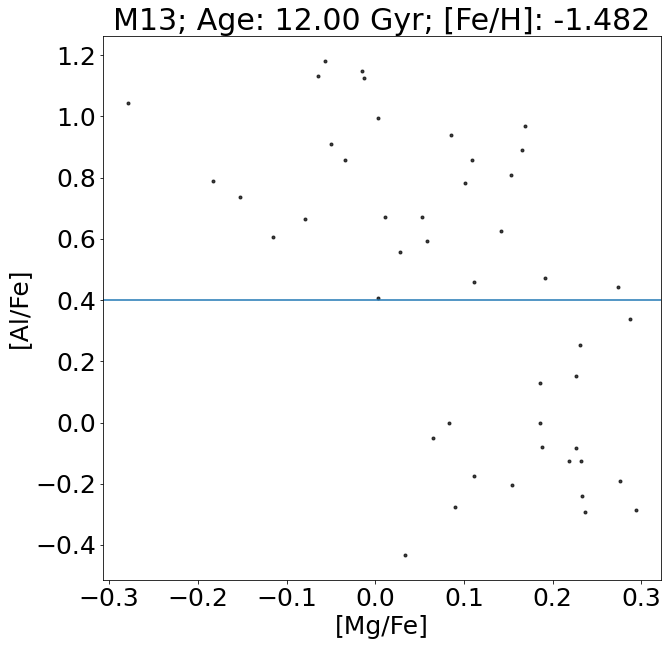

...

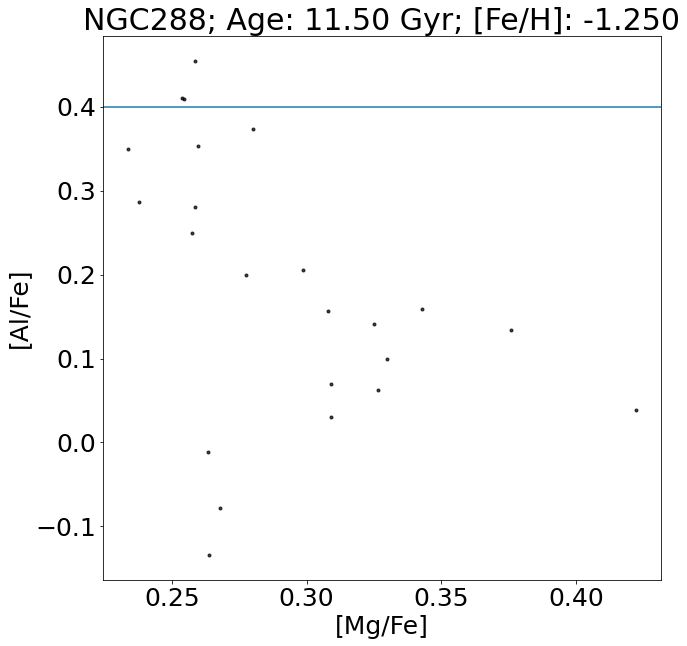

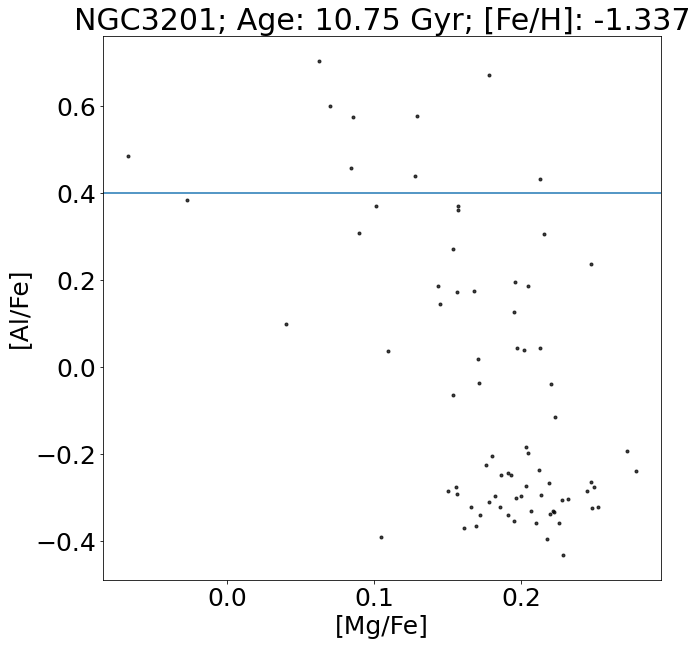

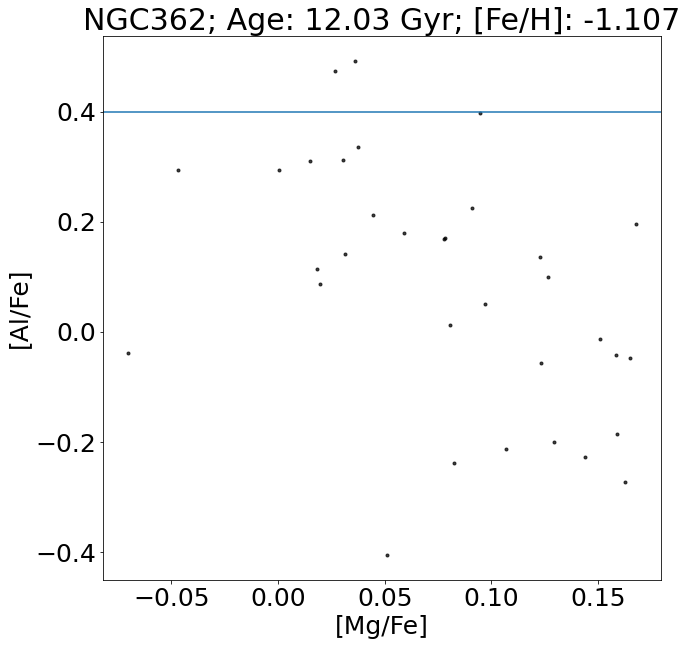

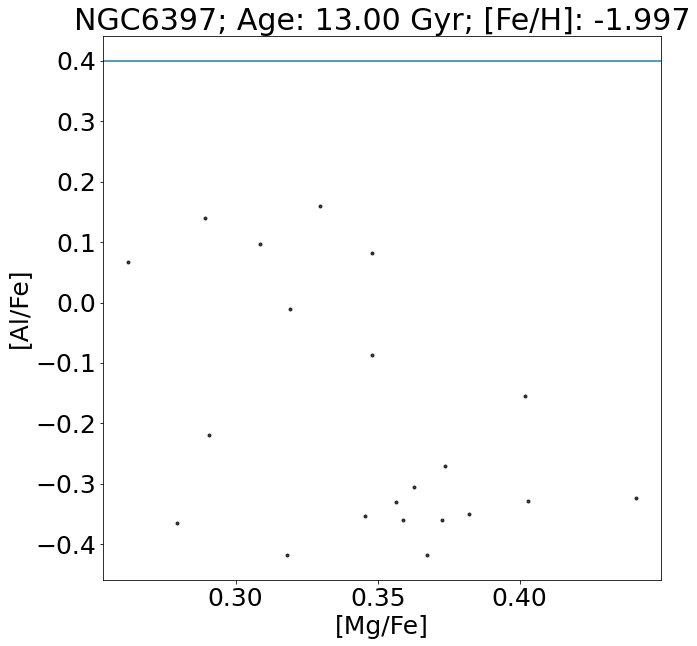

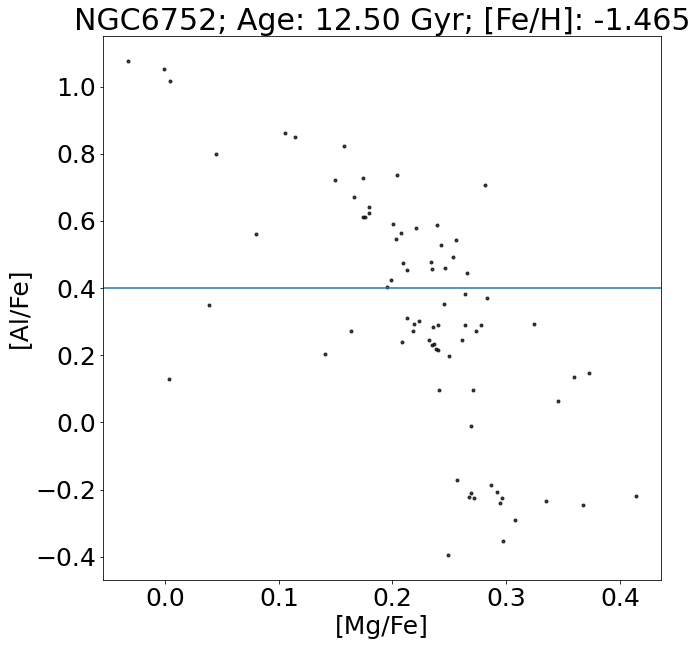

In [189]:
for i in range(len(gcs_clus)):
    clus = np.where(gcs['CLUSTER']==gcs_clus[i])
    
    plt.figure(figsize=[10,10])
    plt.scatter(gcsdr17['MG_FE'][clus],gcsdr17['AL_FE'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    plt.axhline(0.4)
    
    plt.xlabel(r'[Mg/Fe]')
    plt.ylabel(r'[Al/Fe]')
    
    plt.title(r'{}; Age: {:.2f} Gyr; [Fe/H]: {:.3f}'.format(gcs_clus[i],gcs_ages[i],
                                                                        np.nanmedian(gcsdr17['FE_H'][clus])))
    plt.savefig('{}MgAlDR17.pdf'.format(gcs_clus[i]),bbox_inches='tight')
    plt.show()

In [190]:
### Get Solar Fractions
abd = {'C':8.39,'N':7.78,'O':8.66,'Mg':7.53,'Ca':6.31,'S':7.14,'Si':7.51,'Fe':7.45}
keys = list(abd.keys())

sol_2_H = []
for i in keys:
    sol_2_H.append(abd[i]-12.0)
    
sol_xm  = 10**np.asarray(sol_2_H)/sum(10**np.asarray(sol_2_H))

sal = np.array([])
for i in range(len(gcs)):
    x_C_new = sol_xm[0]*10**(gcsdr17['C_FE'][i]+gcsdr17['FE_H'][i]-gcsdr17['M_H'][i])
    x_N_new = sol_xm[1]*10**(gcsdr17['N_FE'][i]+gcsdr17['FE_H'][i]-gcsdr17['M_H'][i])
        
    ffac_new = (x_C_new+x_N_new)/sum(sol_xm[0:2])
    
    sal = np.append(sal,gcsdr17['M_H'][i]+np.log10(0.638*ffac_new+0.362))
        
#     mh_new = add_noise(mh,mh_err)
#     am_new = add_noise(am,am_err)

10.070039999999999


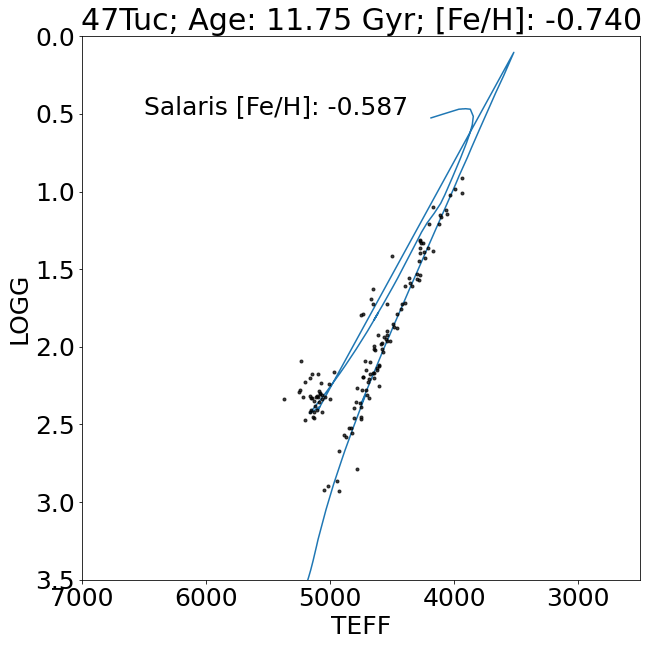

10.070039999999999


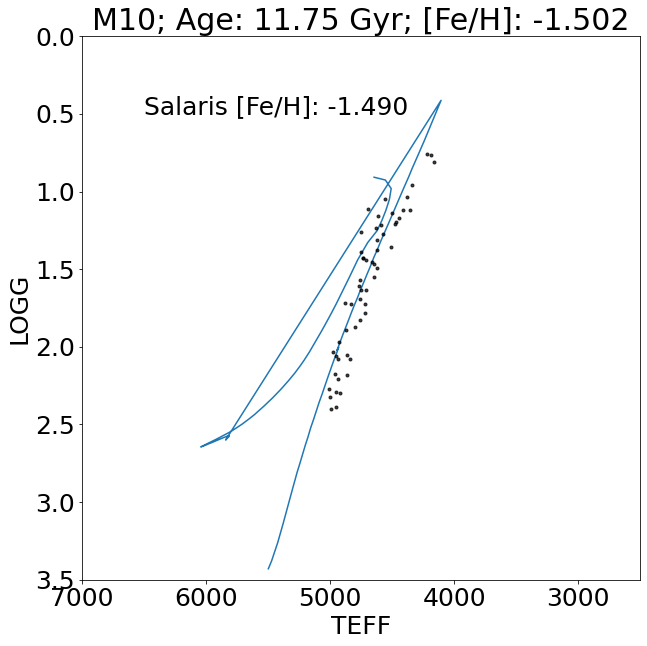

10.079180000000001


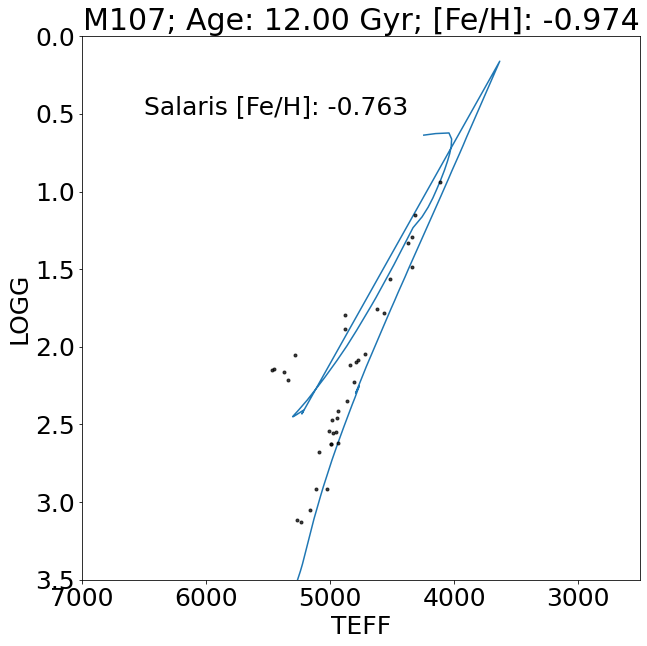

10.11394


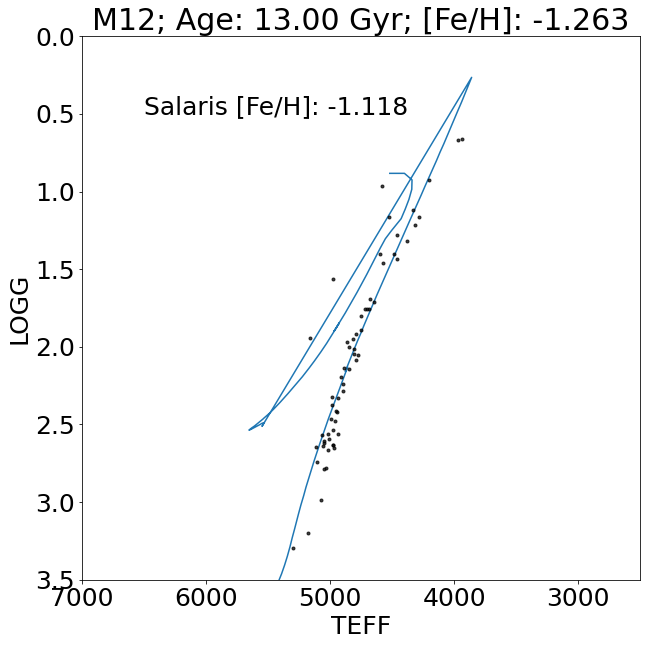

10.079180000000001


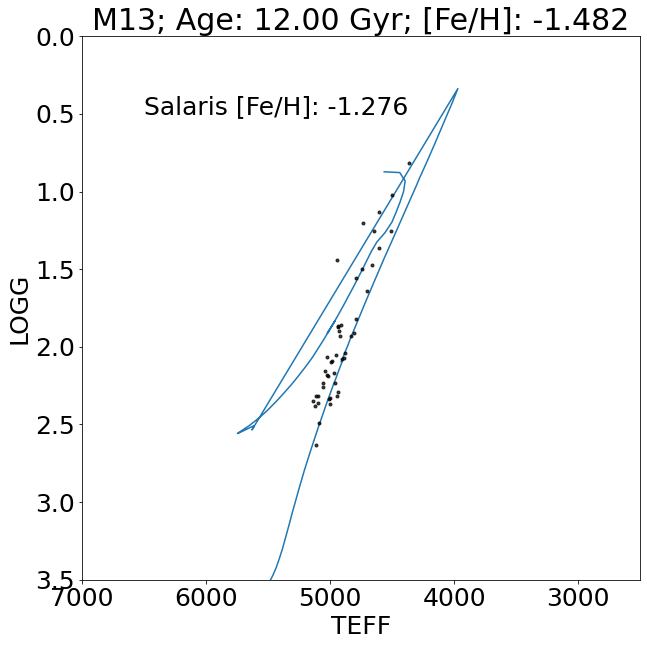

10.079180000000001


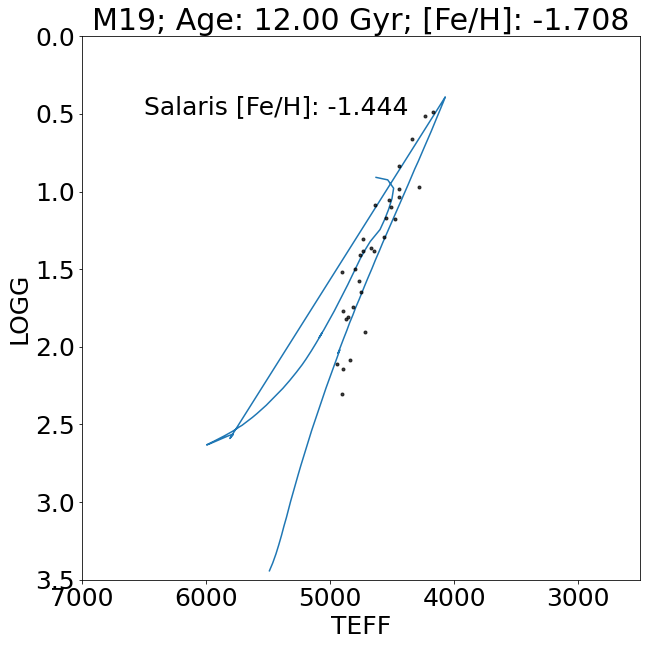

10.070039999999999


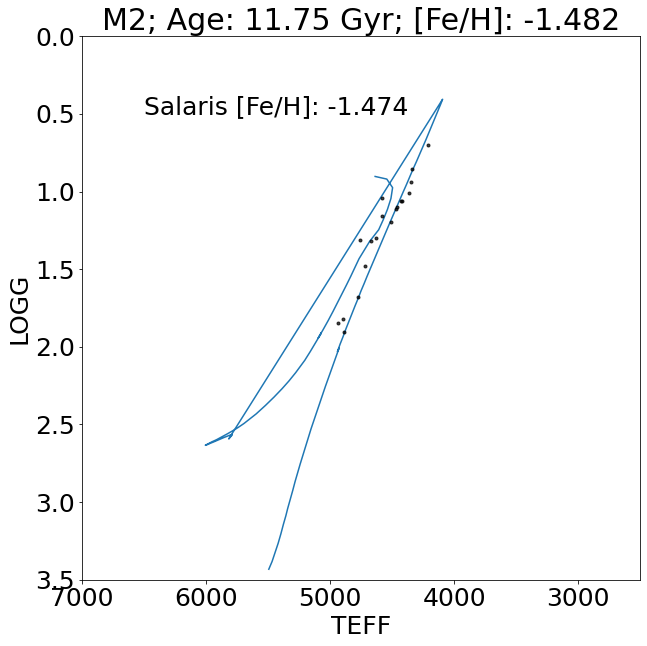

10.096910000000001


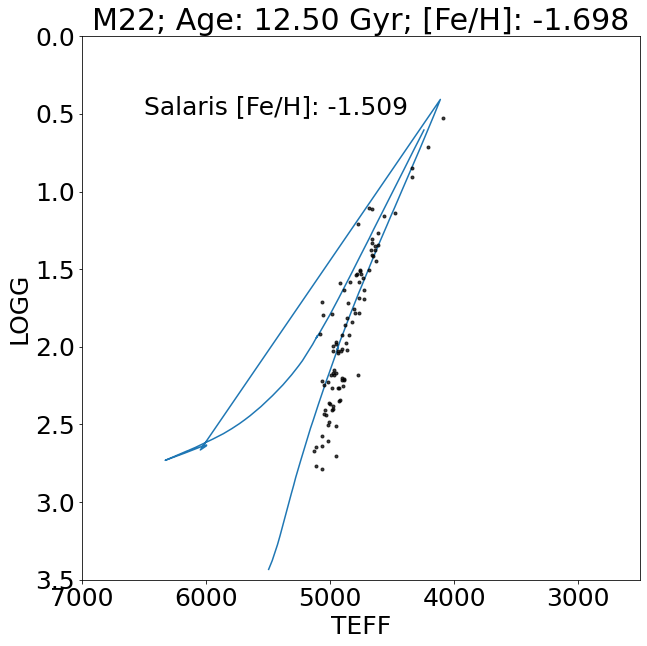

10.070039999999999


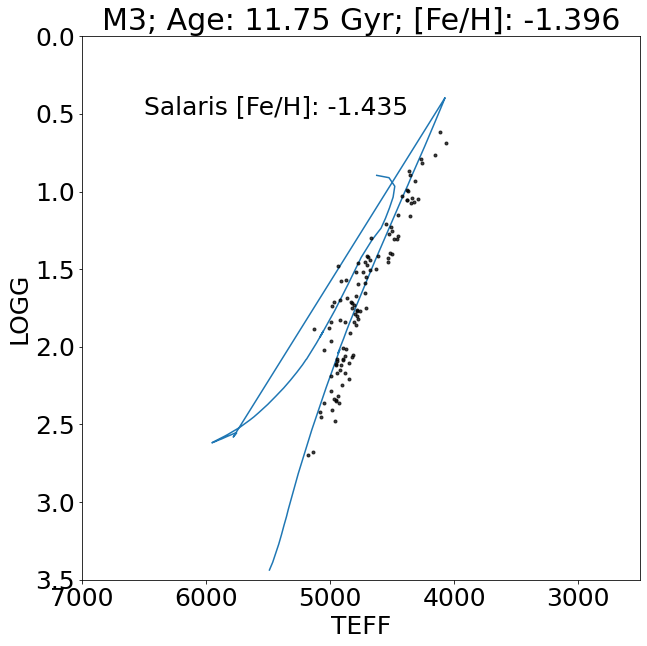

10.0607


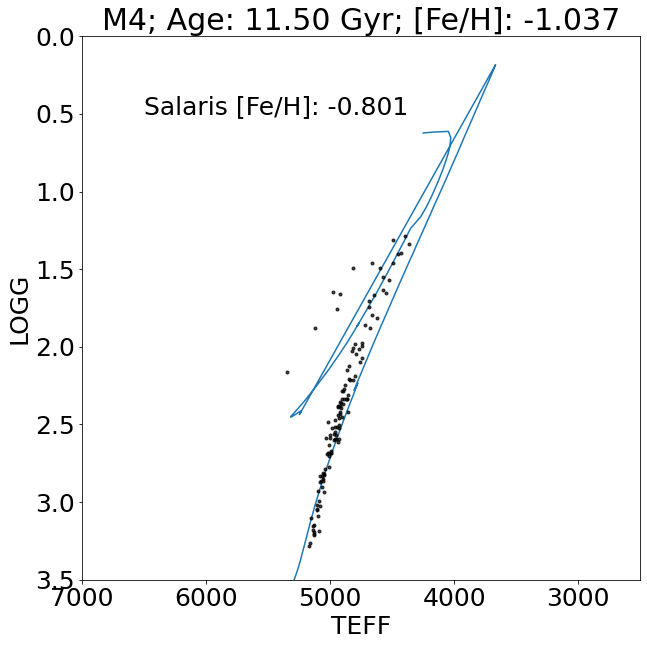

10.0607


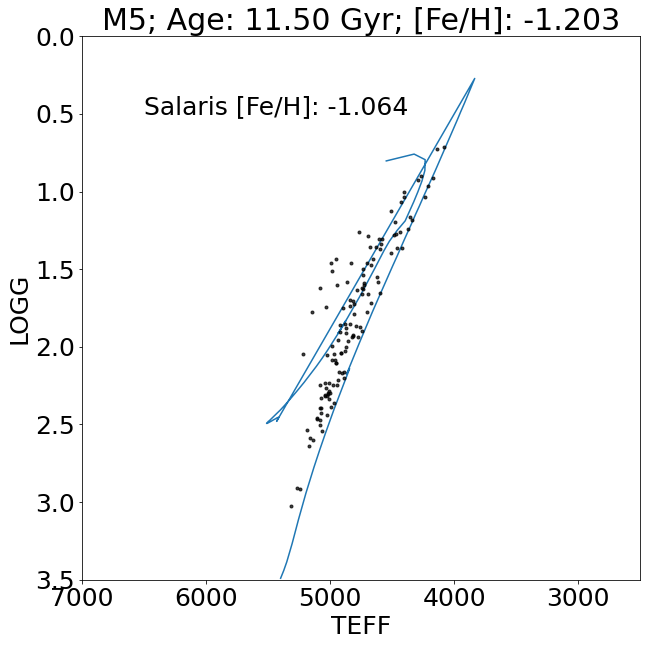

10.08814


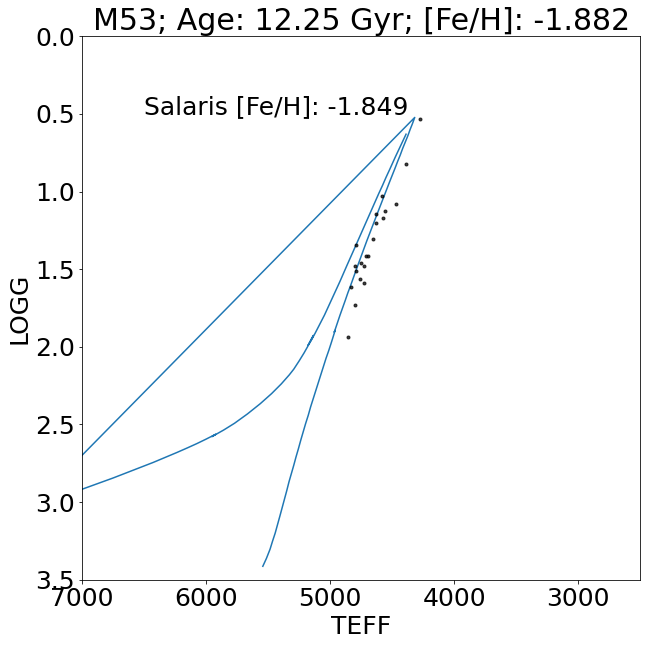

10.070039999999999


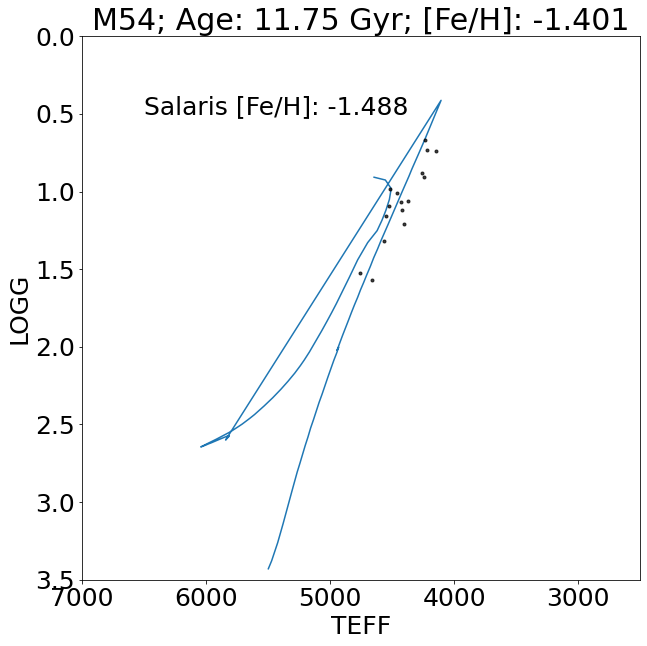

10.11394


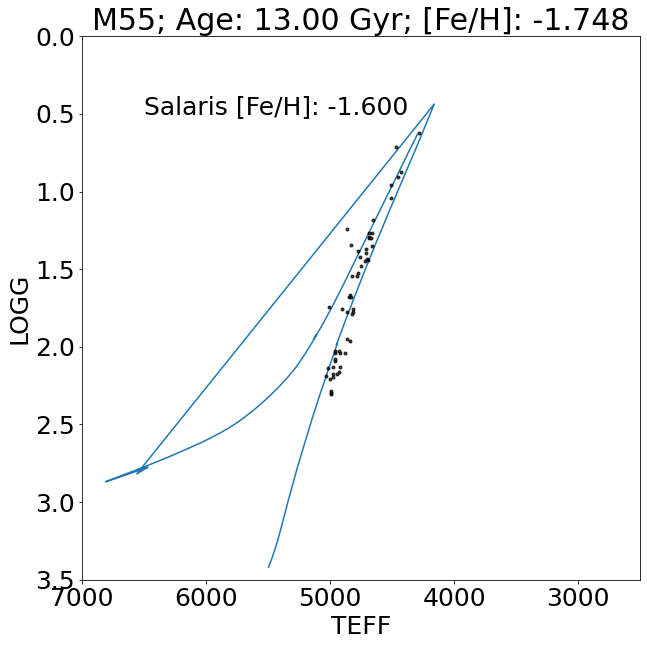

10.04139


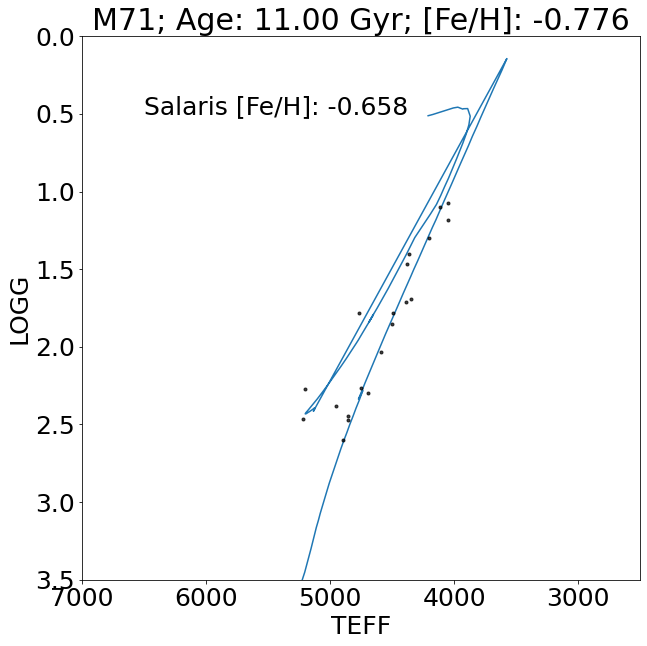

10.04727


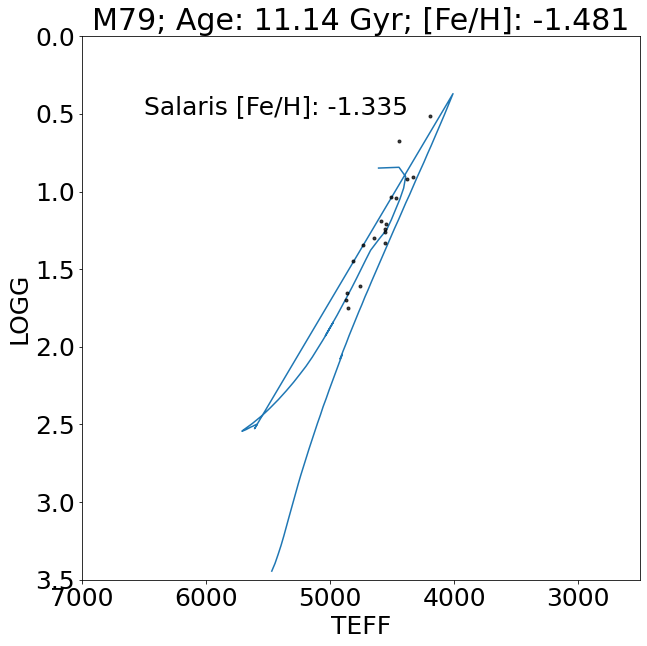

10.04139


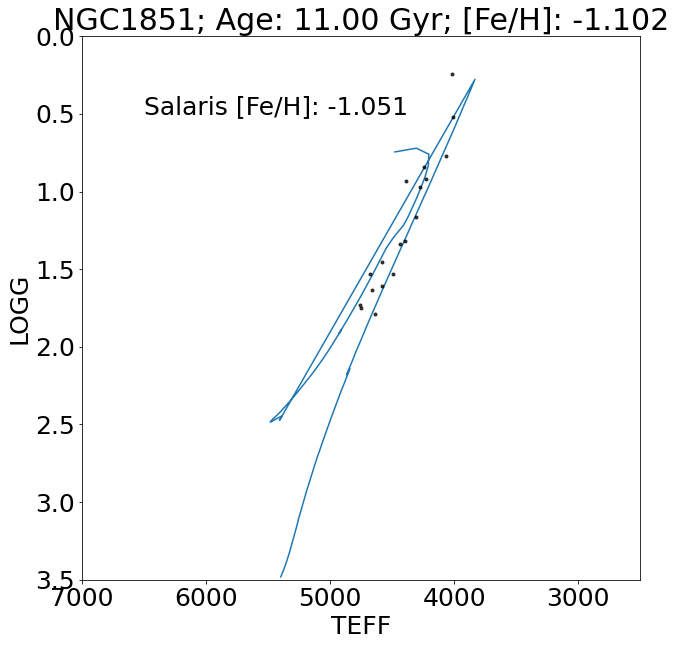

10.04139


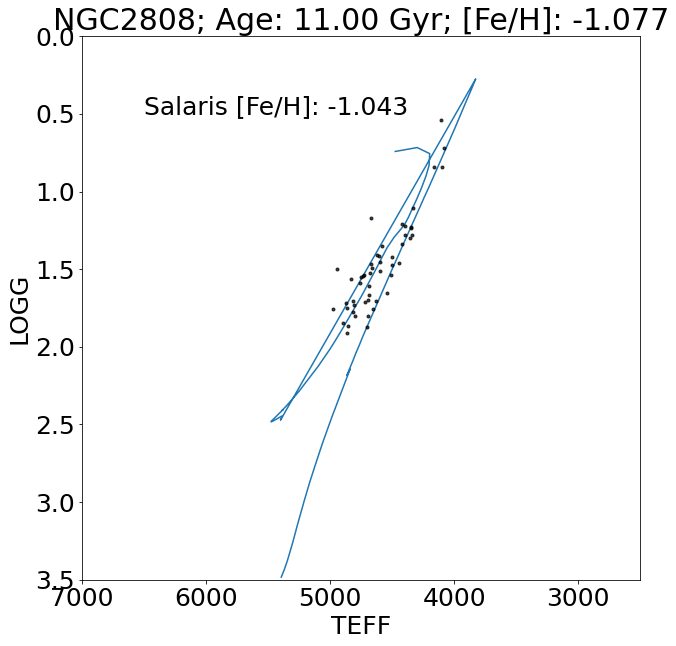

10.0607


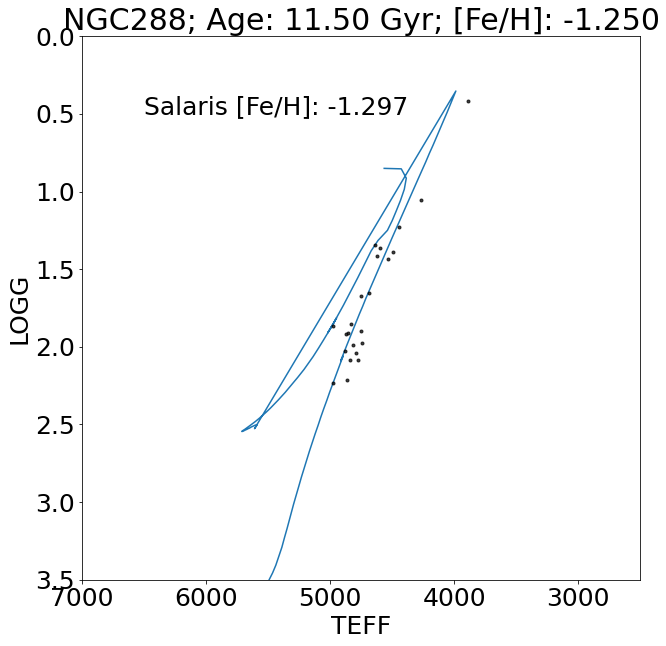

10.031410000000001


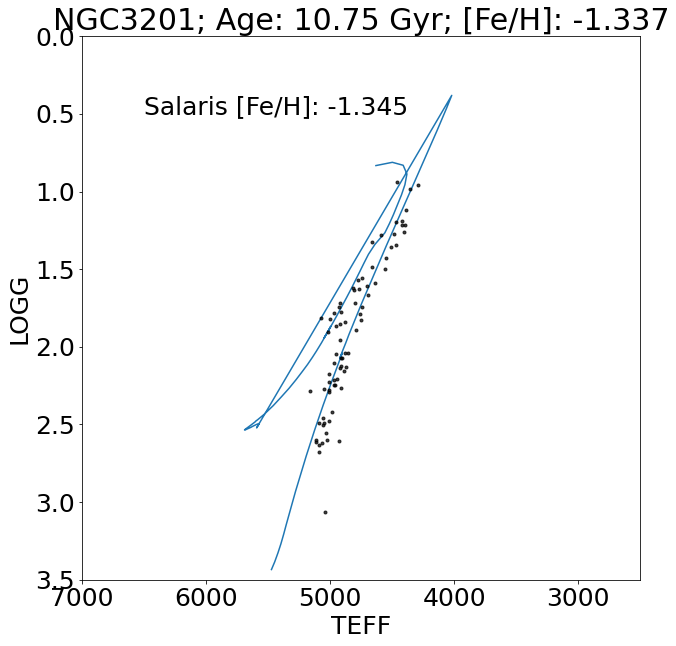

10.08008


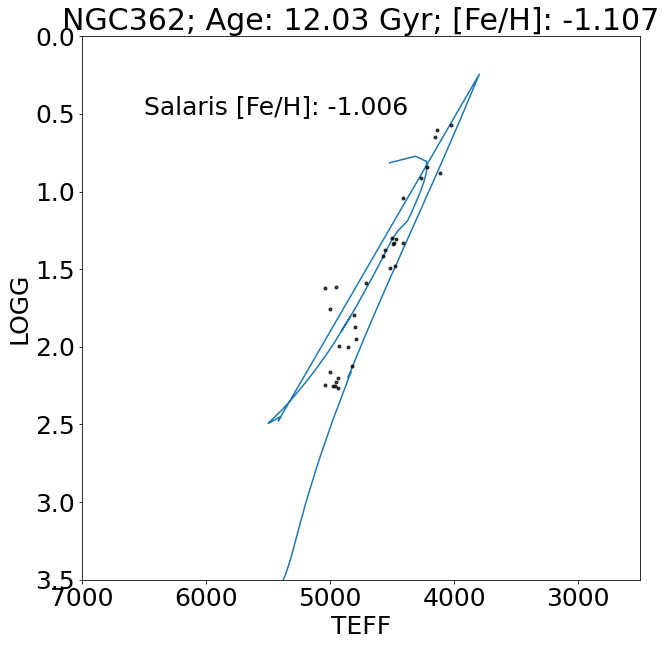

10.11394


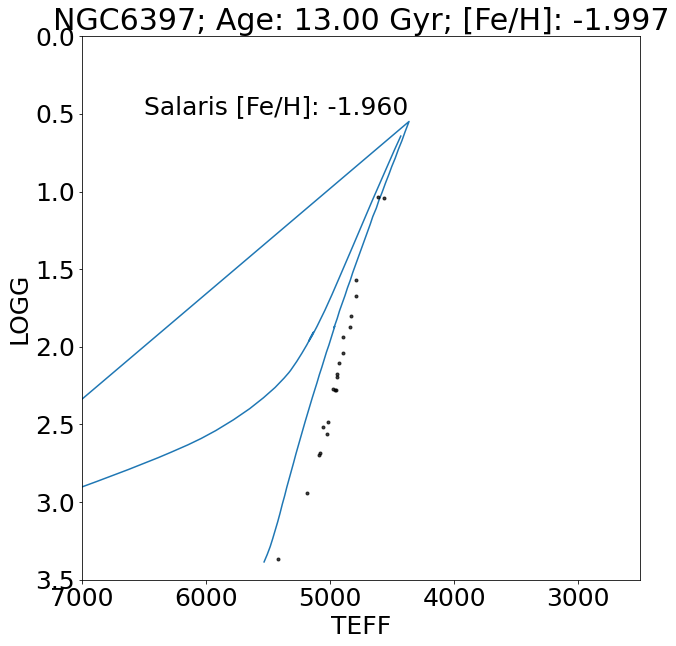

10.096910000000001


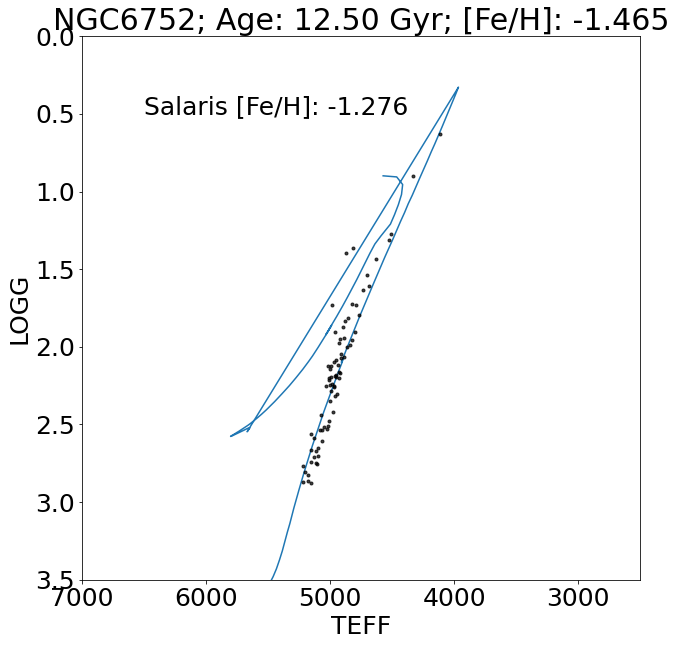

In [191]:
for i in range(len(gcs_clus)):
    clus = np.where(gcs['CLUSTER']==gcs_clus[i])
    isopick = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(sal[clus])))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    print(closest(massive['logAge'],np.log10(gcs_ages[i]*10**9)))
    
    plt.figure(figsize=[10,10])

    plt.plot(10**massive['logTe'][isopick],massive['logg'][isopick],zorder=0)
    plt.text(6500,0.5,r'Salaris [Fe/H]: {:.3f}'.format(np.nanmedian(sal[clus])))
    plt.scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    plt.xlabel(r'TEFF')
    plt.ylabel(r'LOGG')
    plt.ylim(0,3.5)
    plt.xlim(2500,7000)
    plt.gca().invert_yaxis()
    plt.gca().invert_xaxis()
    
    plt.title(r'{}; Age: {:.2f} Gyr; [Fe/H]: {:.3f}'.format(gcs_clus[i],gcs_ages[i],
                                                                        np.nanmedian(gcsdr17['FE_H'][clus])))
    plt.savefig('{}NonSalarisFullsHRDR17.pdf'.format(gcs_clus[i]),bbox_inches='tight')
    plt.show()

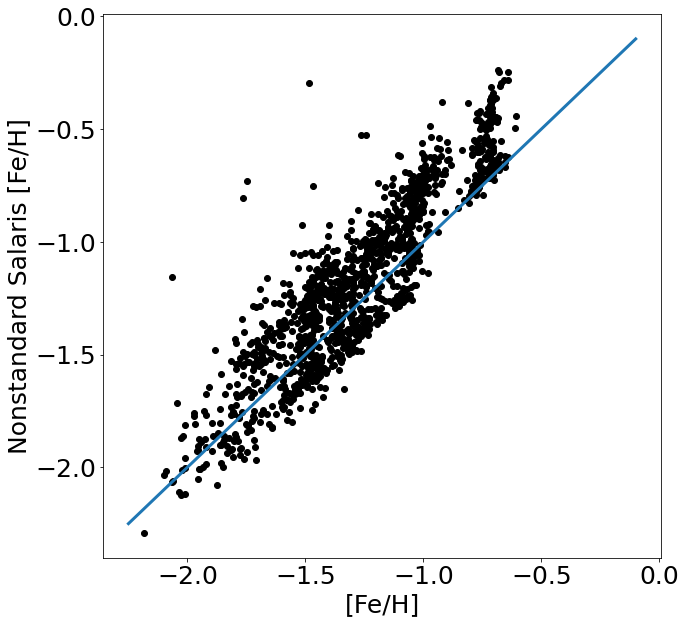

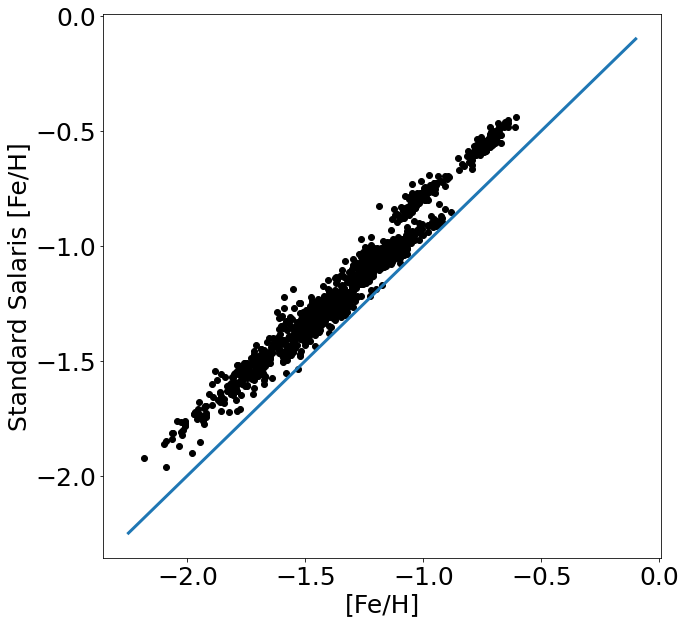

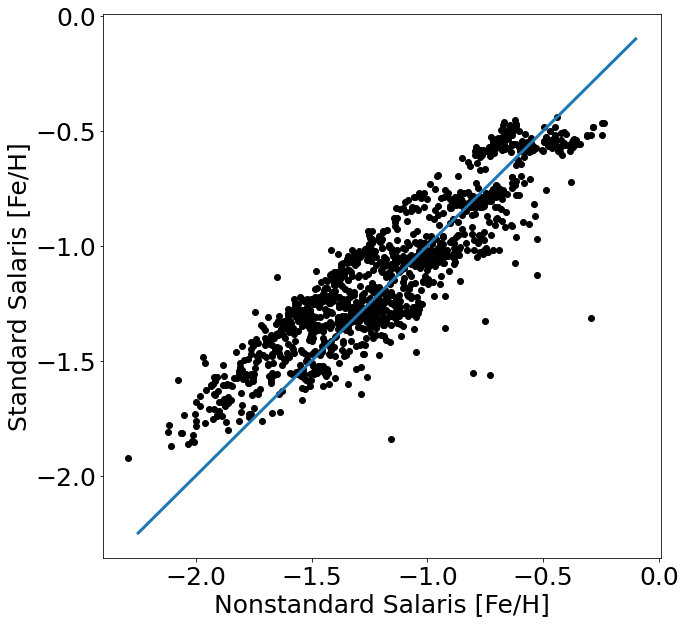

In [192]:
plt.figure(figsize=[10,10])
plt.scatter(gcs['FE_H'],sal,c='k')
plt.plot([-2.25,-0.1],[-2.25,-0.1],lw=3.0)
plt.xlabel(r'[Fe/H]')
plt.ylabel(r'Nonstandard Salaris [Fe/H]')
plt.savefig('NonstandardSalDR17.pdf',bbox_inches='tight')
plt.show()

plt.figure(figsize=[10,10])
plt.scatter(gcs['FE_H'],gcs['M_H']+np.log10(0.638*(10**gcs['ALPHA_M'])+0.362),c='k')
plt.plot([-2.25,-0.1],[-2.25,-0.1],lw=3.0)
plt.xlabel(r'[Fe/H]')
plt.ylabel(r'Standard Salaris [Fe/H]')
plt.savefig('StandardSalDR17.pdf',bbox_inches='tight')
plt.show()

plt.figure(figsize=[10,10])
plt.scatter(sal,gcs['M_H']+np.log10(0.638*(10**gcs['ALPHA_M'])+0.362),c='k')
plt.plot([-2.25,-0.1],[-2.25,-0.1],lw=3.0)
plt.xlabel(r'Nonstandard Salaris [Fe/H]')
plt.ylabel(r'Standard Salaris [Fe/H]')
plt.savefig('NonstandardSal_w_StandardSalDR17.pdf',bbox_inches='tight')
plt.show()

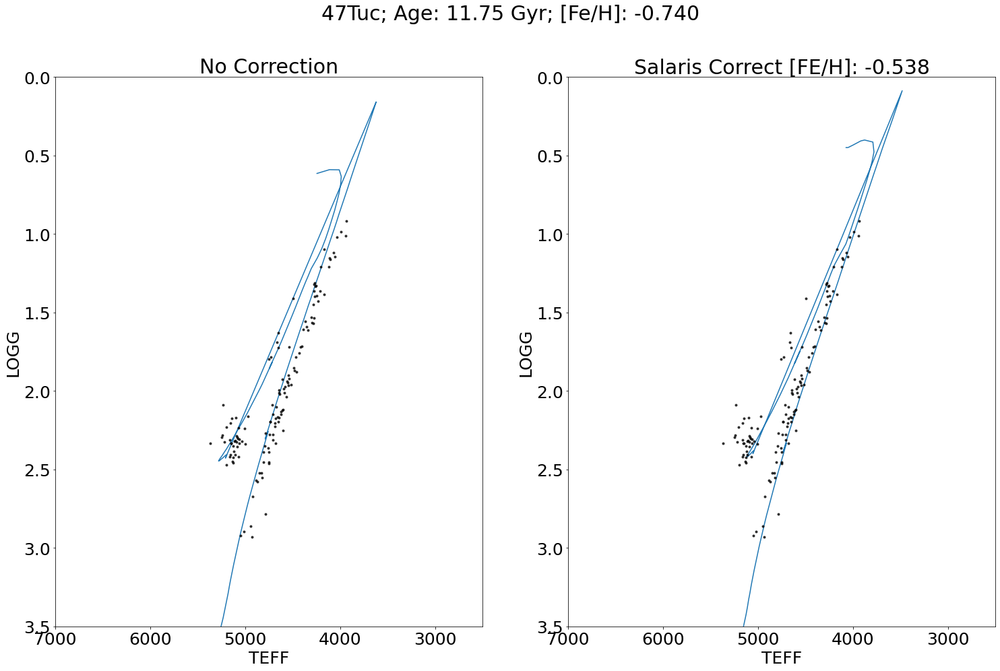

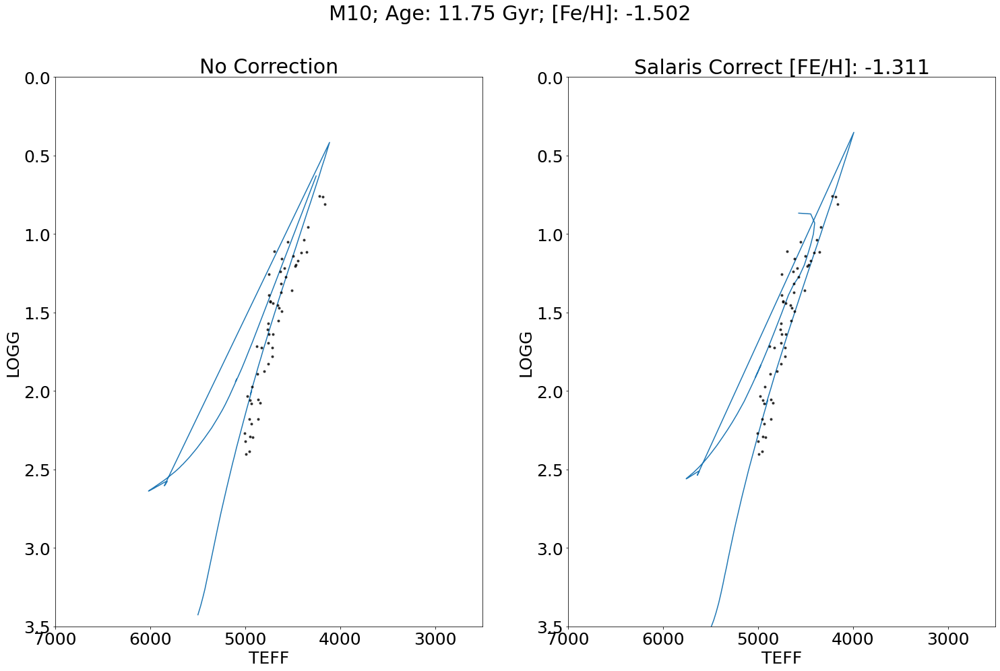

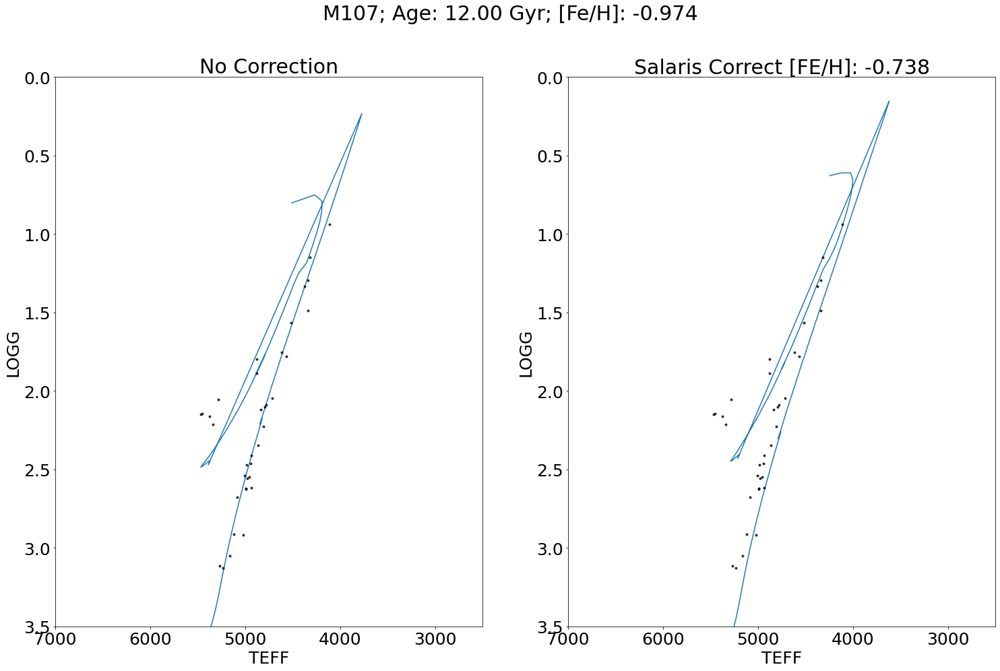

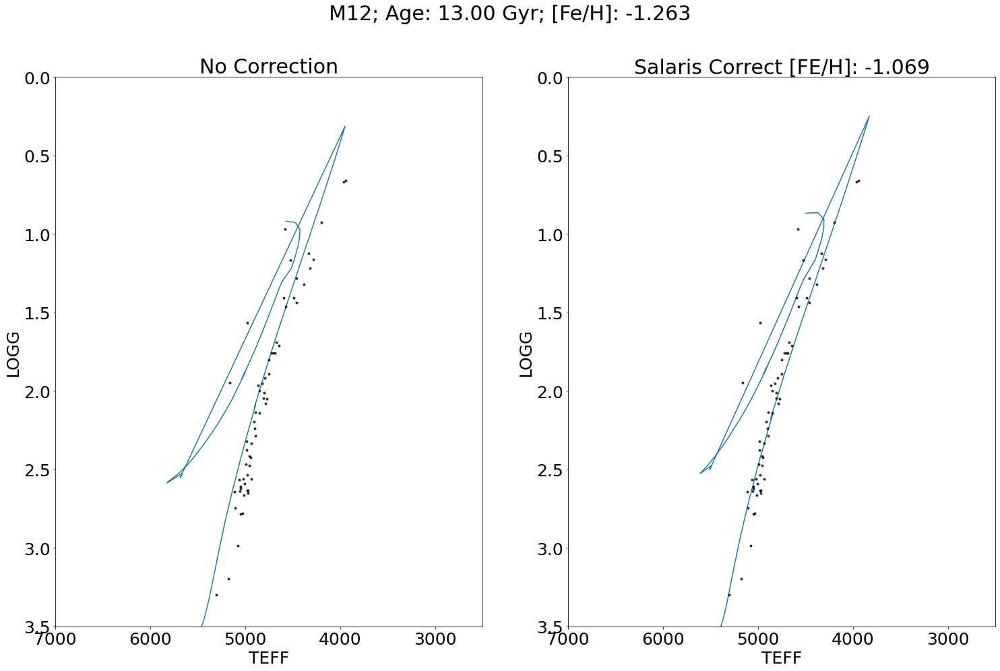

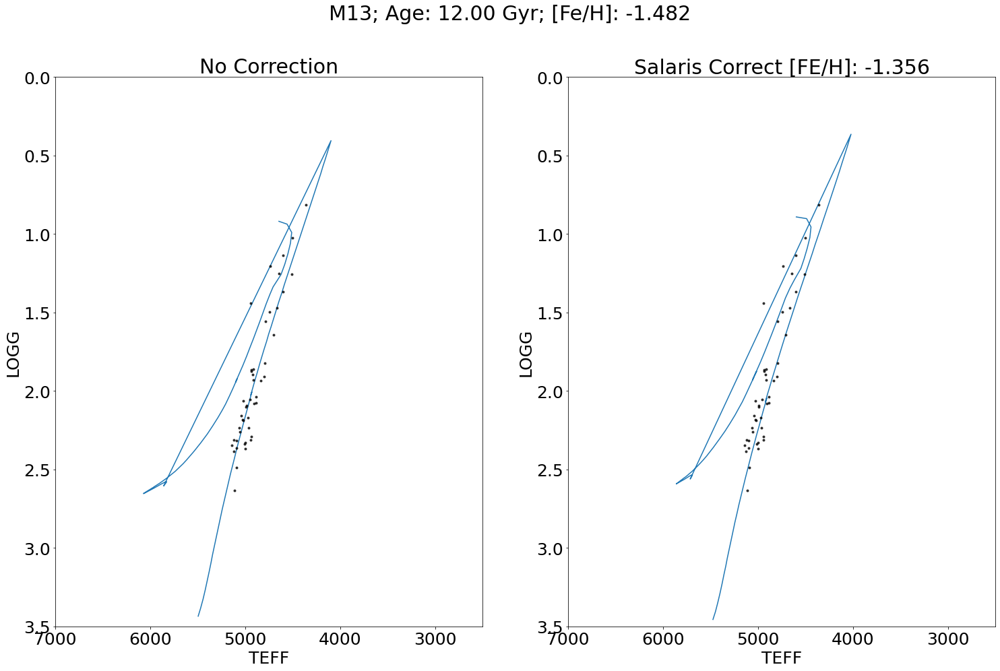

...

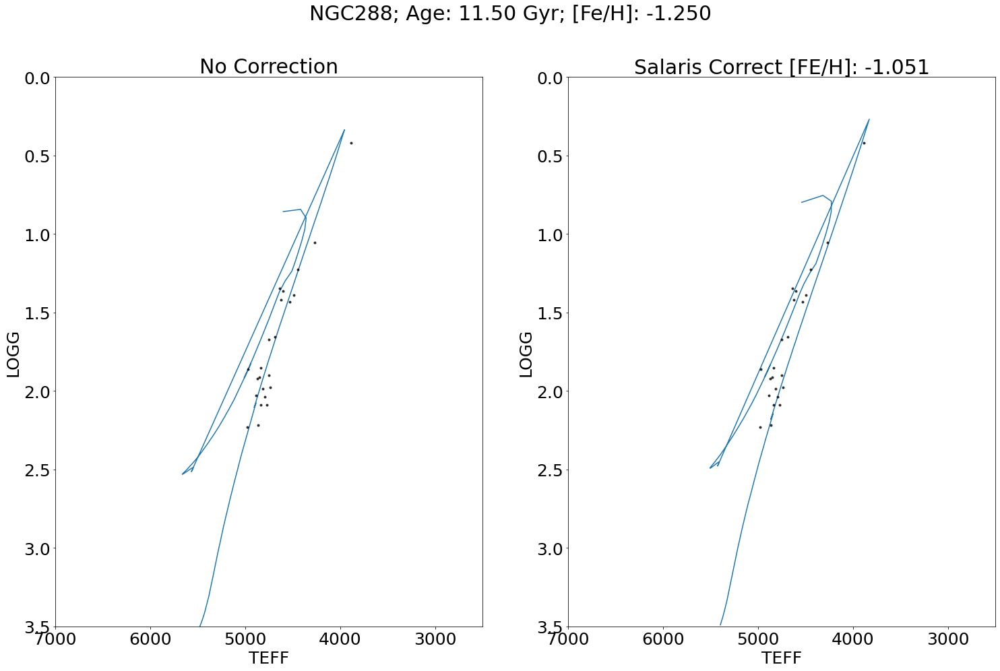

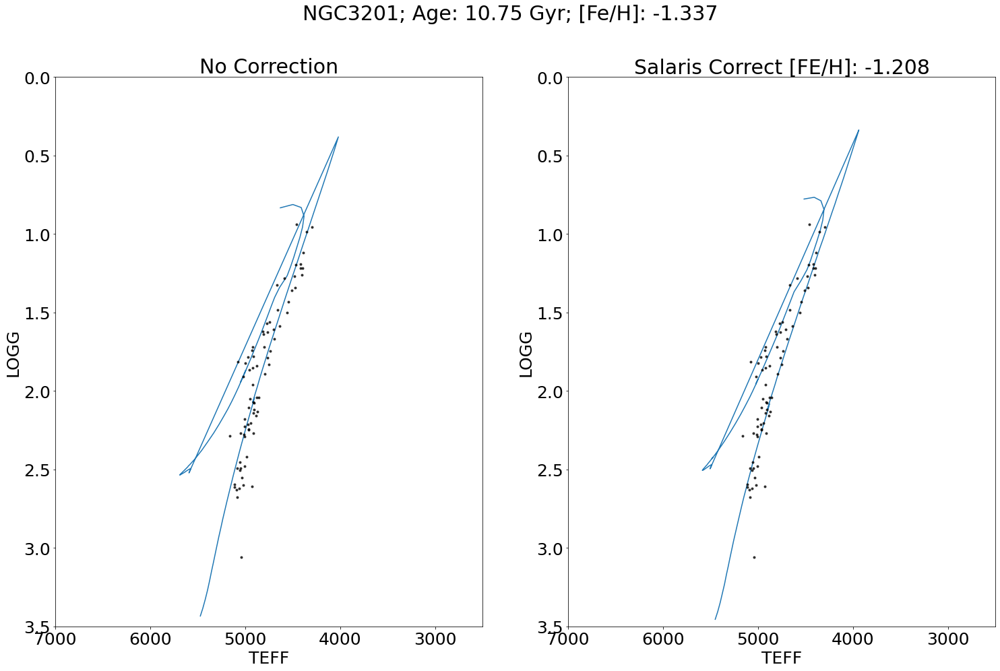

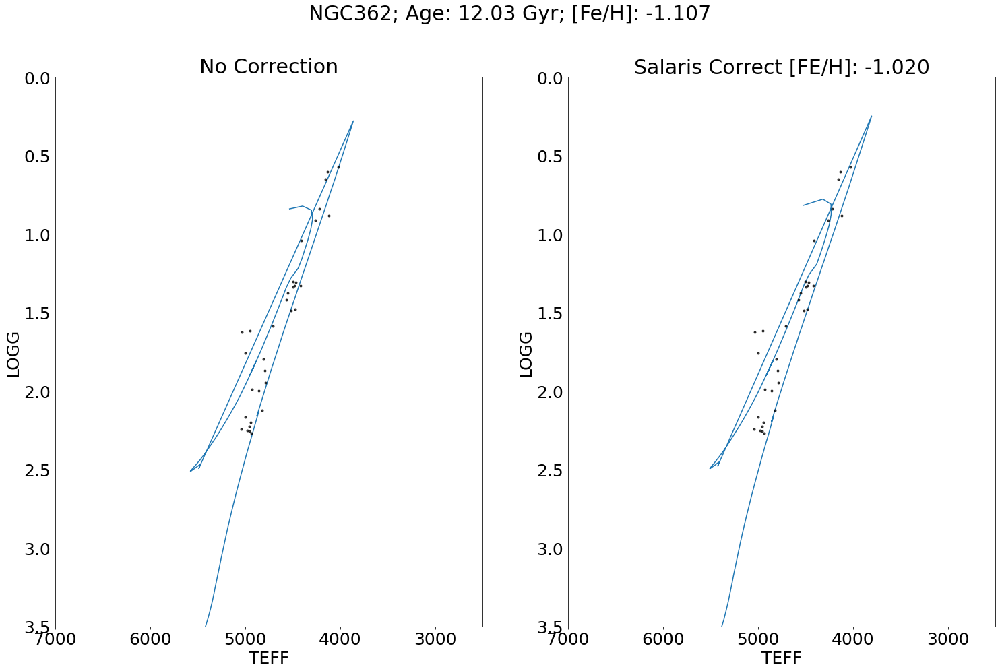

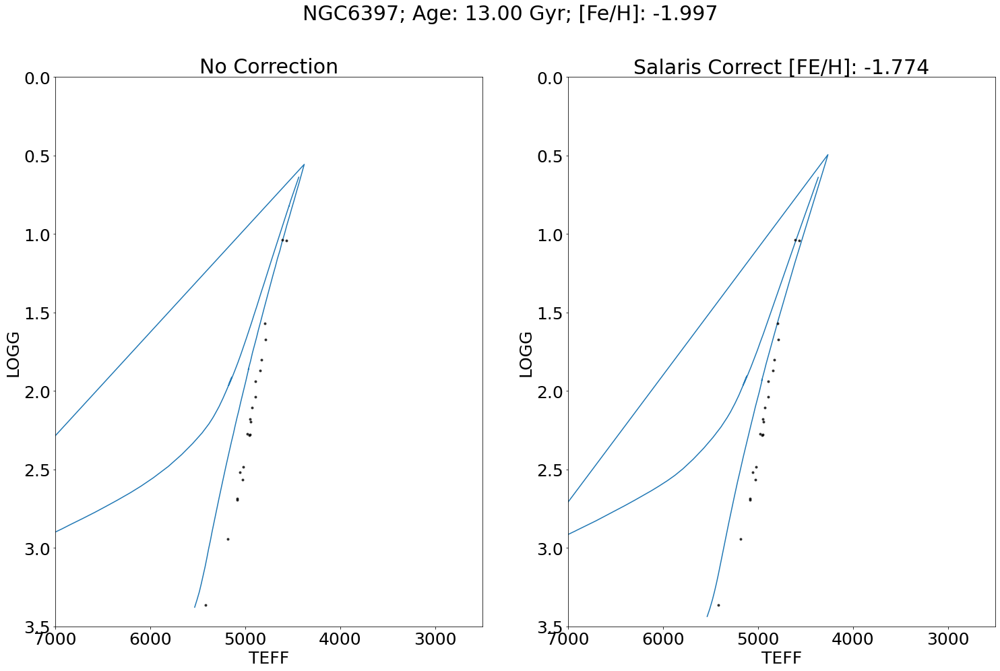

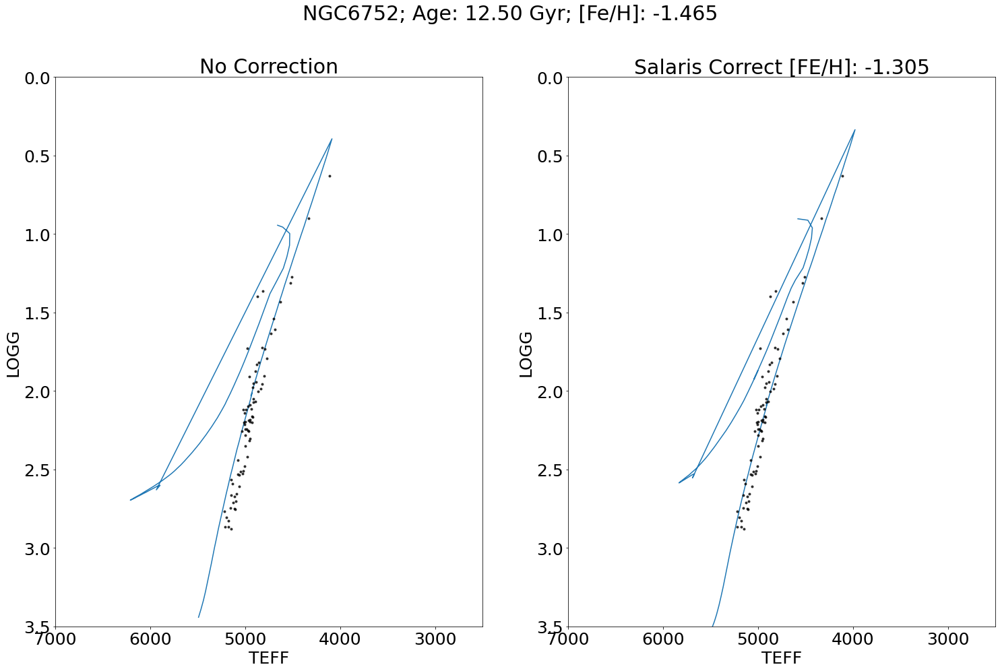

In [193]:
for i in range(len(gcs_clus)):
    clus = np.where(gcs['CLUSTER']==gcs_clus[i])
    isopick1 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(gcsdr17['FE_H'][clus])))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    isopick2 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(gcsdr17['M_H'][clus])+
                                               np.log10(0.638*(10**np.nanmedian(gcsdr17['ALPHA_M'][clus]))+0.362)))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    fig, ax = plt.subplots(1,2,figsize=[25,15])

    ax[0].plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],zorder=0)
#     ax[0].text(6500,0.5,r'Salaris [Fe/H]: {:.3f}'.format(np.nanmedian(gcsdr17['FE_H'][clus])))
    ax[0].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[0].set_xlabel(r'TEFF')
    ax[0].set_ylabel(r'LOGG')
    ax[0].set_ylim(0,3.5)
    ax[0].set_xlim(2500,7000)
    ax[0].invert_yaxis()
    ax[0].invert_xaxis()
    ax[0].set_title(r'No Correction')
    
    ax[1].plot(10**massive['logTe'][isopick2],massive['logg'][isopick2],zorder=0)
#     ax[1].text(6500,0.5,r'Salaris [Fe/H]: {:.3f}'.format(np.nanmedian(gcsdr17['M_H'][clus])+
#                                                          np.log10(0.638*(10**np.nanmedian(gcsdr17['ALPHA_M'][clus]))+
#                                                                   0.362)))
    ax[1].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[1].set_xlabel(r'TEFF')
    ax[1].set_ylabel(r'LOGG')
    ax[1].set_ylim(0,3.5)
    ax[1].set_xlim(2500,7000)
    ax[1].invert_yaxis()
    ax[1].invert_xaxis()
    ax[1].set_title(r'Salaris Correct [FE/H]: {:.3f}'.format(np.nanmedian(gcsdr17['M_H'][clus])+
                                                         np.log10(0.638*(10**np.nanmedian(gcsdr17['ALPHA_M'][clus]))+
                                                                  0.362)))
    
    plt.suptitle(r'{}; Age: {:.2f} Gyr; [Fe/H]: {:.3f}'.format(gcs_clus[i],gcs_ages[i],
                                                                        np.nanmedian(gcsdr17['FE_H'][clus])))
    plt.savefig('{}SalarisNoSideBySideDR17.pdf'.format(gcs_clus[i]),bbox_inches='tight')
    plt.show()

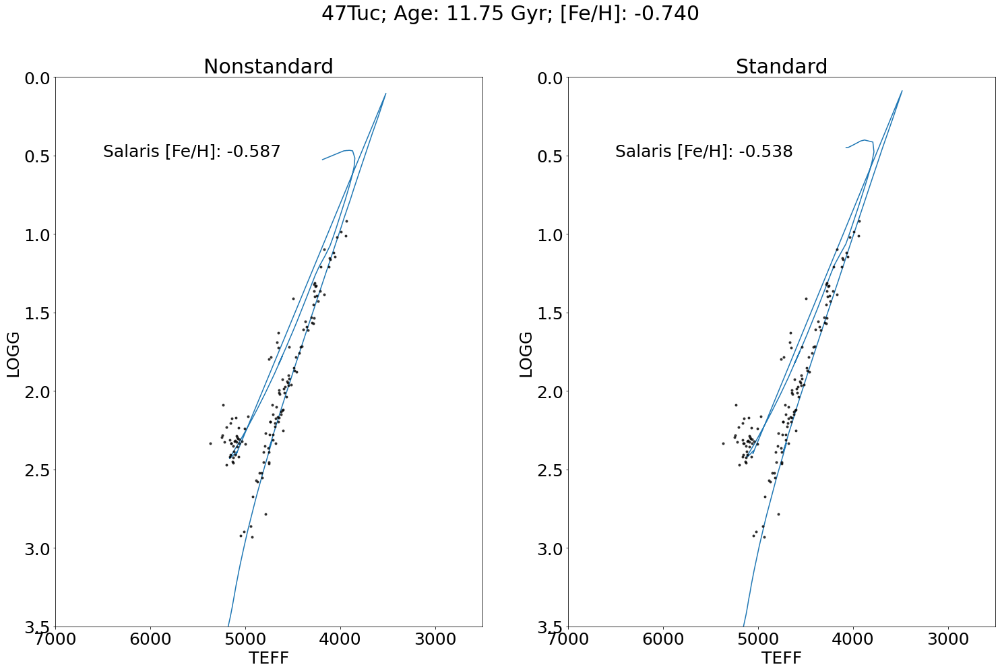

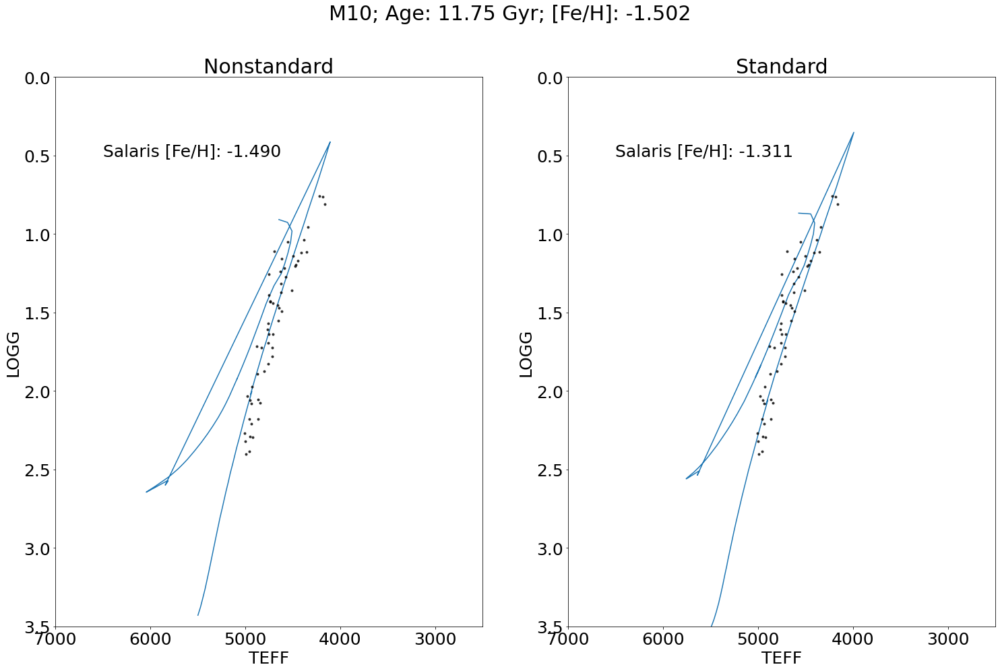

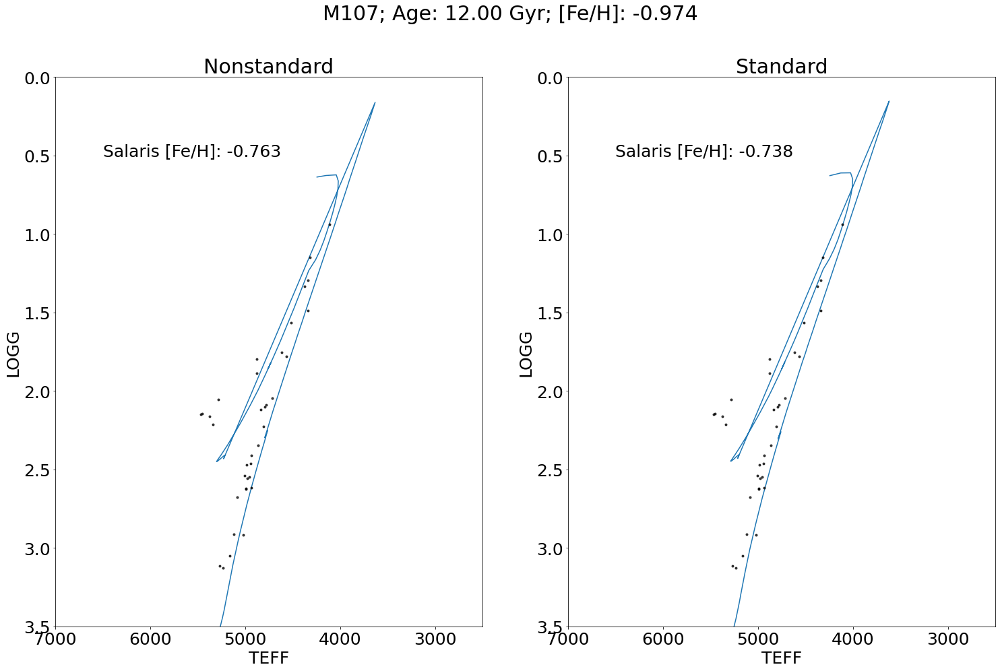

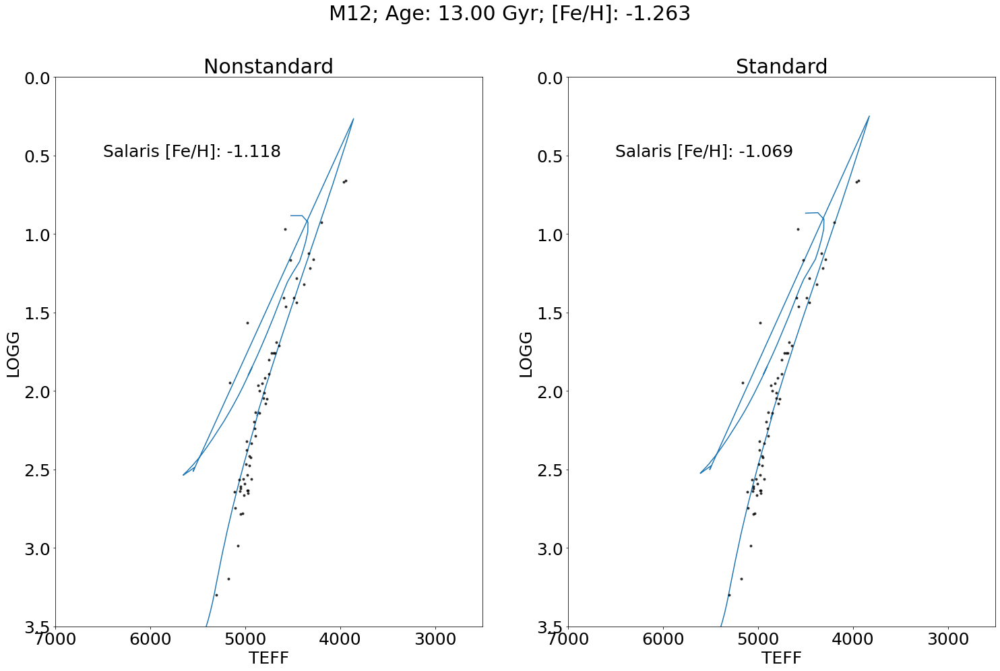

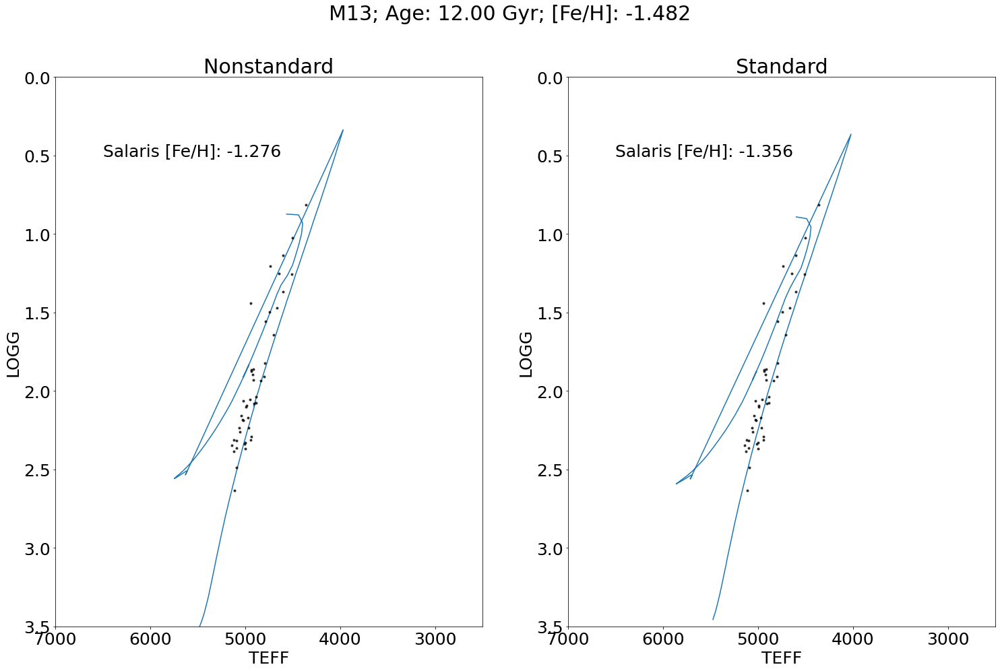

...

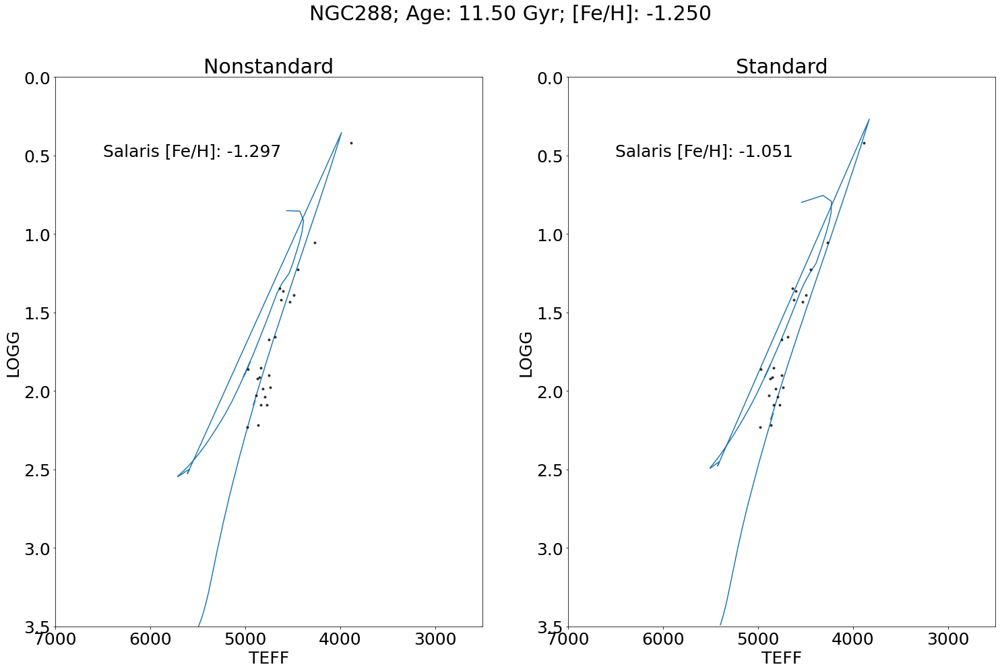

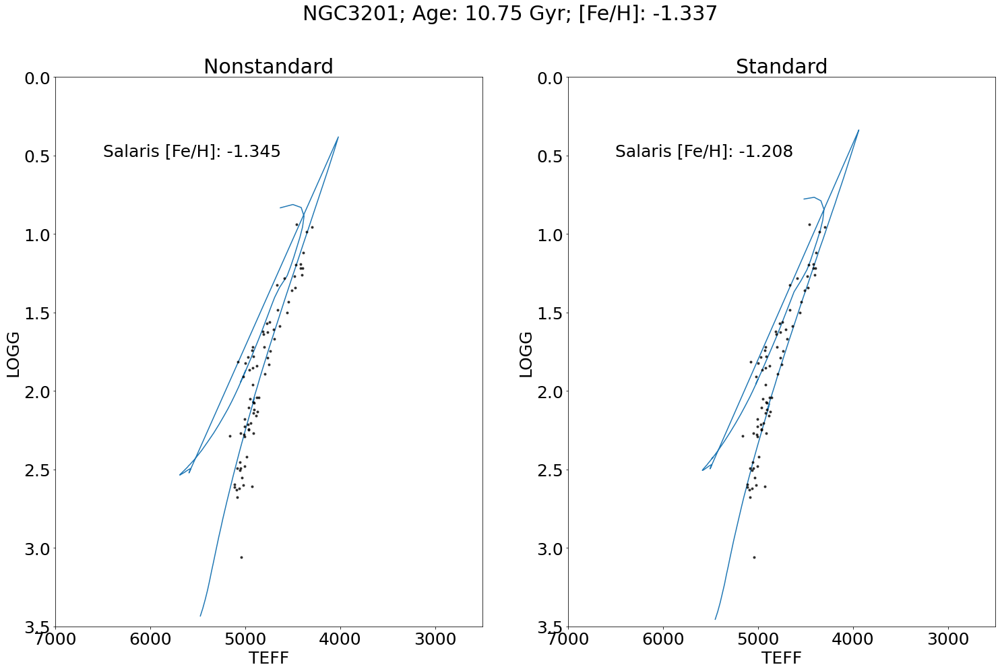

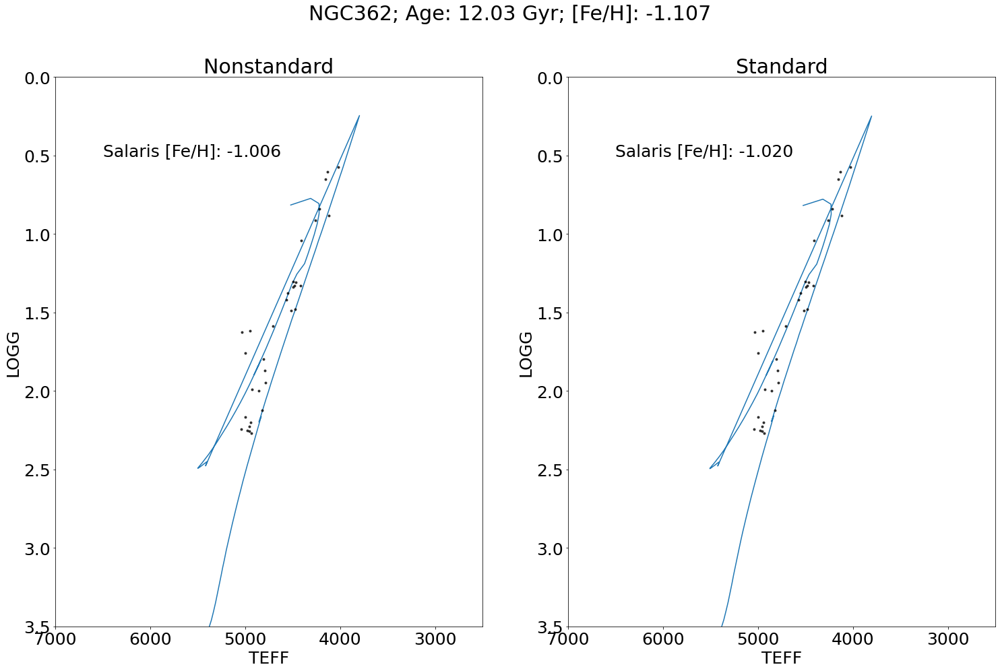

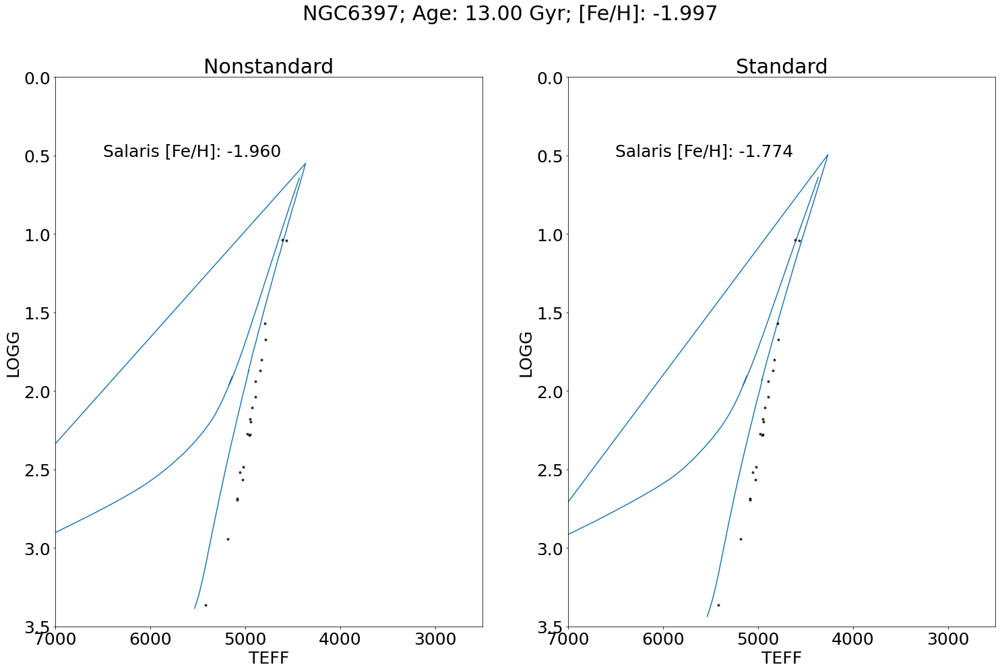

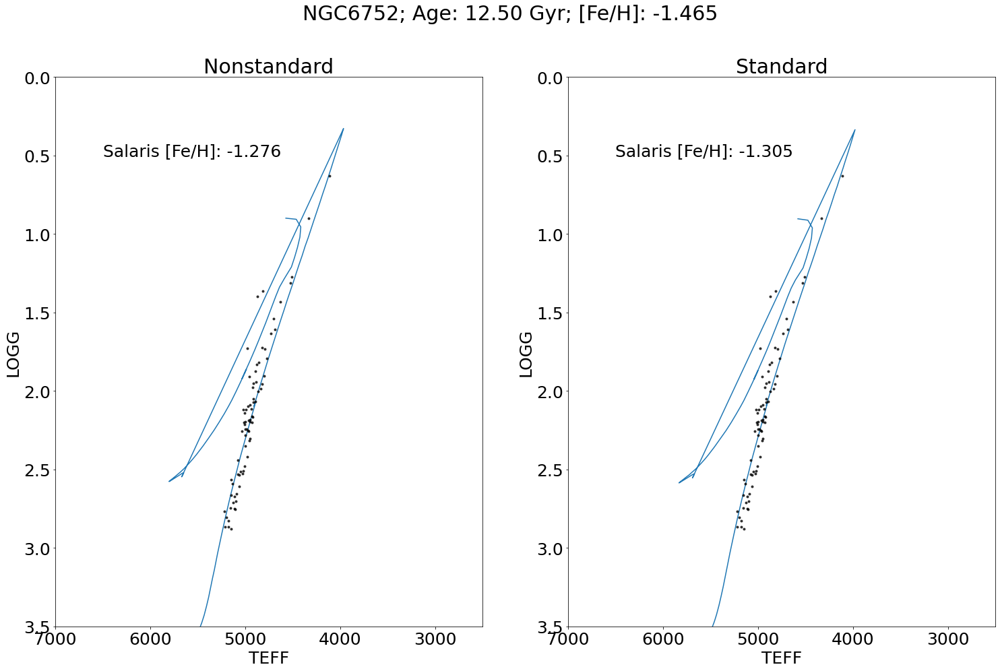

In [194]:
for i in range(len(gcs_clus)):
    clus = np.where(gcs['CLUSTER']==gcs_clus[i])
    isopick1 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(sal[clus])))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    isopick2 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(gcsdr17['M_H'][clus])+
                                               np.log10(0.638*(10**np.nanmedian(gcsdr17['ALPHA_M'][clus]))+0.362)))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    
#     print(closest(massive['logAge'],np.log10(gcs_ages[i]*10**9)))
    
    fig, ax = plt.subplots(1,2,figsize=[25,15])

    ax[0].plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],zorder=0)
    ax[0].text(6500,0.5,r'Salaris [Fe/H]: {:.3f}'.format(np.nanmedian(sal[clus])))
    ax[0].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[0].set_xlabel(r'TEFF')
    ax[0].set_ylabel(r'LOGG')
    ax[0].set_ylim(0,3.5)
    ax[0].set_xlim(2500,7000)
    ax[0].invert_yaxis()
    ax[0].invert_xaxis()
    ax[0].set_title(r'Nonstandard')
    
    ax[1].plot(10**massive['logTe'][isopick2],massive['logg'][isopick2],zorder=0)
    ax[1].text(6500,0.5,r'Salaris [Fe/H]: {:.3f}'.format(np.nanmedian(gcsdr17['M_H'][clus])+
                                                         np.log10(0.638*(10**np.nanmedian(gcsdr17['ALPHA_M'][clus]))+
                                                                  0.362)))
    ax[1].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[1].set_xlabel(r'TEFF')
    ax[1].set_ylabel(r'LOGG')
    ax[1].set_ylim(0,3.5)
    ax[1].set_xlim(2500,7000)
    ax[1].invert_yaxis()
    ax[1].invert_xaxis()
    ax[1].set_title(r'Standard')
    
    plt.suptitle(r'{}; Age: {:.2f} Gyr; [Fe/H]: {:.3f}'.format(gcs_clus[i],gcs_ages[i],
                                                                        np.nanmedian(gcsdr17['FE_H'][clus])))
    plt.savefig('{}SalarisSideBySideDR17.pdf'.format(gcs_clus[i]),bbox_inches='tight')
    plt.show()

# Salaris ALPHA+C+N

In [195]:
#{'C':8.39,'N':7.78,'O':8.66,'MG':7.53,'SI':7.51,'S':7.14,'CA':6.31,'TI':4.95}
asplund = np.array([8.39,7.78,8.66,7.53,7.51,7.14,6.31,4.95]) #Asplund et al. 2009 
enrich = np.array([])
for i in range(3):
    xfe = np.array([gcsdr17['C_FE'][i],gcsdr17['N_FE'][i],gcsdr17['O_FE'][i],gcsdr17['MG_FE'][i],
                    gcsdr17['SI_FE'][i],gcsdr17['S_FE'][i],gcsdr17['CA_FE'][i],gcsdr17['TI_FE'][i]])
    
    exp = asplund-12.00+xfe
    print(exp)

[-3.60783283 -3.48069993 -3.34437695 -4.07246697 -4.23089935 -4.49371795
 -5.46420497 -6.78940679]
[-3.58352898 -4.05085001 -3.002487   -4.11402699 -4.2096694  -4.36287801
 -5.552665   -6.96409683]
[-3.78486    -3.14681003 -3.18309304 -4.11316702 -4.2718194  -4.48309802
 -5.51460499 -6.89854686]


(array([ 20.,  65., 187., 196., 217., 366., 187.,  19.,   3.,   2.]),
 array([-0.52684   , -0.28019598, -0.03355198,  0.21309201,  0.45973602,
         0.70638   ,  0.953024  ,  1.199668  ,  1.446312  ,  1.692956  ,
         1.9396    ], dtype=float32),
 <a list of 10 Patch objects>)

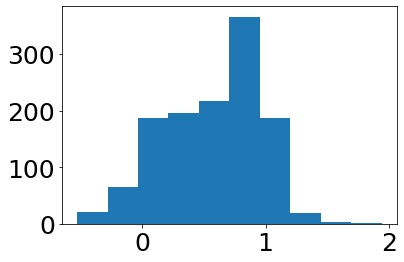

In [196]:
plt.hist(gcsdr17['N_FE'])

In [102]:
# def AlphaCN(xfe):
#     '''
#     Calculate the enrichment factor of alpha elements with C+N
    
#     Inputs:
#     ------
#         xfe: dictionary of X_FE values for star with the order C_FE,N_FE,O_FE,MG_FE,SI_FE,S_FE,CA_FE,TI_FE
        
#     Outputs:
#     -------
#         f: enrichment factor
    
#     '''
    
#     # Asplund et al. 2009
#     asplund = {'C':8.39,'N':7.78,'O':8.66,'MG':7.53,'SI':7.51,'S':7.14,'CA':6.31,'TI':4.95}
    
#     # Create lost of keys from xfe to match asplund
#     xfe_keys = list(asplund.keys())
#     key = []
#     for i in range(len(xfe_keys)):
#         key.append(xfe_keys[i].split("_")[0])
        
#     # find the enrichment factor
#     sum(np.)
        
#     return f
    
    
# ### Get Solar Fractions
# abd = {'C':8.39,'N':7.78,'O':8.66,'Mg':7.53,'Ca':6.31,'S':7.14,'Si':7.51,'Fe':7.45}
# keys = list(abd.keys())

# sol_2_H = []
# for i in keys:
#     sol_2_H.append(abd[i]-12.0)
    
# sol_xm  = 10**np.asarray(sol_2_H)/sum(10**np.asarray(sol_2_H))

# sal = np.array([])
# for i in range(len(gcs)):
#     x_C_new = sol_xm[0]*10**(gcs['C_FE'][i]+gcs['FE_H'][i]-gcs['M_H'][i])
#     x_N_new = sol_xm[1]*10**(gcs['N_FE'][i]+gcs['FE_H'][i]-gcs['M_H'][i])
        
#     ffac_new = (x_C_new+x_N_new)/sum(sol_xm[0:2])
    
#     sal = np.append(sal,gcs['M_H'][i]+np.log10(0.638*ffac_new+0.362))

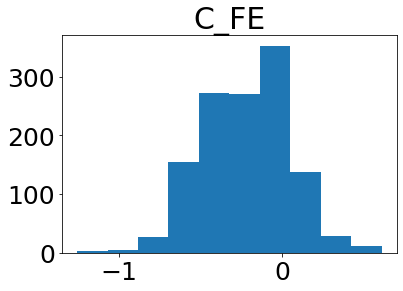

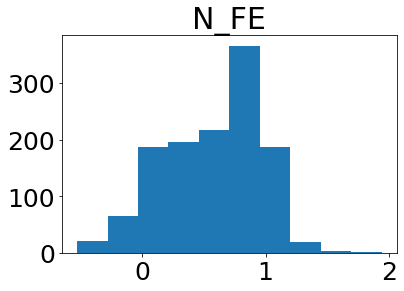

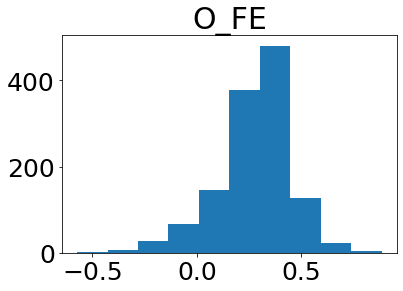

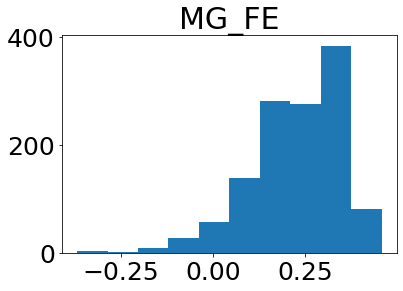

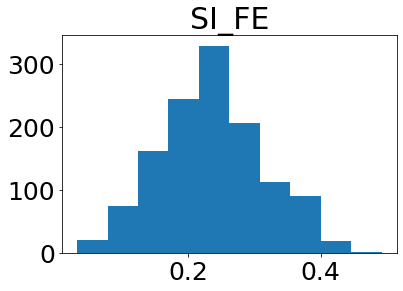

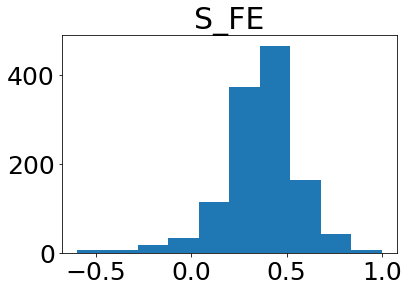

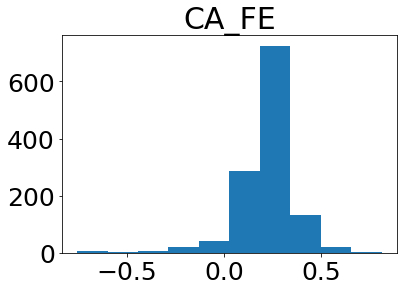

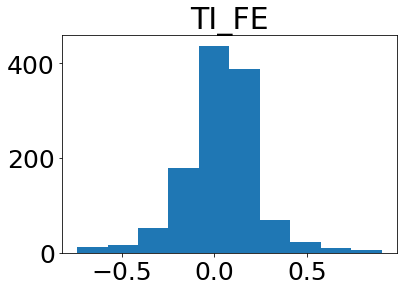

In [198]:
alphacn = np.array(['C_FE','N_FE','O_FE','MG_FE','SI_FE','S_FE','CA_FE','TI_FE'])
for i in range(len(alphacn)):
    plt.figure()
    plt.hist(gcsdr17[alphacn[i]])
    plt.title(r'{}'.format(alphacn[i]))
    plt.show()

In [233]:
fac_acn = np.array([])
for i in range(len(gcs)):
    xfe = np.array([gcsdr17['C_FE'][i],gcsdr17['N_FE'][i],gcsdr17['O_FE'][i],gcsdr17['MG_FE'][i],gcsdr17['SI_FE'][i],gcsdr17['S_FE'][i],
                    gcsdr17['CA_FE'][i],gcsdr17['TI_FE'][i]])
    
    for j in range(len(xfe)):
        if xfe[j] < -100.:
            xfe[j] = 0.0
    
    # Asplund et al. 2009
    # log epsilon_x: C,N,O,Mg,Si,S,Ca,Ti
    asplund = np.array([8.39,7.78,8.66,7.53,7.51,7.14,6.31,4.95])
    
    fac_acn = np.append(fac_acn,sum(10**(asplund+xfe))/sum(10**asplund))

(array([ 16.,  56., 109., 242., 178., 195., 140.,  75., 128.,  16.]),
 array([-1.8860831 , -1.72631011, -1.56653712, -1.40676413, -1.24699115,
        -1.08721816, -0.92744517, -0.76767218, -0.60789919, -0.4481262 ,
        -0.28835321]),
 <a list of 10 Patch objects>)

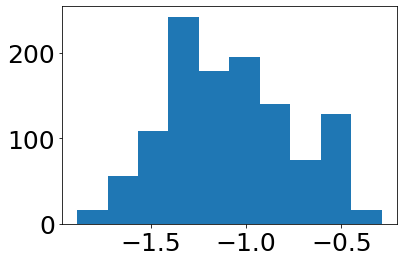

In [200]:
plt.hist(gcsdr17['FE_H']+np.log10(0.638*fac_acn+0.362))

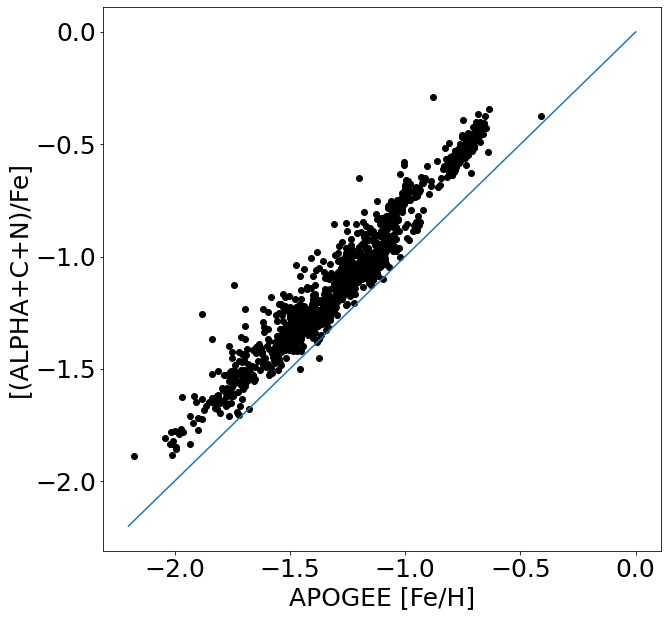

In [201]:
plt.figure(figsize=[10,10])
plt.scatter(gcsdr17['FE_H'],gcsdr17['FE_H']+np.log10(0.638*fac_acn+0.362),c='k')
plt.plot([-2.2,0],[-2.2,0],c='tab:blue')
plt.xlabel(r'APOGEE [Fe/H]')
plt.ylabel(r'[(ALPHA+C+N)/Fe]')
plt.savefig('AlphaCNAPOGEEDR17.pdf',bbox_inches='tight')

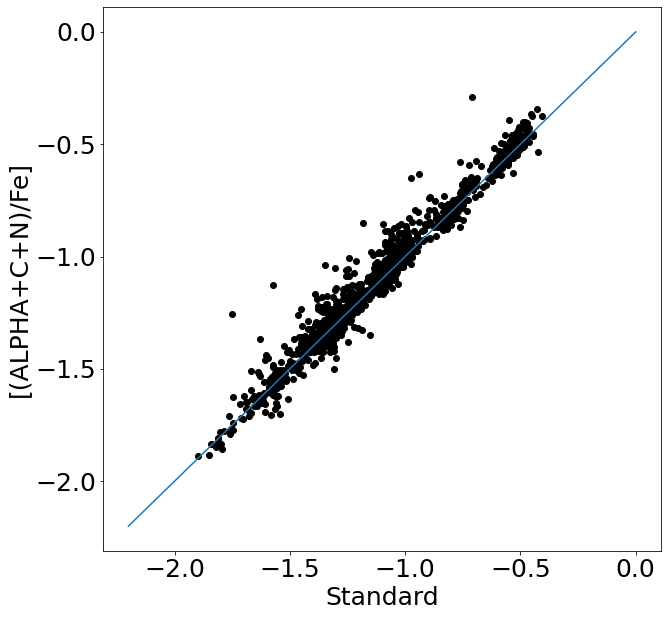

In [202]:
plt.figure(figsize=[10,10])
plt.scatter(gcsdr17['M_H']+np.log10(0.638*10**(gcsdr17['ALPHA_M'])+0.362),gcsdr17['FE_H']+np.log10(0.638*fac_acn+0.362),c='k')
plt.plot([-2.2,0],[-2.2,0],c='tab:blue')
plt.xlabel(r'Standard')
plt.ylabel(r'[(ALPHA+C+N)/Fe]')
plt.savefig('StandardAlphaCNDR17.pdf',bbox_inches='tight')

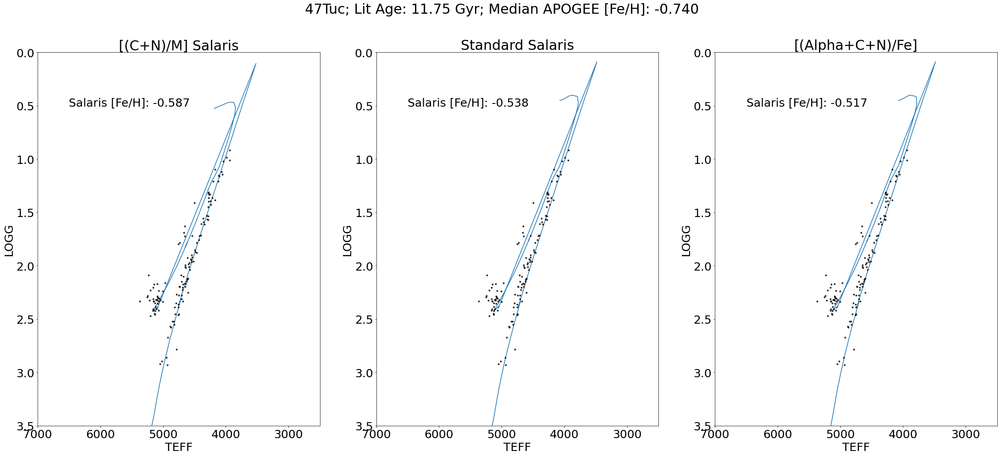

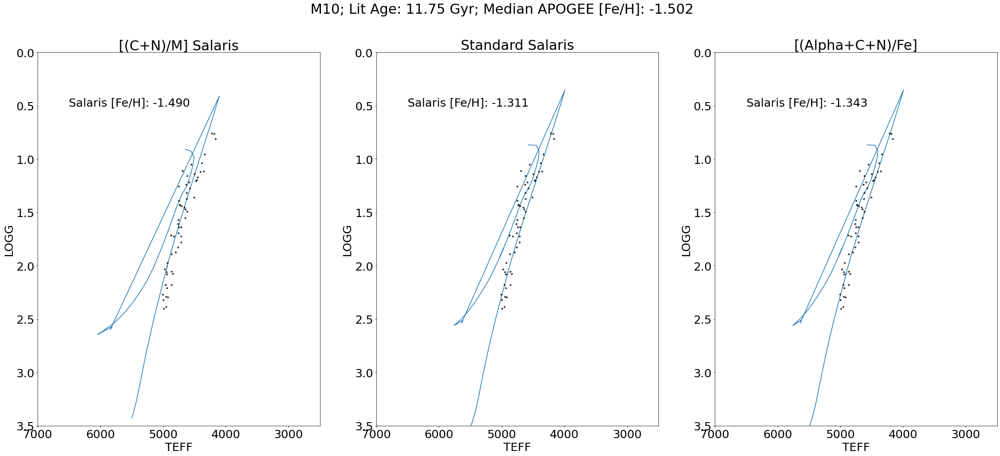

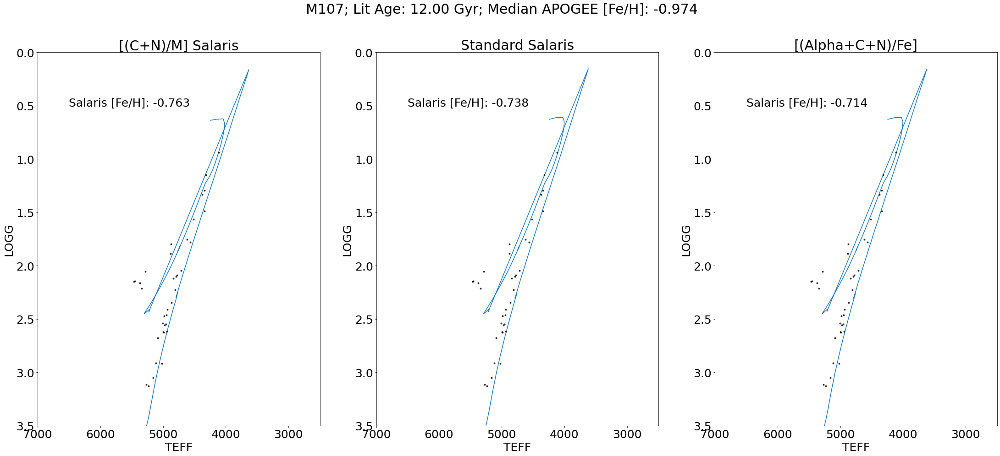

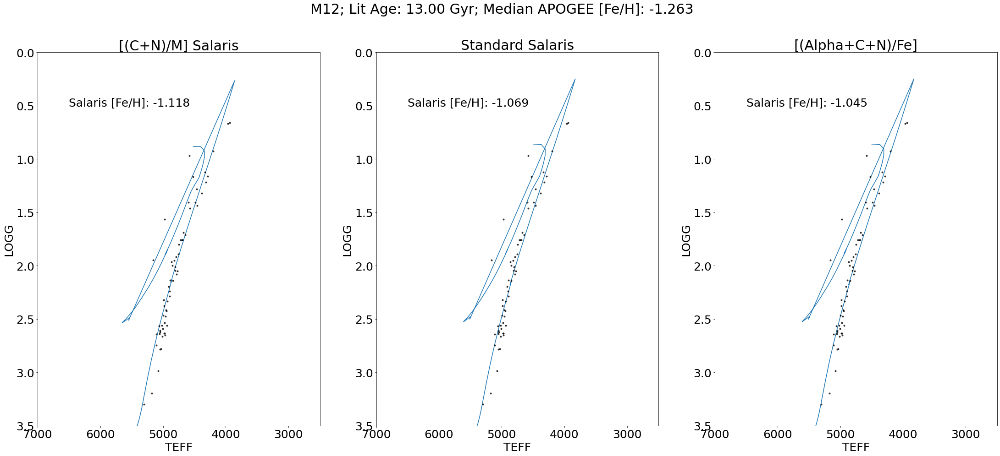

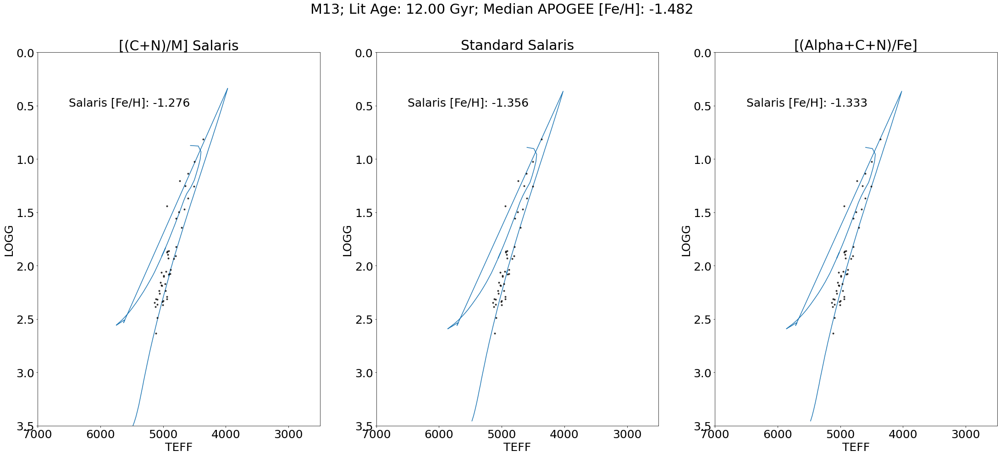

...

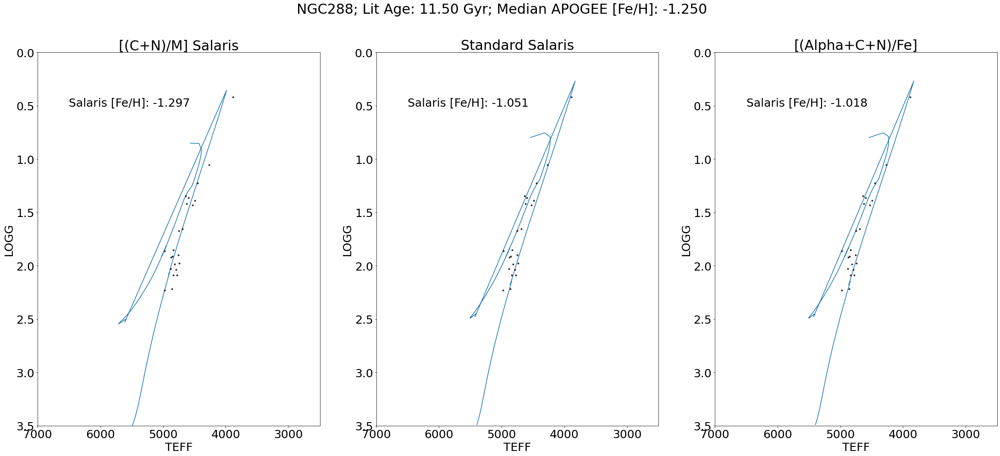

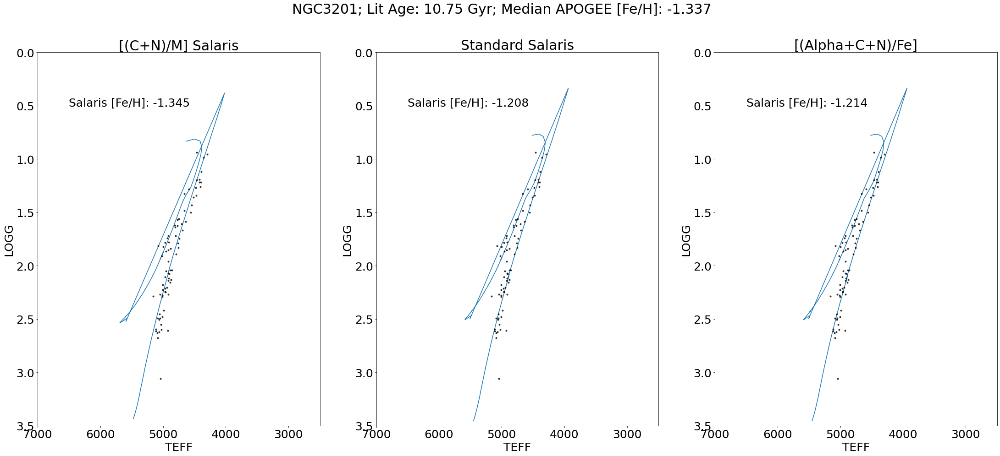

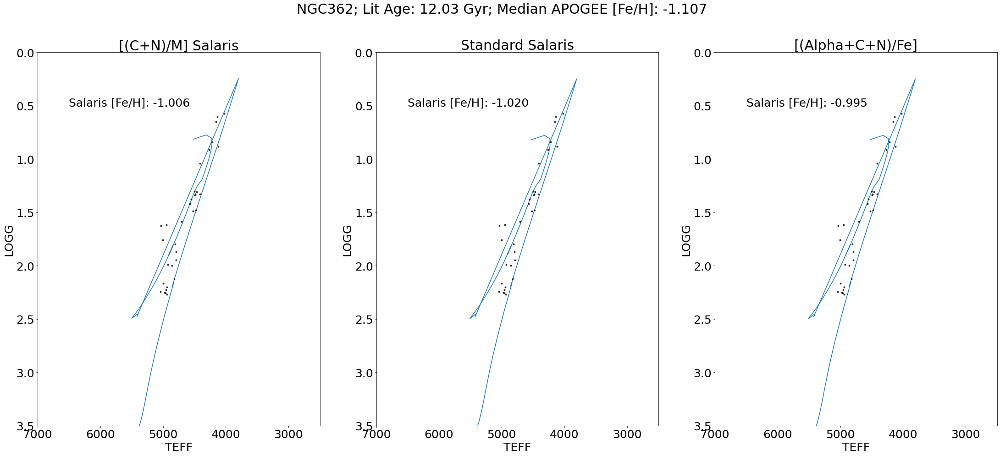

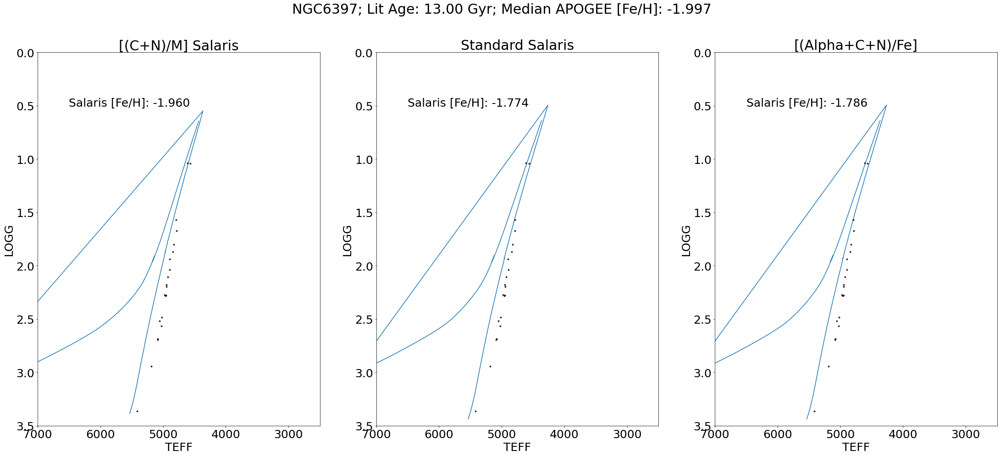

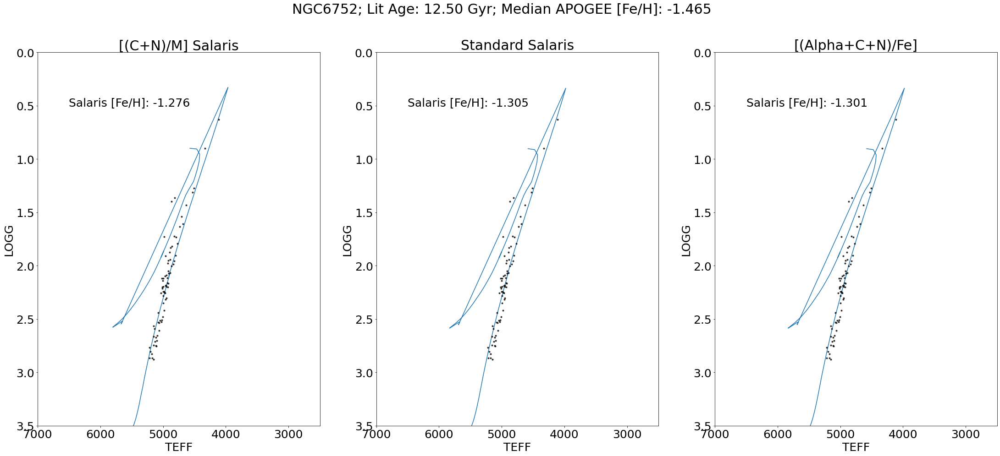

In [204]:
for i in range(len(gcs_clus)):
    clus = np.where(gcs['CLUSTER']==gcs_clus[i])
    isopick1 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(sal[clus])))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    isopick2 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(gcsdr17['M_H'][clus])+
                                               np.log10(0.638*(10**np.nanmedian(gcsdr17['ALPHA_M'][clus]))+0.362)))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    isopick3 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(gcsdr17['FE_H'][clus])+
                                               np.log10(0.638*(np.nanmedian(fac_acn[clus]))+0.362)))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    fig, ax = plt.subplots(1,3,figsize=[37.5,15])

    ax[0].plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],zorder=0)
    ax[0].text(6500,0.5,r'Salaris [Fe/H]: {:.3f}'.format(np.nanmedian(sal[clus])))
    ax[0].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[0].set_xlabel(r'TEFF')
    ax[0].set_ylabel(r'LOGG')
    ax[0].set_ylim(0,3.5)
    ax[0].set_xlim(2500,7000)
    ax[0].invert_yaxis()
    ax[0].invert_xaxis()
    ax[0].set_title(r'[(C+N)/M] Salaris')
    
    ax[1].plot(10**massive['logTe'][isopick2],massive['logg'][isopick2],zorder=0)
    ax[1].text(6500,0.5,
               r'Salaris [Fe/H]: {:.3f}'.format(np.nanmedian(gcsdr17['M_H'][clus])+
                                                np.log10(0.638*(10**np.nanmedian(gcsdr17['ALPHA_M'][clus]))+0.362)))
    ax[1].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[1].set_xlabel(r'TEFF')
    ax[1].set_ylabel(r'LOGG')
    ax[1].set_ylim(0,3.5)
    ax[1].set_xlim(2500,7000)
    ax[1].invert_yaxis()
    ax[1].invert_xaxis()
    ax[1].set_title(r'Standard Salaris')
    
    ax[2].plot(10**massive['logTe'][isopick2],massive['logg'][isopick2],zorder=0)
    ax[2].text(6500,0.5,
               r'Salaris [Fe/H]: {:.3f}'.format(np.nanmedian(gcsdr17['FE_H'][clus])+
                                                np.log10(0.638*(np.nanmedian(fac_acn[clus]))+0.362)))
    ax[2].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[2].set_xlabel(r'TEFF')
    ax[2].set_ylabel(r'LOGG')
    ax[2].set_ylim(0,3.5)
    ax[2].set_xlim(2500,7000)
    ax[2].invert_yaxis()
    ax[2].invert_xaxis()
    ax[2].set_title(r'[(Alpha+C+N)/Fe]')
    
    plt.suptitle(r'{}; Lit Age: {:.2f} Gyr; Median APOGEE [Fe/H]: {:.3f}'.format(gcs_clus[i],gcs_ages[i],
                                                               np.nanmedian(gcsdr17['FE_H'][clus])))
    plt.savefig('{}SalarisSideBySide2DR17.pdf'.format(gcs_clus[i]),bbox_inches='tight')
    plt.show()

# Metallicity Offset 0.1 dex

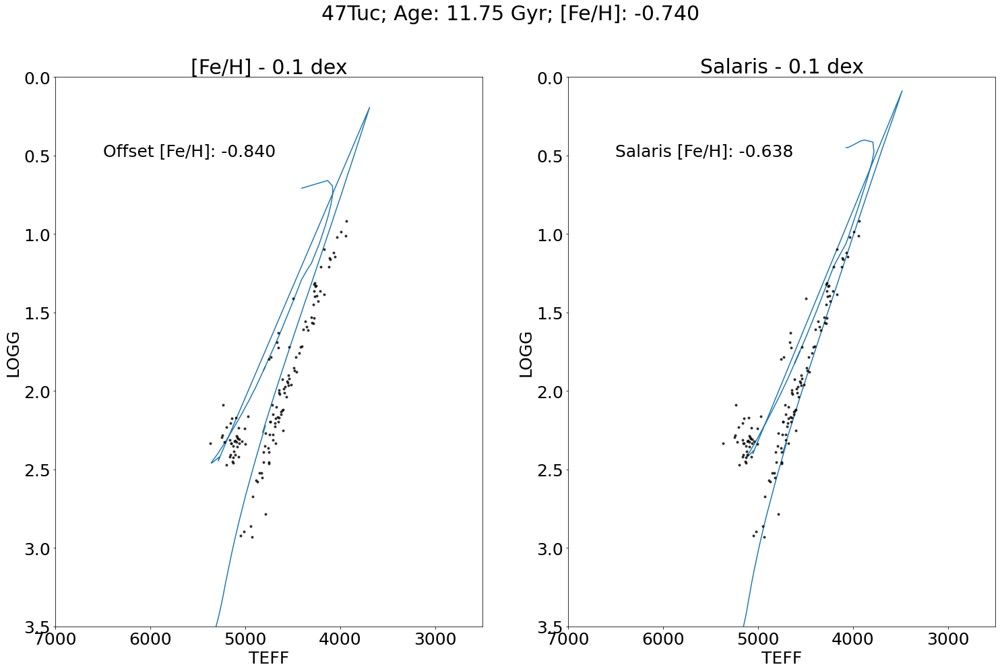

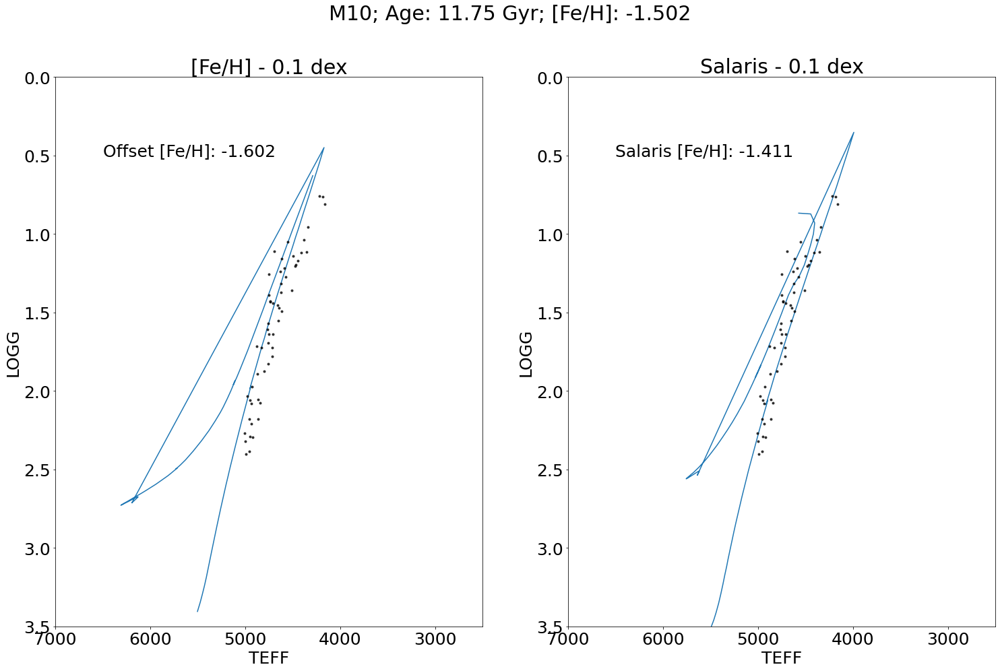

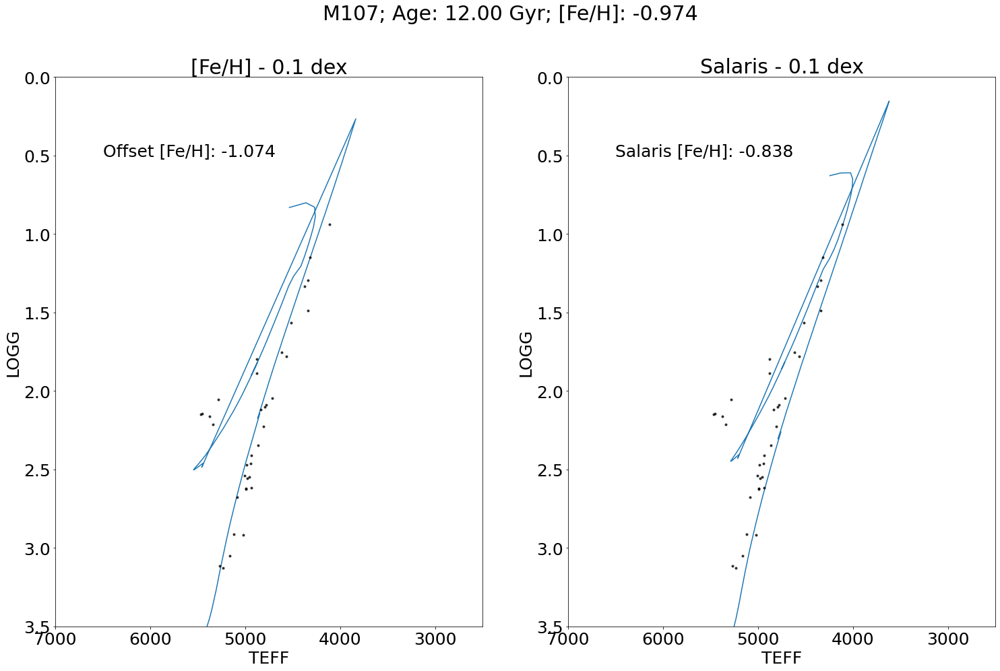

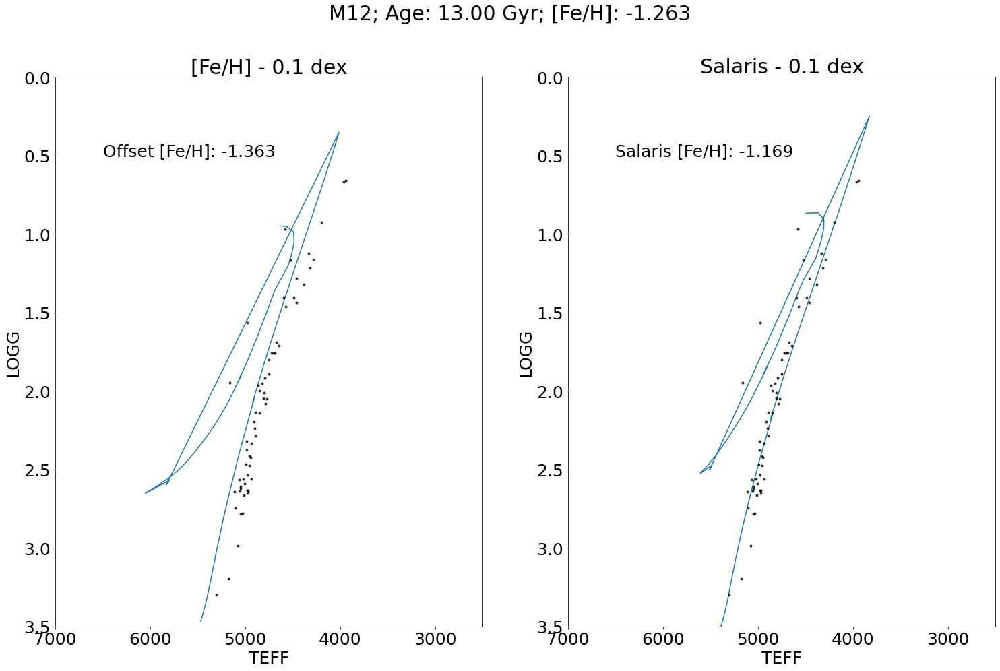

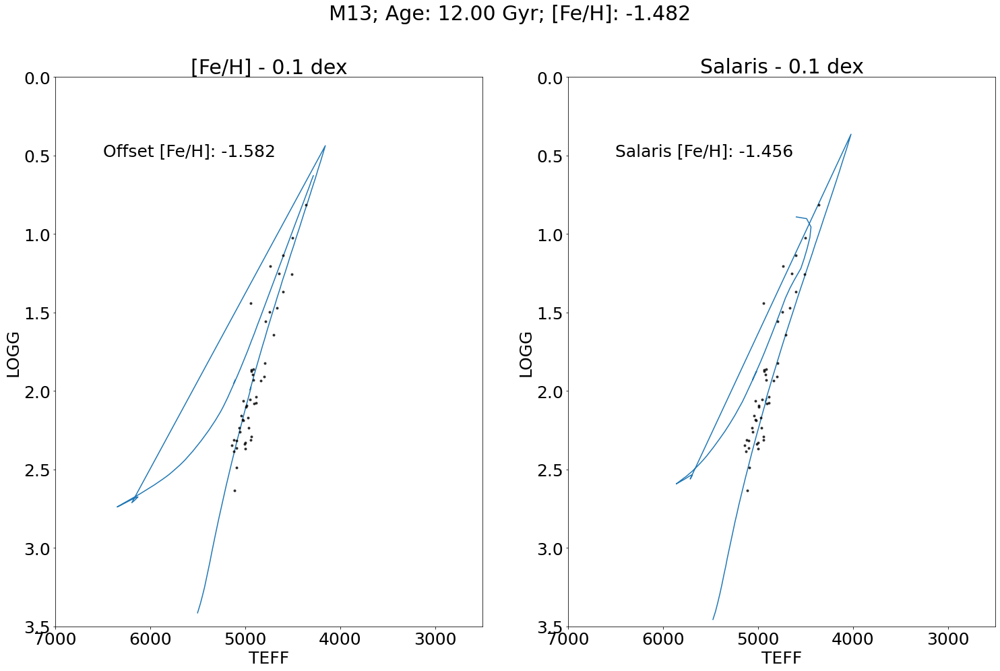

...

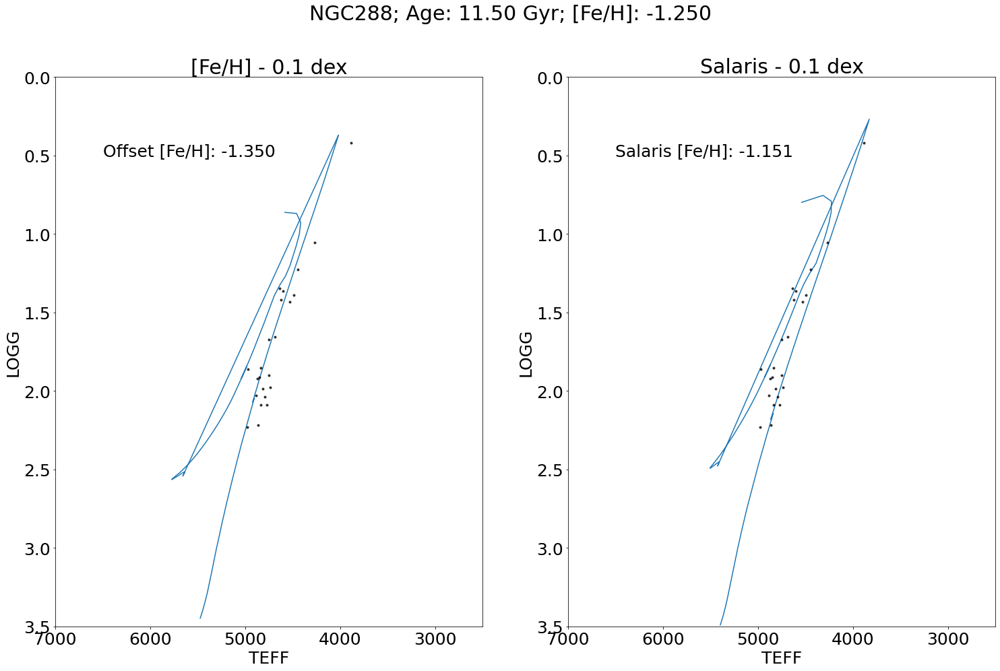

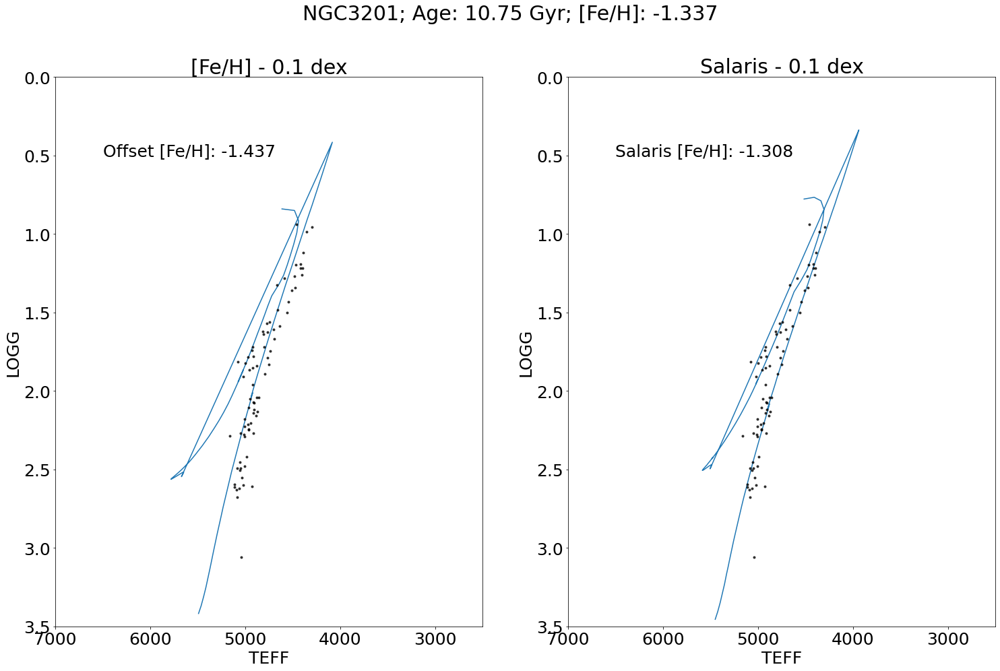

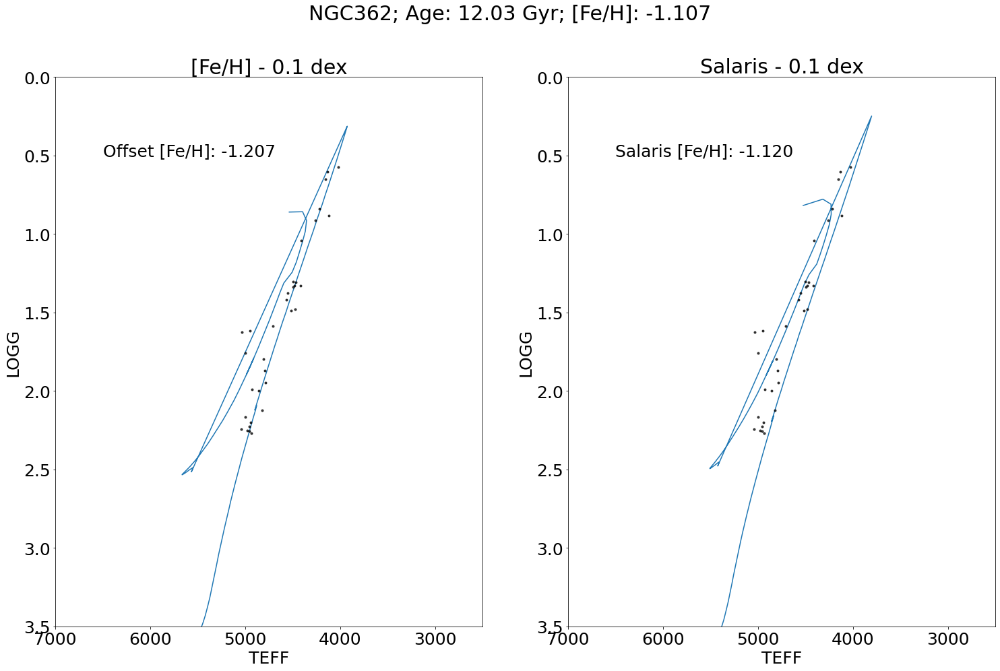

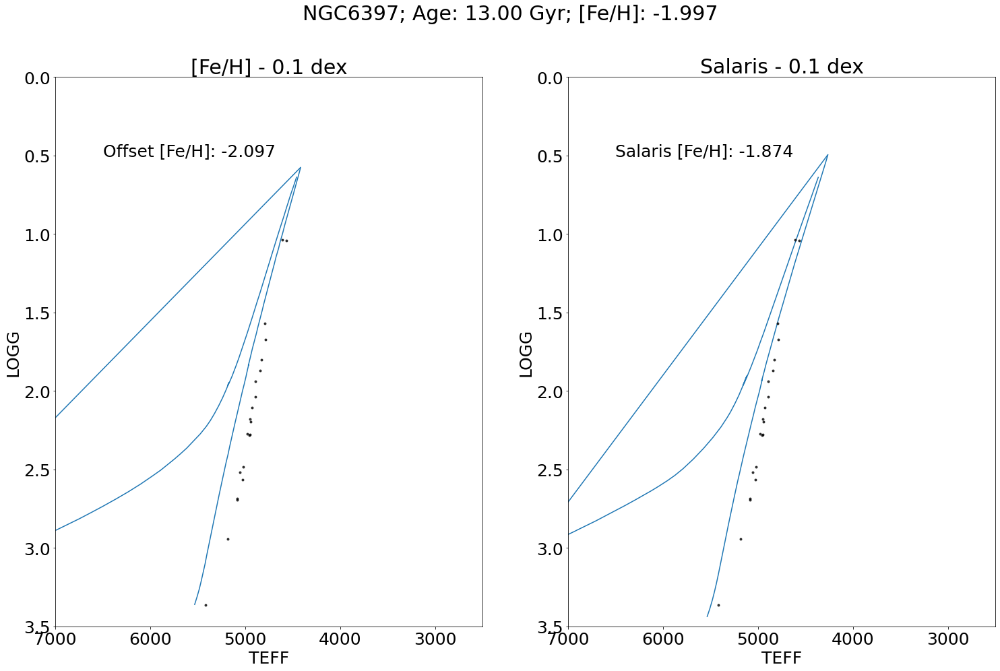

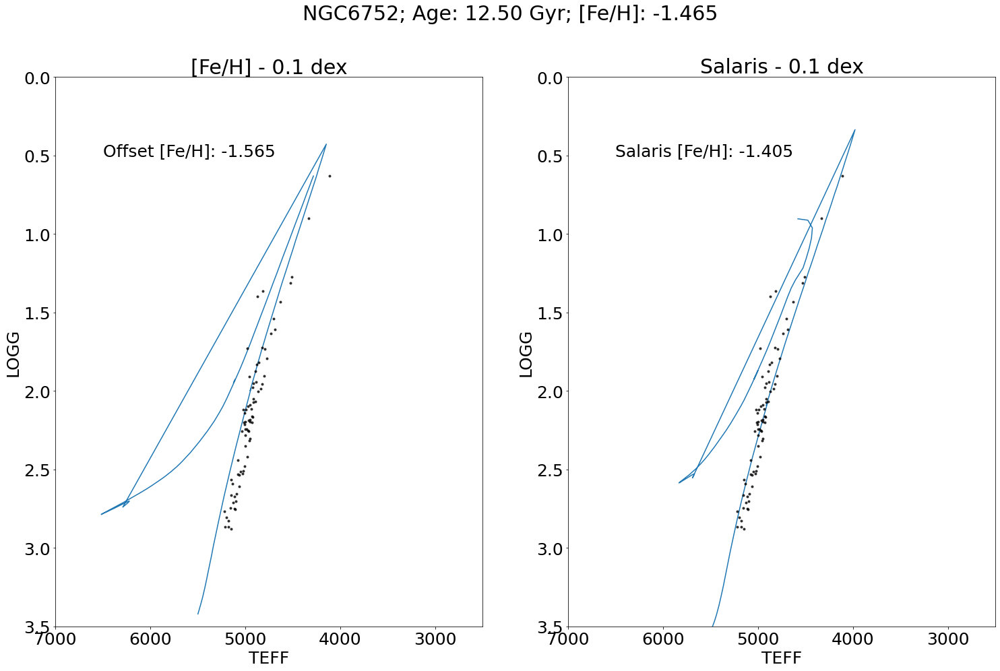

In [205]:
for i in range(len(gcs_clus)):
    clus = np.where(gcs['CLUSTER']==gcs_clus[i])
    isopick1 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(gcsdr17['FE_H'][clus])-0.1))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    isopick2 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(gcsdr17['M_H'][clus])+
                                               np.log10(0.638*(10**np.nanmedian(gcsdr17['ALPHA_M'][clus]))+0.362)))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    
#     print(closest(massive['logAge'],np.log10(gcs_ages[i]*10**9)))
    
    fig, ax = plt.subplots(1,2,figsize=[25,15])

    ax[0].plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],zorder=0)
    ax[0].text(6500,0.5,r'Offset [Fe/H]: {:.3f}'.format(np.nanmedian(gcsdr17['FE_H'][clus])-0.1))
    ax[0].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[0].set_xlabel(r'TEFF')
    ax[0].set_ylabel(r'LOGG')
    ax[0].set_ylim(0,3.5)
    ax[0].set_xlim(2500,7000)
    ax[0].invert_yaxis()
    ax[0].invert_xaxis()
    ax[0].set_title(r'[Fe/H] - 0.1 dex')
    
    ax[1].plot(10**massive['logTe'][isopick2],massive['logg'][isopick2],zorder=0)
    ax[1].text(6500,0.5,r'Salaris [Fe/H]: {:.3f}'.format(np.nanmedian(gcsdr17['M_H'][clus])-0.1+
                                                         np.log10(0.638*(10**np.nanmedian(gcsdr17['ALPHA_M'][clus]))+
                                                                  0.362)))
    ax[1].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[1].set_xlabel(r'TEFF')
    ax[1].set_ylabel(r'LOGG')
    ax[1].set_ylim(0,3.5)
    ax[1].set_xlim(2500,7000)
    ax[1].invert_yaxis()
    ax[1].invert_xaxis()
    ax[1].set_title(r'Salaris - 0.1 dex')
    
    plt.suptitle(r'{}; Age: {:.2f} Gyr; [Fe/H]: {:.3f}'.format(gcs_clus[i],gcs_ages[i],
                                                                        np.nanmedian(gcsdr17['FE_H'][clus])))
    plt.savefig('{}OffsetSideBySideDR17.pdf'.format(gcs_clus[i]),bbox_inches='tight')
    plt.show()

# Constant TEFF offset

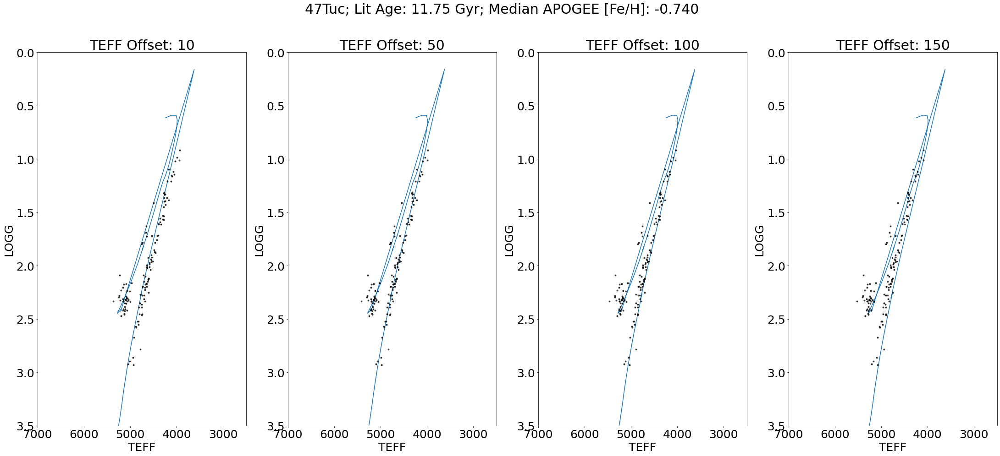

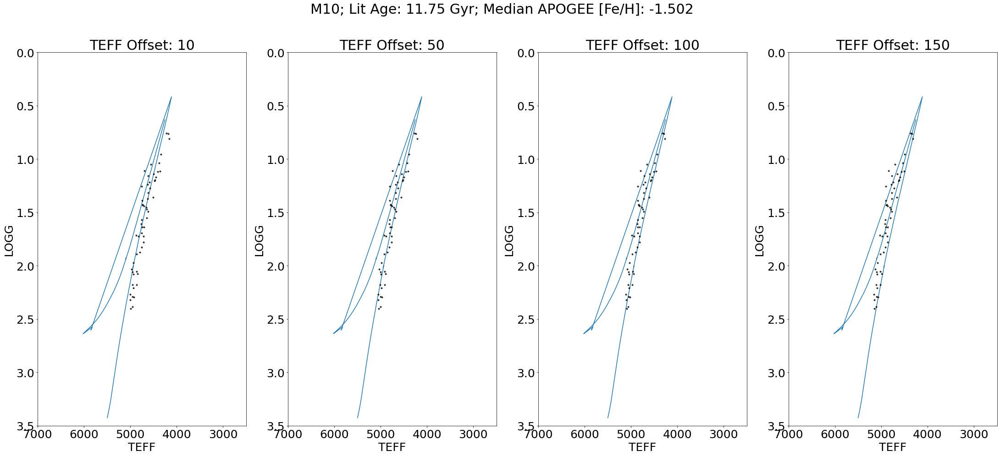

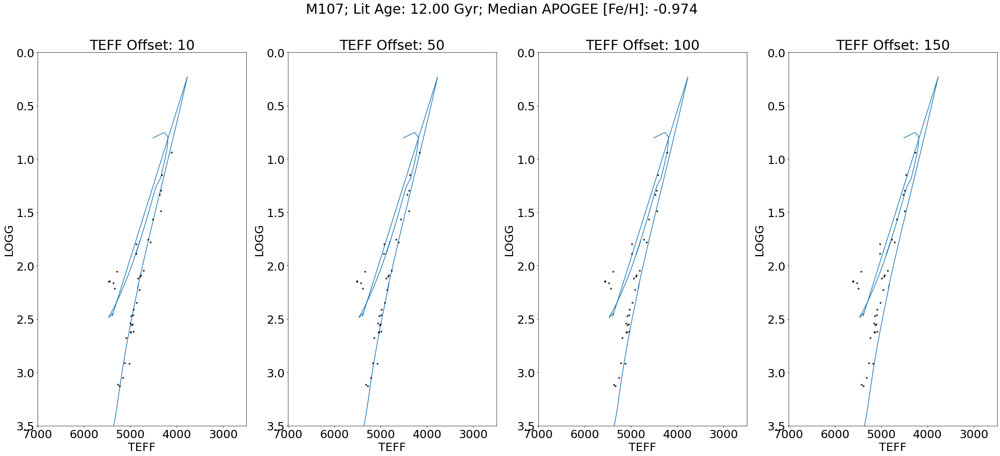

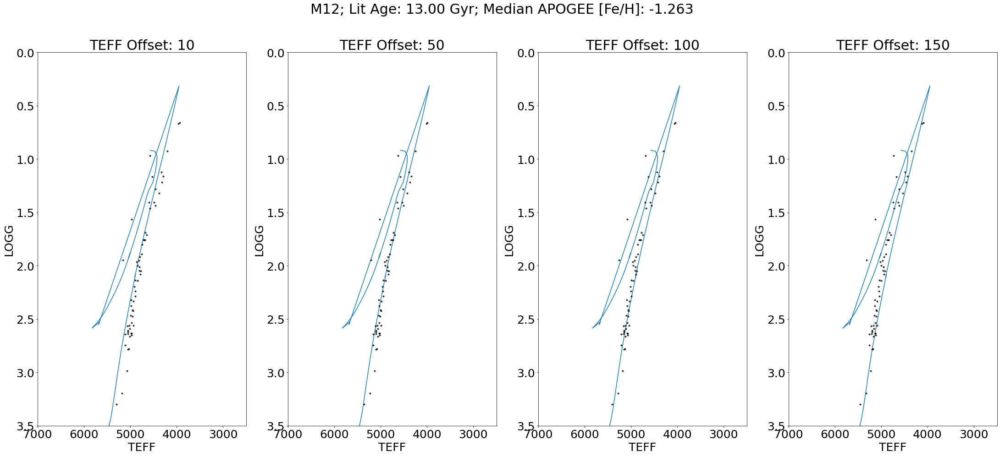

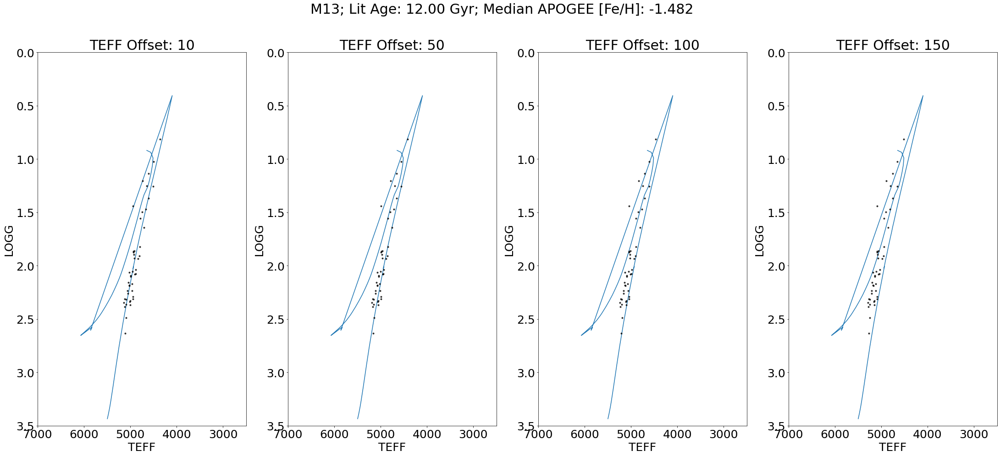

...

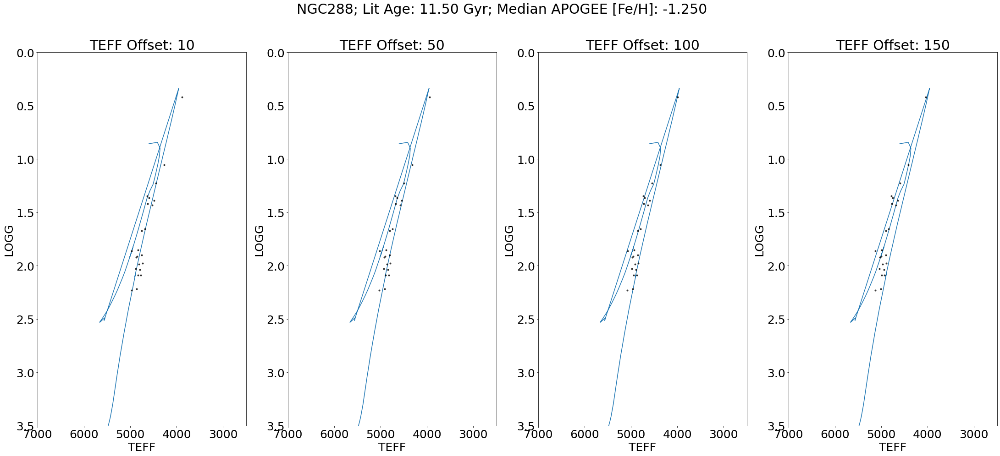

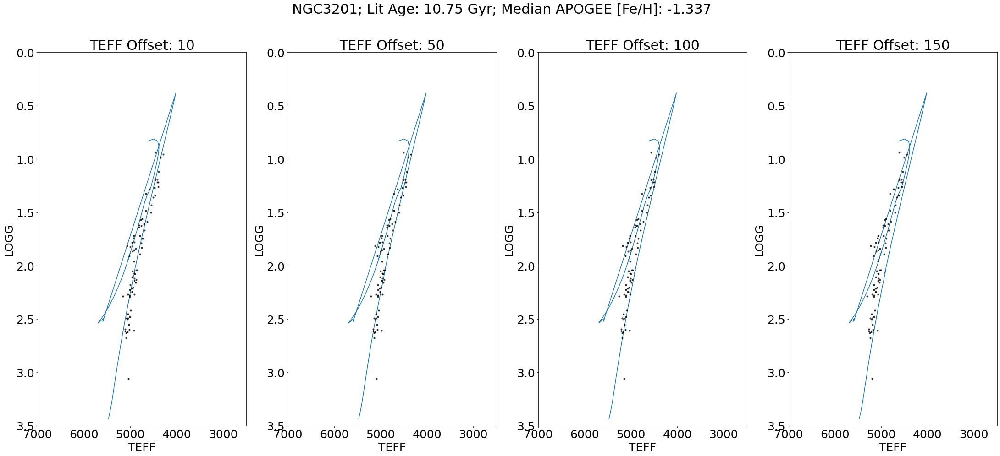

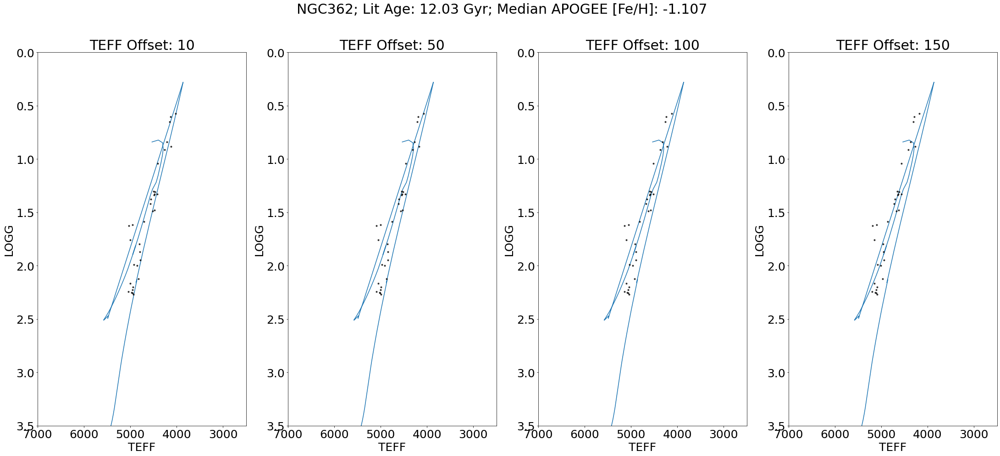

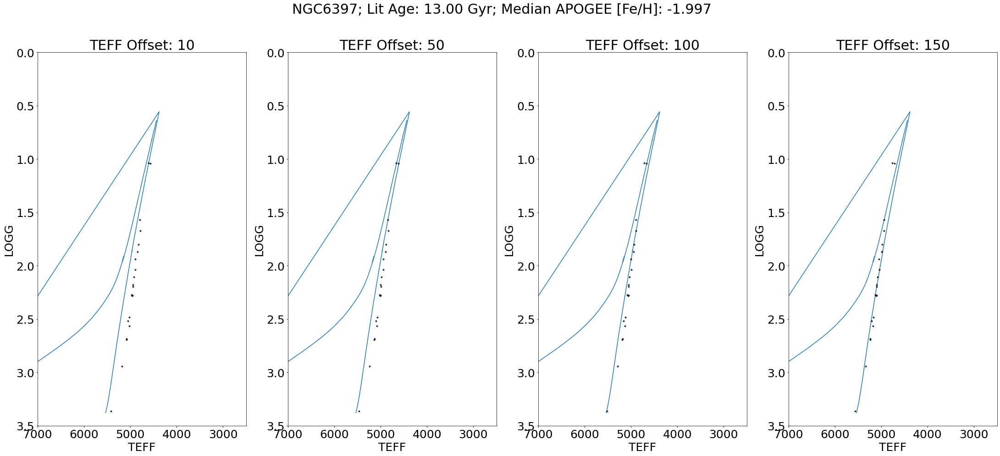

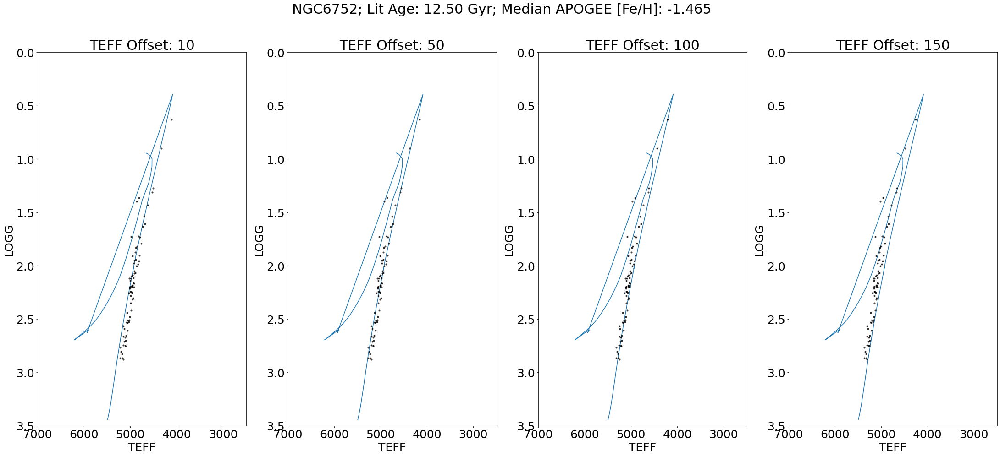

In [206]:
for i in range(len(gcs_clus)):
    clus = np.where(gcs['CLUSTER']==gcs_clus[i])
    isopick1 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(gcsdr17['FE_H'][clus])))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    fig, ax = plt.subplots(1,4,figsize=[37.5,15])

    ax[0].plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],zorder=0)
    ax[0].set_title(r'TEFF Offset: 10')
    ax[0].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[0].set_xlabel(r'TEFF')
    ax[0].set_ylabel(r'LOGG')
    ax[0].set_ylim(0,3.5)
    ax[0].set_xlim(2500,7000)
    ax[0].invert_yaxis()
    ax[0].invert_xaxis()
    
    ax[1].plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],zorder=0)
    ax[1].set_title(r'TEFF Offset: 50')
    ax[1].scatter(gcsdr17['TEFF'][clus]+50,gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[1].set_xlabel(r'TEFF')
    ax[1].set_ylabel(r'LOGG')
    ax[1].set_ylim(0,3.5)
    ax[1].set_xlim(2500,7000)
    ax[1].invert_yaxis()
    ax[1].invert_xaxis()
    
    ax[2].plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],zorder=0)
    ax[2].set_title(r'TEFF Offset: 100')
    ax[2].scatter(gcsdr17['TEFF'][clus]+100,gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[2].set_xlabel(r'TEFF')
    ax[2].set_ylabel(r'LOGG')
    ax[2].set_ylim(0,3.5)
    ax[2].set_xlim(2500,7000)
    ax[2].invert_yaxis()
    ax[2].invert_xaxis()
    
    ax[3].plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],zorder=0)
    ax[3].set_title(r'TEFF Offset: 150')
    ax[3].scatter(gcsdr17['TEFF'][clus]+150,gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[3].set_xlabel(r'TEFF')
    ax[3].set_ylabel(r'LOGG')
    ax[3].set_ylim(0,3.5)
    ax[3].set_xlim(2500,7000)
    ax[3].invert_yaxis()
    ax[3].invert_xaxis()
    
    plt.suptitle(r'{}; Lit Age: {:.2f} Gyr; Median APOGEE [Fe/H]: {:.3f}'.format(gcs_clus[i],gcs_ages[i],
                                                               np.nanmedian(gcsdr17['FE_H'][clus])))
    plt.savefig('{}TEFFSideBySideDR17.pdf'.format(gcs_clus[i]),bbox_inches='tight')
    plt.show()

nan


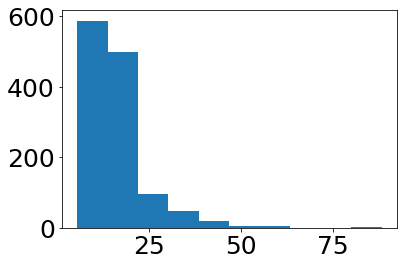

In [207]:
plt.hist(gcsdr17['TEFF_ERR'])
print(np.median(gcsdr17['TEFF_ERR']))

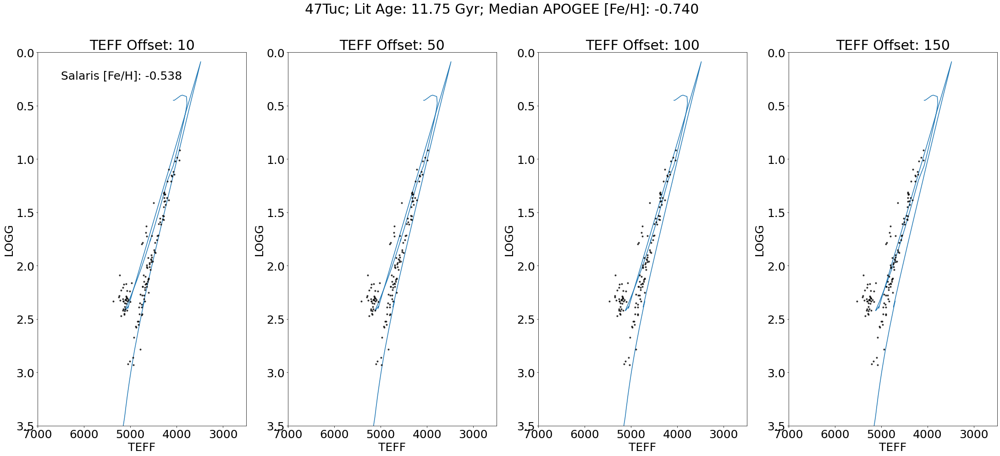

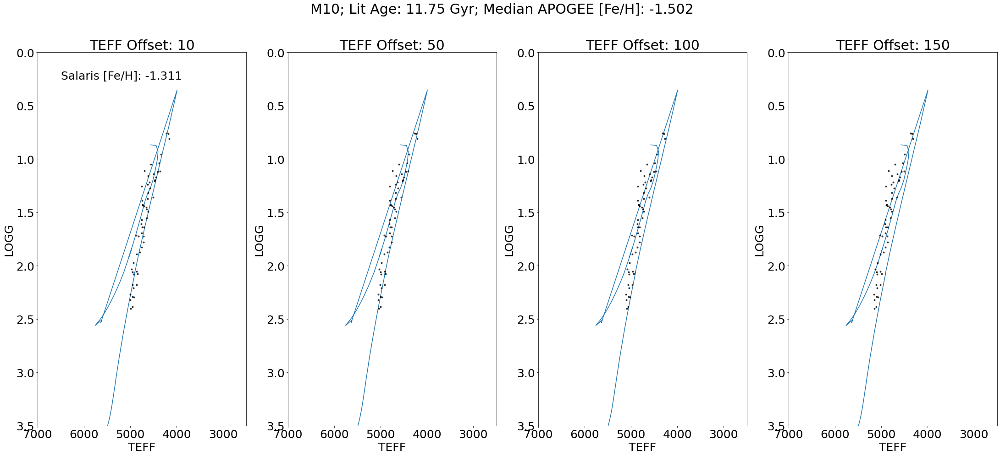

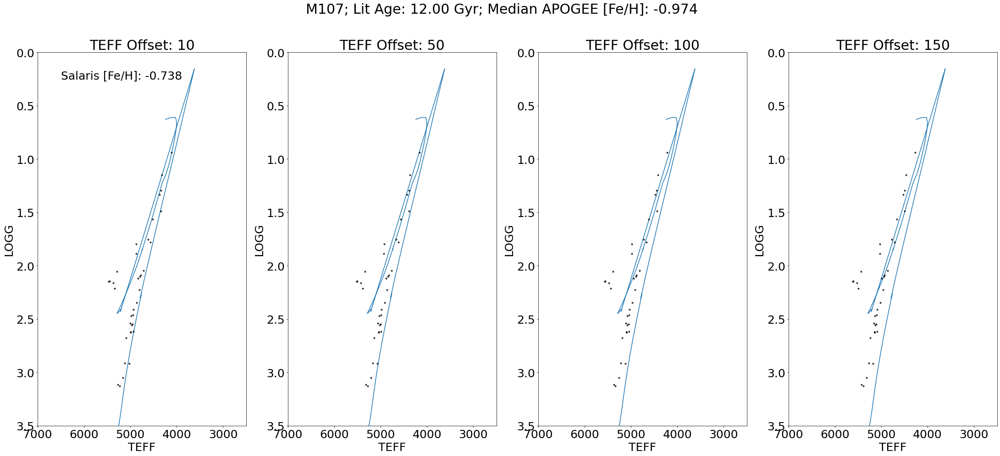

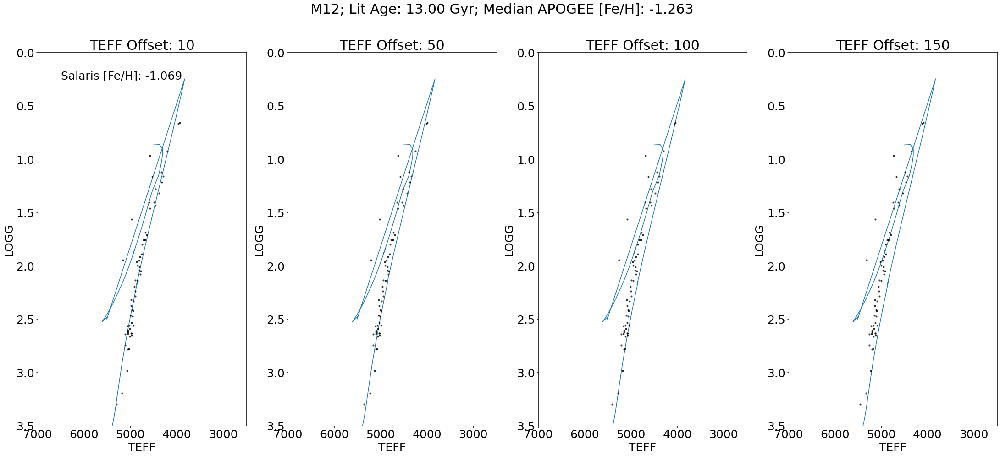

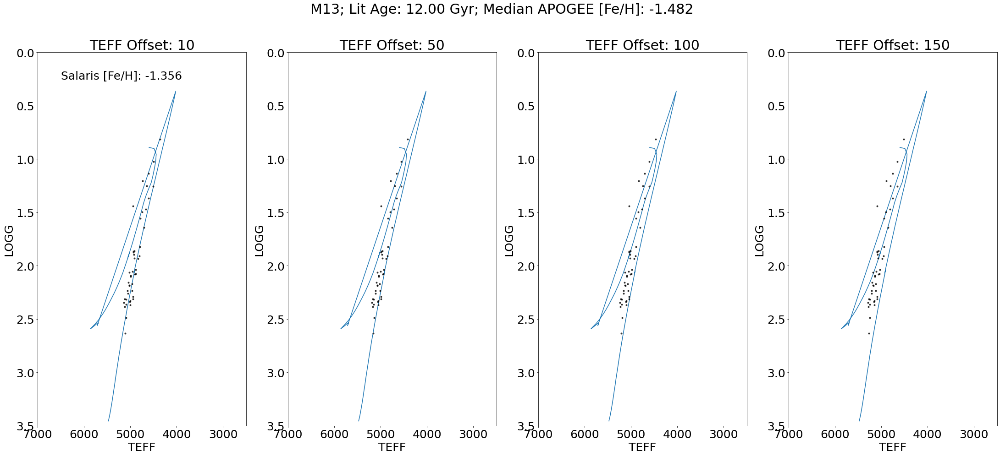

...

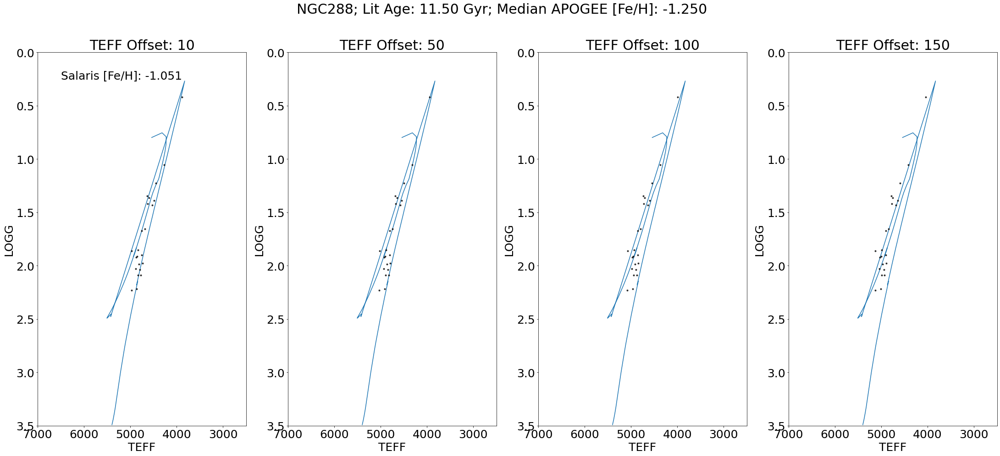

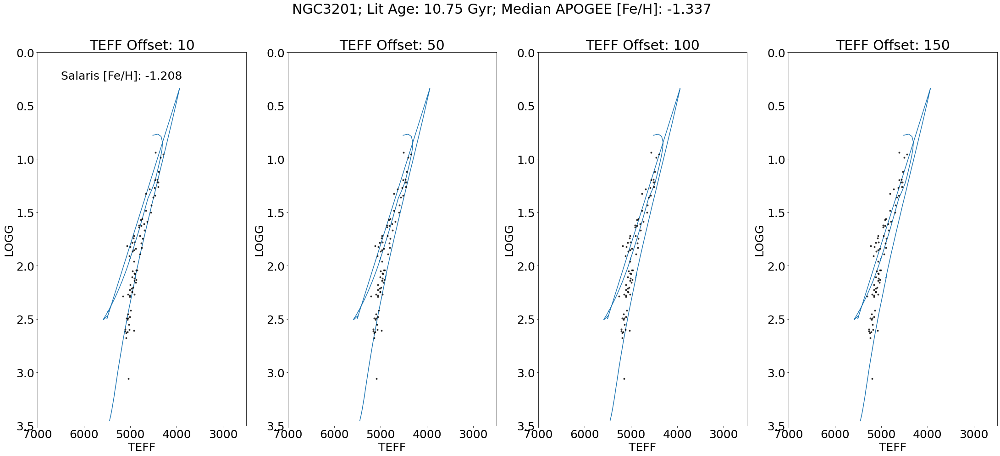

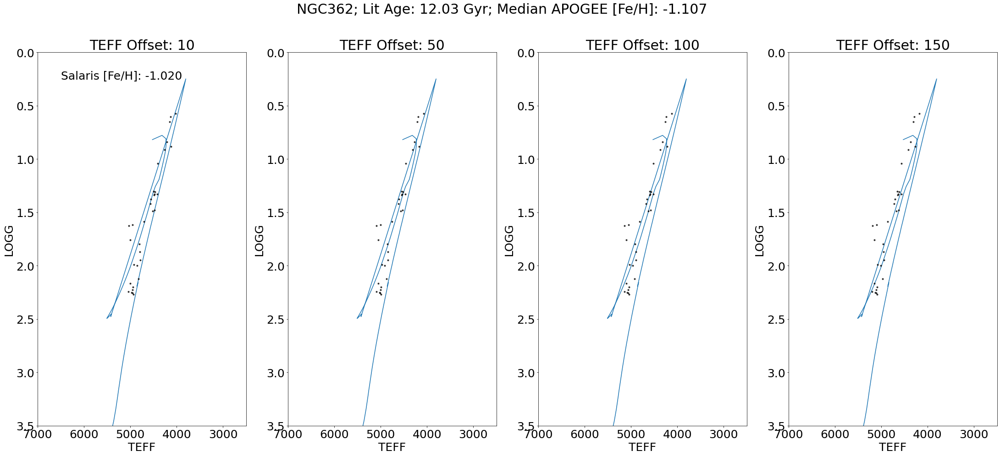

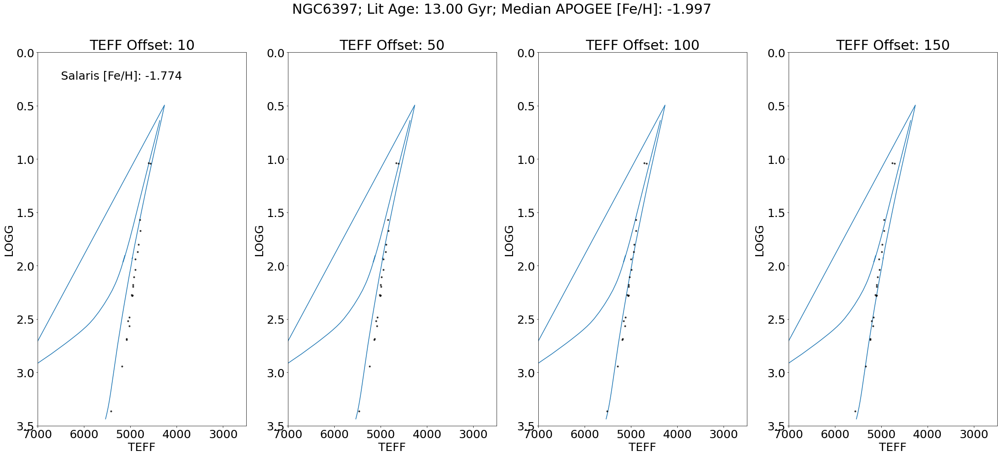

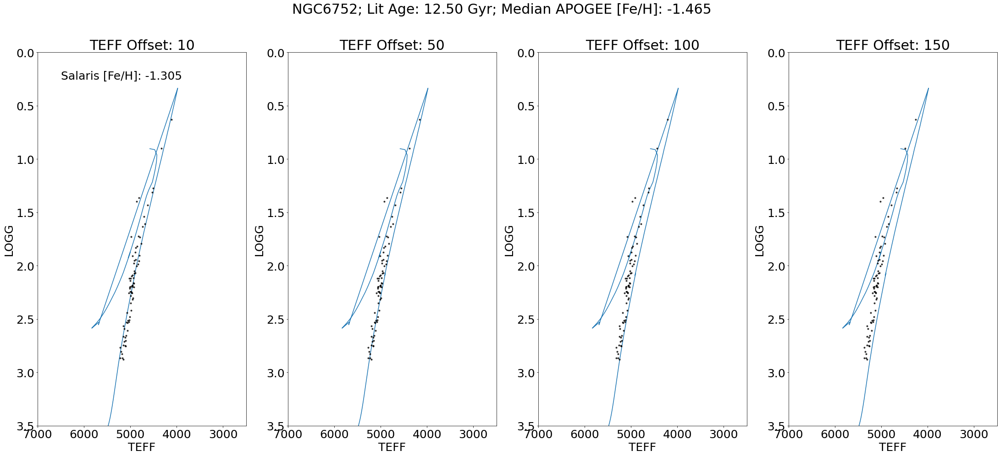

In [208]:
### With Salaris
for i in range(len(gcs_clus)):
    clus = np.where(gcs['CLUSTER']==gcs_clus[i])
    isopick1 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(gcsdr17['M_H'][clus])+
                                               np.log10(0.638*(10**np.nanmedian(gcsdr17['ALPHA_M'][clus]))+0.362)))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    fig, ax = plt.subplots(1,4,figsize=[37.5,15])

    ax[0].plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],zorder=0)
    ax[0].text(6500,0.25,
               r'Salaris [Fe/H]: {:.3f}'.format(np.nanmedian(gcsdr17['M_H'][clus])+
                                                np.log10(0.638*(10**np.nanmedian(gcsdr17['ALPHA_M'][clus]))+0.362)))
    ax[0].set_title(r'TEFF Offset: 10')
    ax[0].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[0].set_xlabel(r'TEFF')
    ax[0].set_ylabel(r'LOGG')
    ax[0].set_ylim(0,3.5)
    ax[0].set_xlim(2500,7000)
    ax[0].invert_yaxis()
    ax[0].invert_xaxis()
    
    ax[1].plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],zorder=0)
    ax[1].set_title(r'TEFF Offset: 50')
    ax[1].scatter(gcsdr17['TEFF'][clus]+50,gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[1].set_xlabel(r'TEFF')
    ax[1].set_ylabel(r'LOGG')
    ax[1].set_ylim(0,3.5)
    ax[1].set_xlim(2500,7000)
    ax[1].invert_yaxis()
    ax[1].invert_xaxis()
    
    ax[2].plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],zorder=0)
    ax[2].set_title(r'TEFF Offset: 100')
    ax[2].scatter(gcsdr17['TEFF'][clus]+100,gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[2].set_xlabel(r'TEFF')
    ax[2].set_ylabel(r'LOGG')
    ax[2].set_ylim(0,3.5)
    ax[2].set_xlim(2500,7000)
    ax[2].invert_yaxis()
    ax[2].invert_xaxis()
    
    ax[3].plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],zorder=0)
    ax[3].set_title(r'TEFF Offset: 150')
    ax[3].scatter(gcsdr17['TEFF'][clus]+150,gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[3].set_xlabel(r'TEFF')
    ax[3].set_ylabel(r'LOGG')
    ax[3].set_ylim(0,3.5)
    ax[3].set_xlim(2500,7000)
    ax[3].invert_yaxis()
    ax[3].invert_xaxis()
    
    plt.suptitle(r'{}; Lit Age: {:.2f} Gyr; Median APOGEE [Fe/H]: {:.3f}'.format(gcs_clus[i],gcs_ages[i],
                                                               np.nanmedian(gcsdr17['FE_H'][clus])))
    plt.savefig('{}TEFFSalarisSideBySideDR17.pdf'.format(gcs_clus[i]),bbox_inches='tight')
    plt.show()

# Constant LOGG Offset

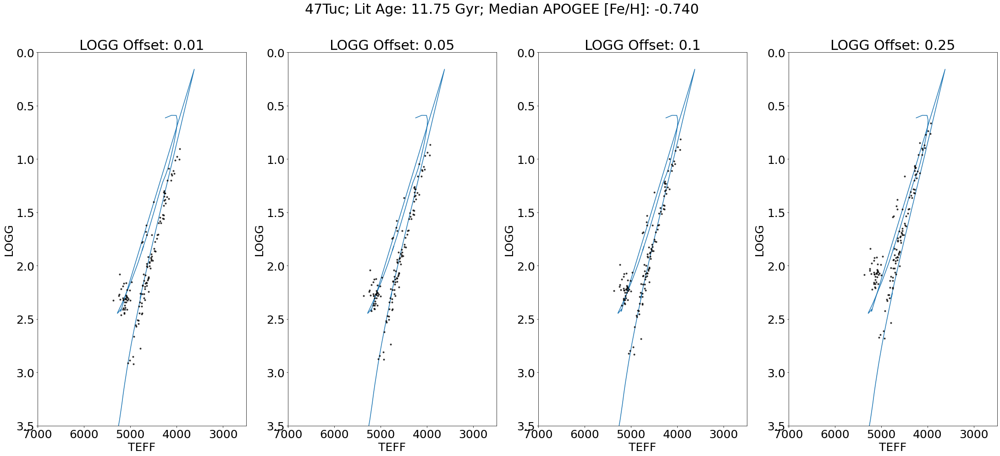

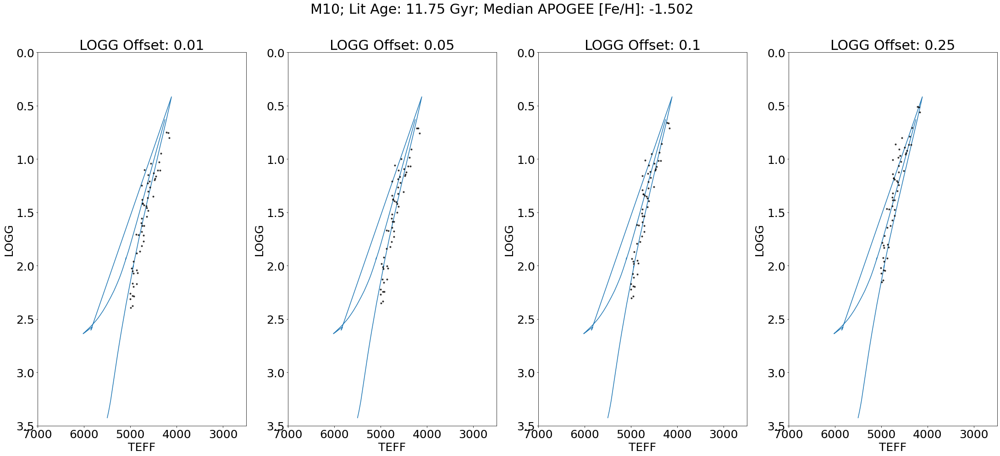

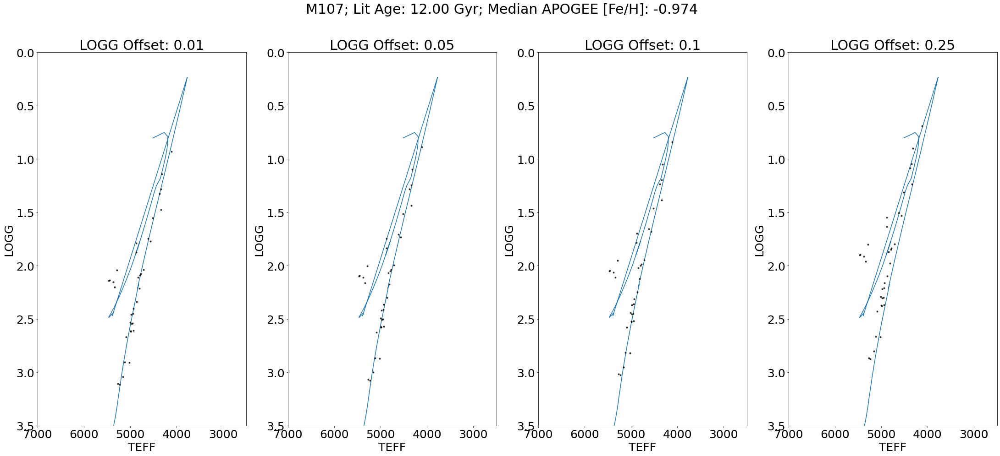

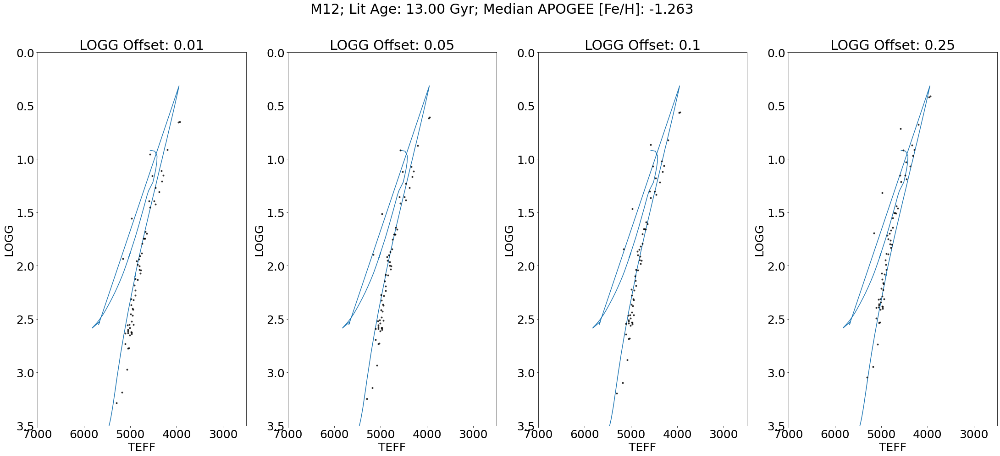

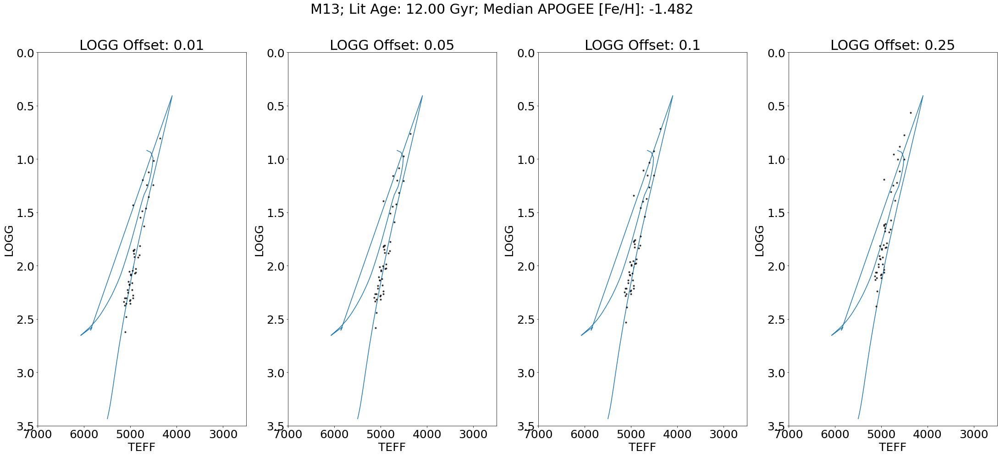

...

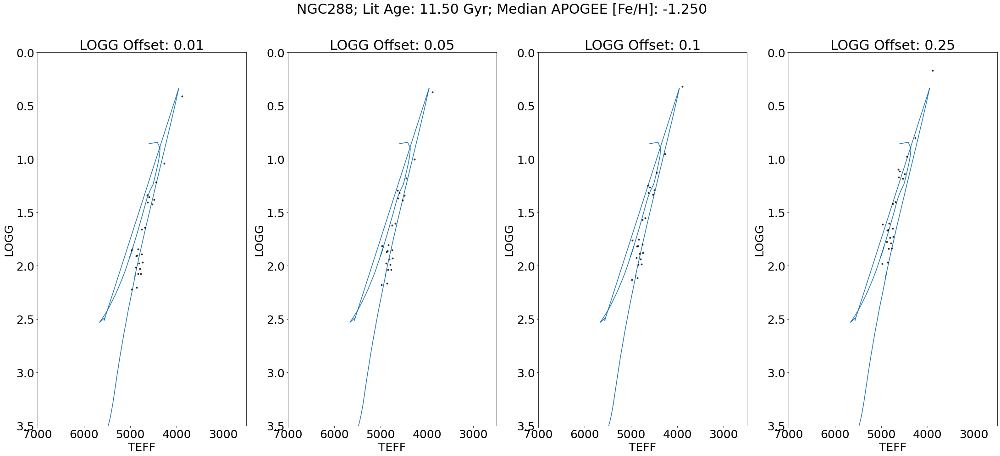

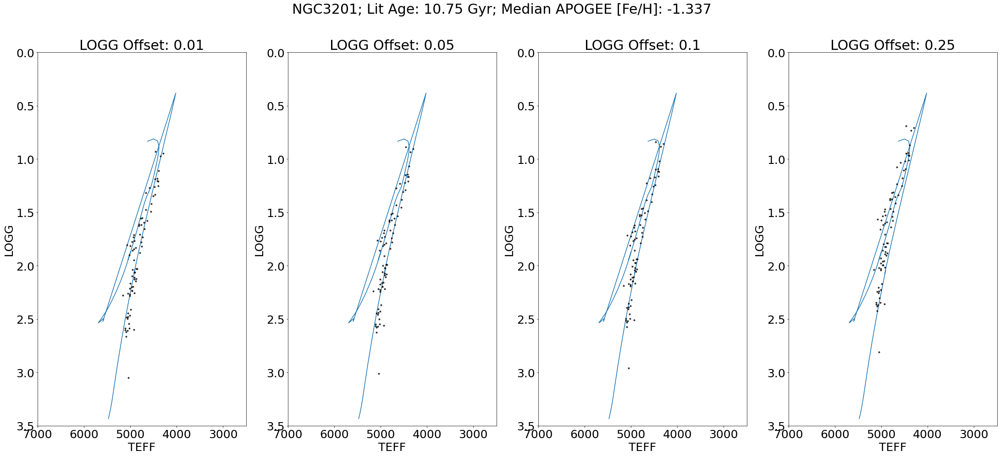

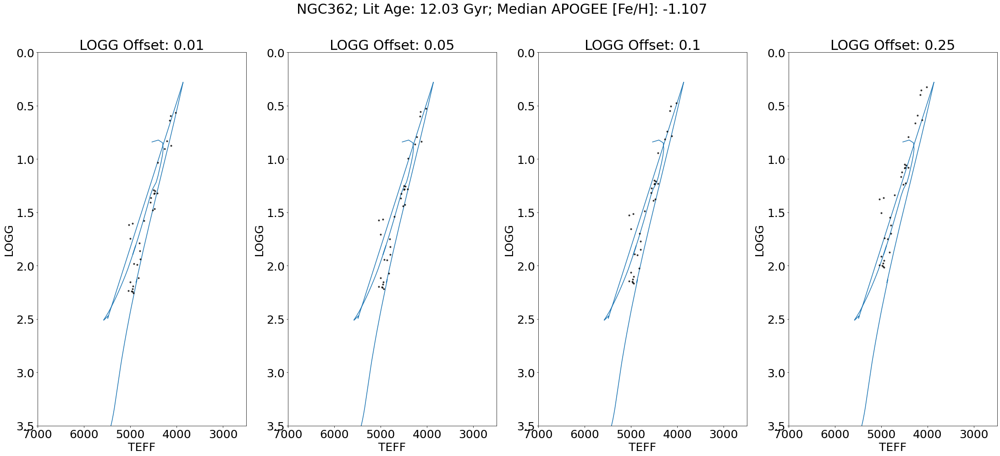

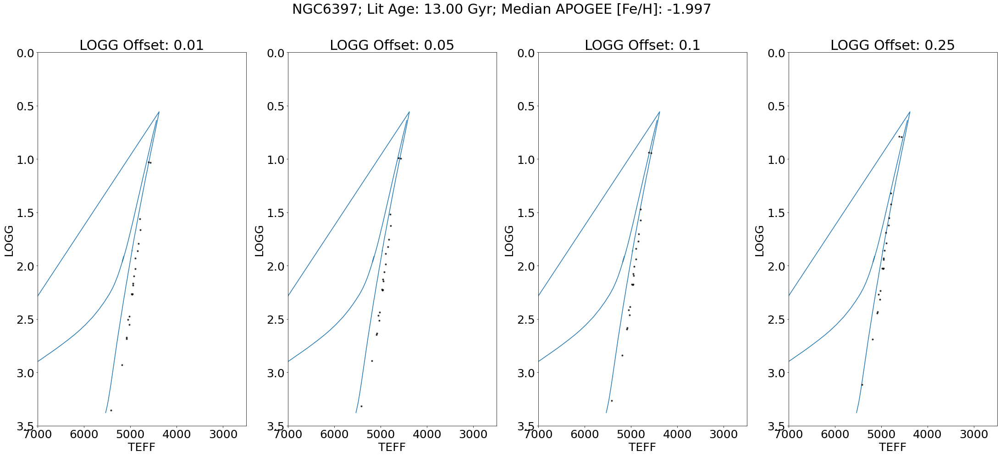

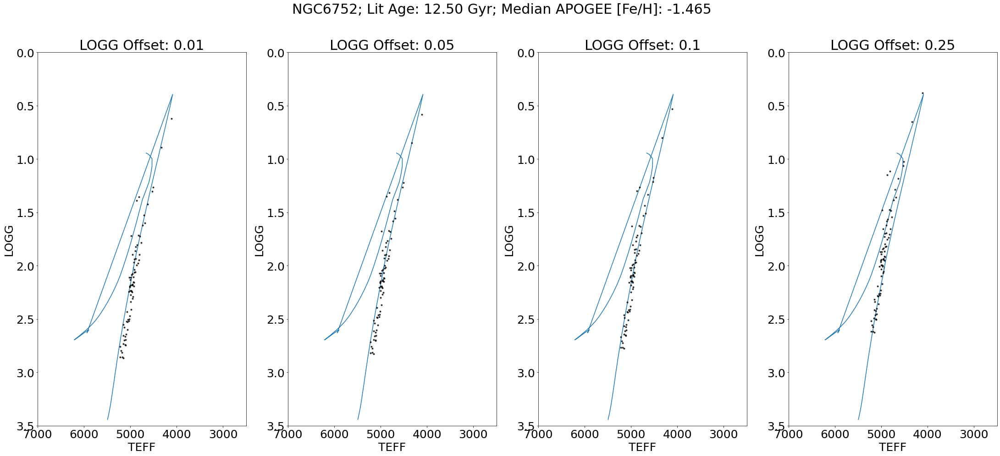

In [209]:
for i in range(len(gcs_clus)):
    clus = np.where(gcs['CLUSTER']==gcs_clus[i])
    isopick1 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(gcsdr17['FE_H'][clus])))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    fig, ax = plt.subplots(1,4,figsize=[37.5,15])

    ax[0].plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],zorder=0)
    ax[0].set_title(r'LOGG Offset: 0.01')
    ax[0].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus]-0.01,c='k',marker='.',zorder=1,alpha=0.75)
    ax[0].set_xlabel(r'TEFF')
    ax[0].set_ylabel(r'LOGG')
    ax[0].set_ylim(0,3.5)
    ax[0].set_xlim(2500,7000)
    ax[0].invert_yaxis()
    ax[0].invert_xaxis()
    
    ax[1].plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],zorder=0)
    ax[1].set_title(r'LOGG Offset: 0.05')
    ax[1].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus]-0.05,c='k',marker='.',zorder=1,alpha=0.75)
    ax[1].set_xlabel(r'TEFF')
    ax[1].set_ylabel(r'LOGG')
    ax[1].set_ylim(0,3.5)
    ax[1].set_xlim(2500,7000)
    ax[1].invert_yaxis()
    ax[1].invert_xaxis()
    
    ax[2].plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],zorder=0)
    ax[2].set_title(r'LOGG Offset: 0.1')
    ax[2].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus]-0.1,c='k',marker='.',zorder=1,alpha=0.75)
    ax[2].set_xlabel(r'TEFF')
    ax[2].set_ylabel(r'LOGG')
    ax[2].set_ylim(0,3.5)
    ax[2].set_xlim(2500,7000)
    ax[2].invert_yaxis()
    ax[2].invert_xaxis()
    
    ax[3].plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],zorder=0)
    ax[3].set_title(r'LOGG Offset: 0.25')
    ax[3].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus]-0.25,c='k',marker='.',zorder=1,alpha=0.75)
    ax[3].set_xlabel(r'TEFF')
    ax[3].set_ylabel(r'LOGG')
    ax[3].set_ylim(0,3.5)
    ax[3].set_xlim(2500,7000)
    ax[3].invert_yaxis()
    ax[3].invert_xaxis()
    
    plt.suptitle(r'{}; Lit Age: {:.2f} Gyr; Median APOGEE [Fe/H]: {:.3f}'.format(gcs_clus[i],gcs_ages[i],
                                                               np.nanmedian(gcsdr17['FE_H'][clus])))
    plt.savefig('{}LOGGSideBySideDR17.pdf'.format(gcs_clus[i]),bbox_inches='tight')
    plt.show()

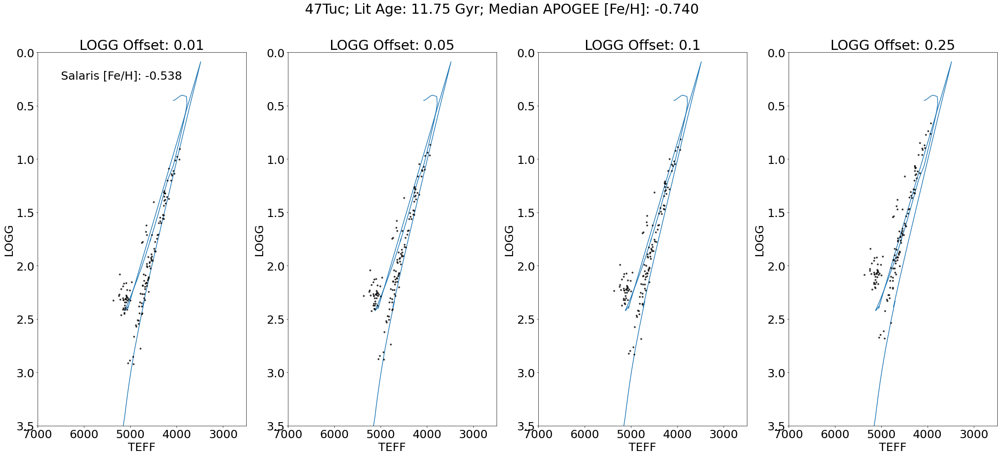

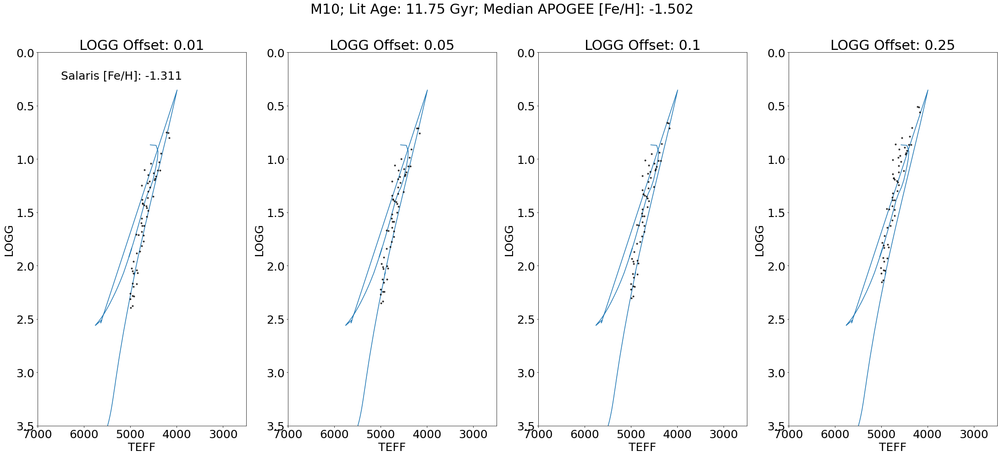

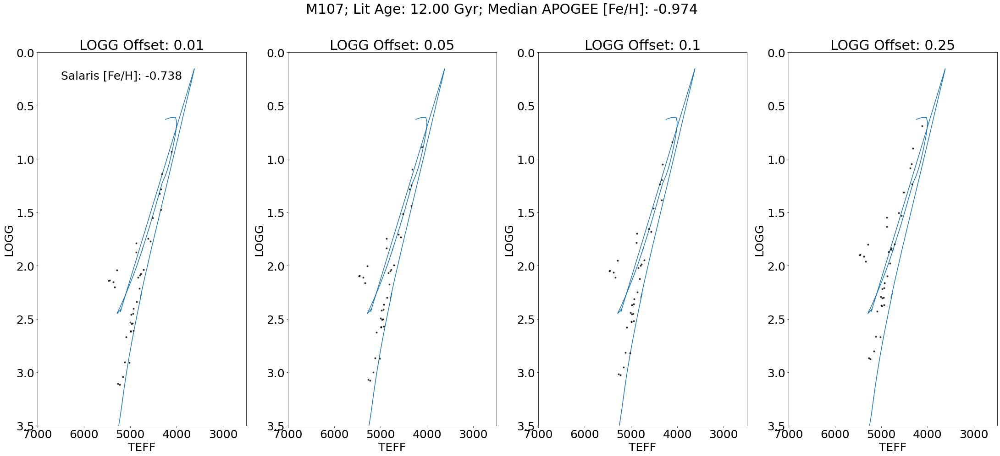

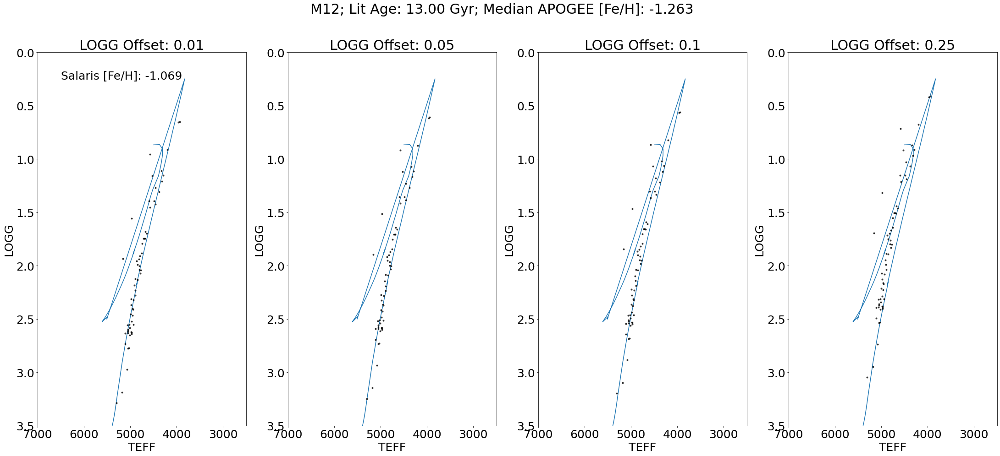

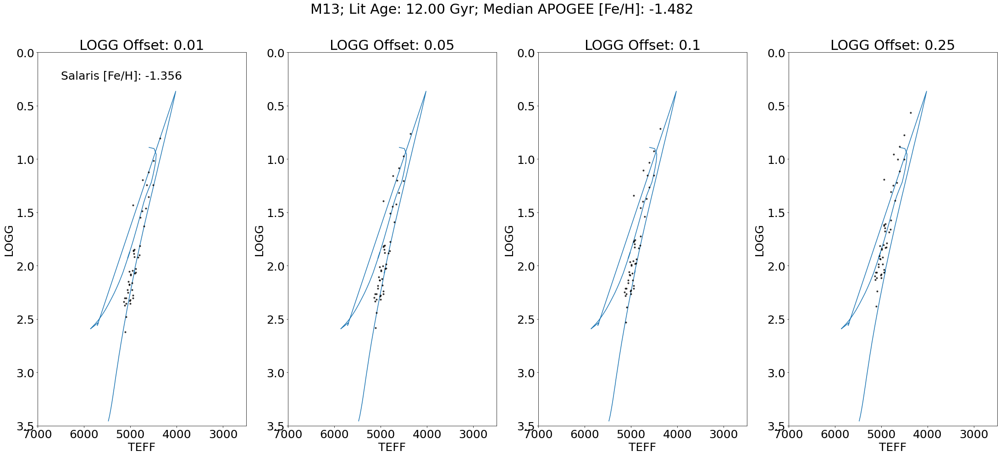

...

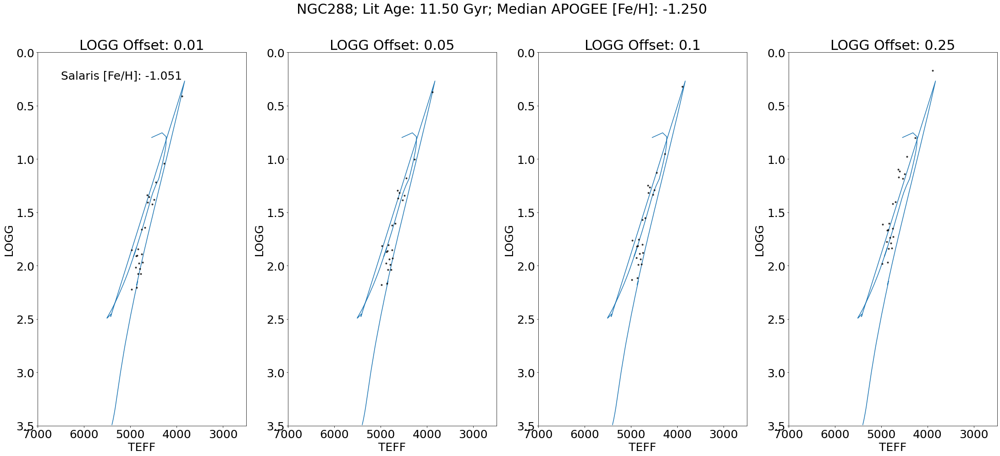

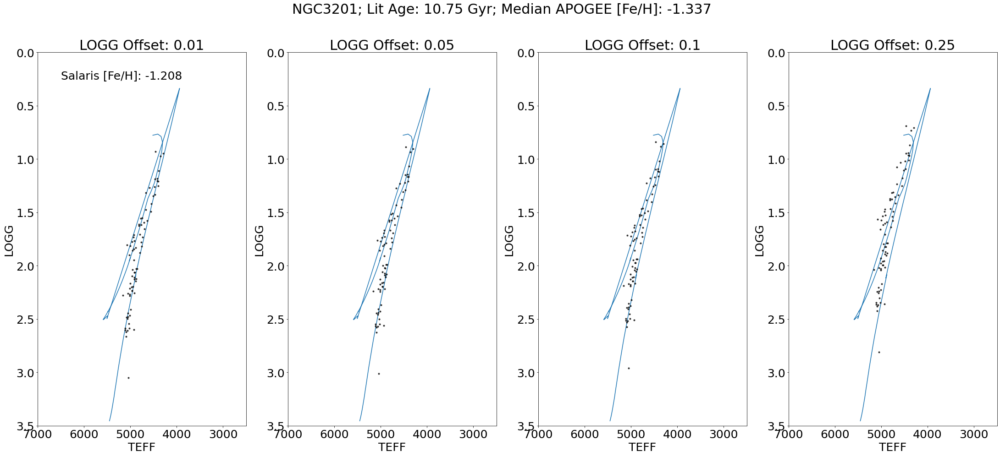

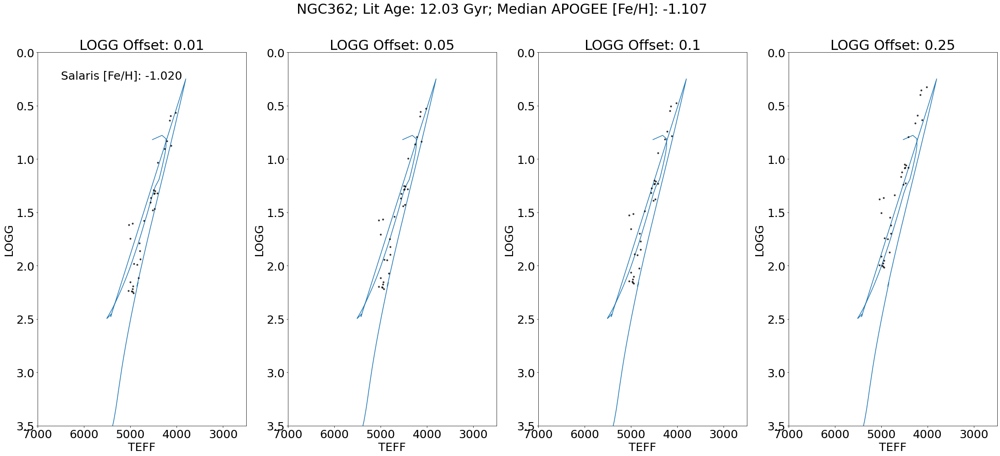

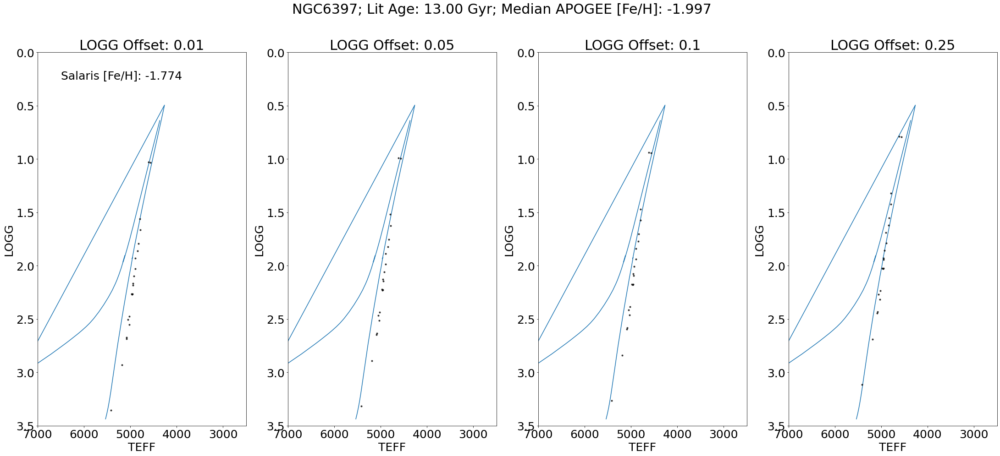

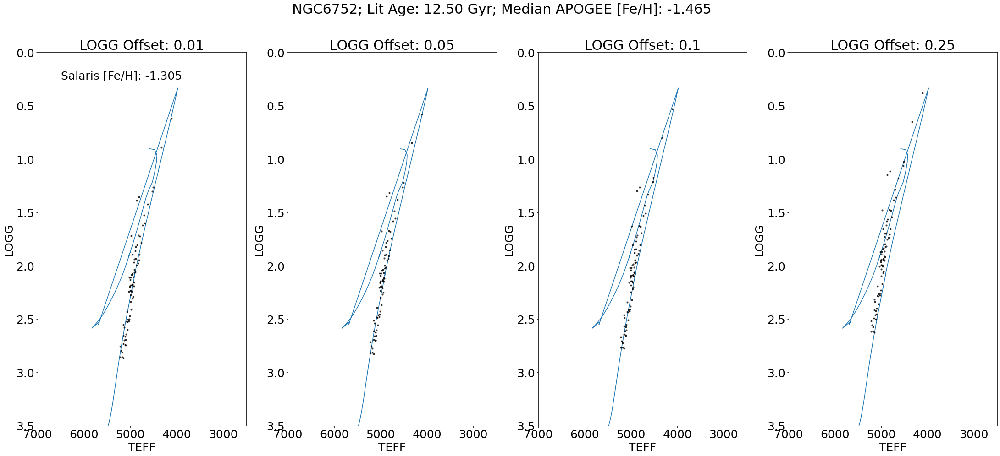

In [210]:
### With Salaris
for i in range(len(gcs_clus)):
    clus = np.where(gcs['CLUSTER']==gcs_clus[i])
    isopick1 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(gcsdr17['M_H'][clus])+
                                               np.log10(0.638*(10**np.nanmedian(gcsdr17['ALPHA_M'][clus]))+0.362)))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    fig, ax = plt.subplots(1,4,figsize=[37.5,15])

    ax[0].plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],zorder=0)
    ax[0].text(6500,0.25,
               r'Salaris [Fe/H]: {:.3f}'.format(np.nanmedian(gcsdr17['M_H'][clus])+
                                                np.log10(0.638*(10**np.nanmedian(gcsdr17['ALPHA_M'][clus]))+0.362)))
    ax[0].set_title(r'LOGG Offset: 0.01')
    ax[0].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus]-0.01,c='k',marker='.',zorder=1,alpha=0.75)
    ax[0].set_xlabel(r'TEFF')
    ax[0].set_ylabel(r'LOGG')
    ax[0].set_ylim(0,3.5)
    ax[0].set_xlim(2500,7000)
    ax[0].invert_yaxis()
    ax[0].invert_xaxis()
    
    ax[1].plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],zorder=0)
    ax[1].set_title(r'LOGG Offset: 0.05')
    ax[1].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus]-0.05,c='k',marker='.',zorder=1,alpha=0.75)
    ax[1].set_xlabel(r'TEFF')
    ax[1].set_ylabel(r'LOGG')
    ax[1].set_ylim(0,3.5)
    ax[1].set_xlim(2500,7000)
    ax[1].invert_yaxis()
    ax[1].invert_xaxis()
    
    ax[2].plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],zorder=0)
    ax[2].set_title(r'LOGG Offset: 0.1')
    ax[2].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus]-0.1,c='k',marker='.',zorder=1,alpha=0.75)
    ax[2].set_xlabel(r'TEFF')
    ax[2].set_ylabel(r'LOGG')
    ax[2].set_ylim(0,3.5)
    ax[2].set_xlim(2500,7000)
    ax[2].invert_yaxis()
    ax[2].invert_xaxis()
    
    ax[3].plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],zorder=0)
    ax[3].set_title(r'LOGG Offset: 0.25')
    ax[3].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus]-0.25,c='k',marker='.',zorder=1,alpha=0.75)
    ax[3].set_xlabel(r'TEFF')
    ax[3].set_ylabel(r'LOGG')
    ax[3].set_ylim(0,3.5)
    ax[3].set_xlim(2500,7000)
    ax[3].invert_yaxis()
    ax[3].invert_xaxis()
    
    plt.suptitle(r'{}; Lit Age: {:.2f} Gyr; Median APOGEE [Fe/H]: {:.3f}'.format(gcs_clus[i],gcs_ages[i],
                                                               np.nanmedian(gcsdr17['FE_H'][clus])))
    plt.savefig('{}LOGGSalarisSideBySideDR17.pdf'.format(gcs_clus[i]),bbox_inches='tight')
    plt.show()

nan


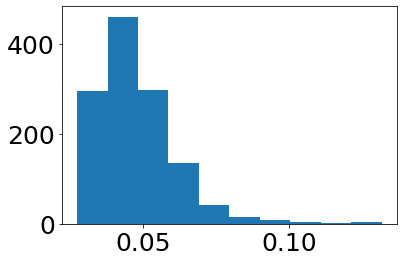

In [211]:
plt.hist(gcsdr17['LOGG_ERR'])
print(np.median(gcsdr17['LOGG_ERR']))

# Constant [Fe/H] Offset

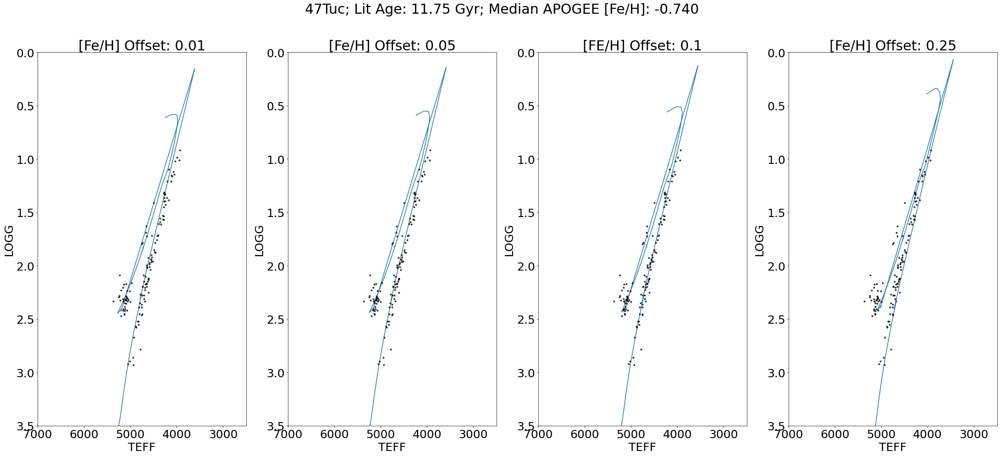

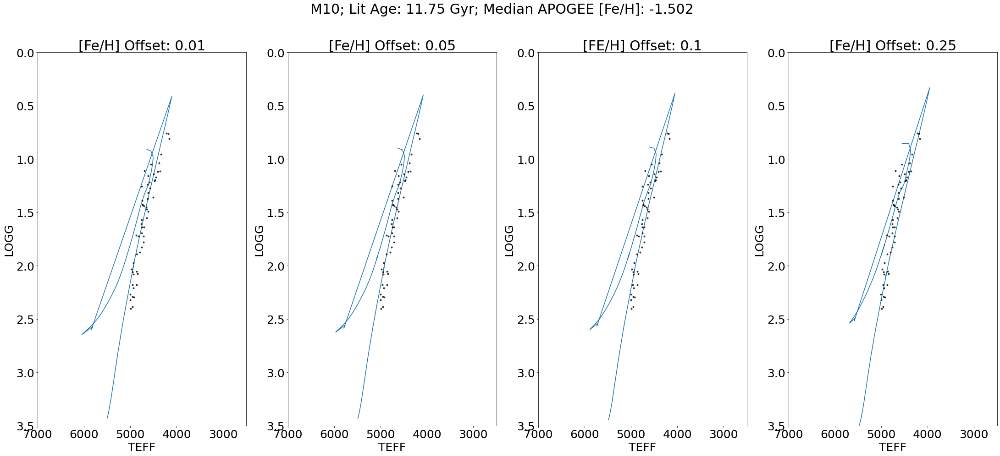

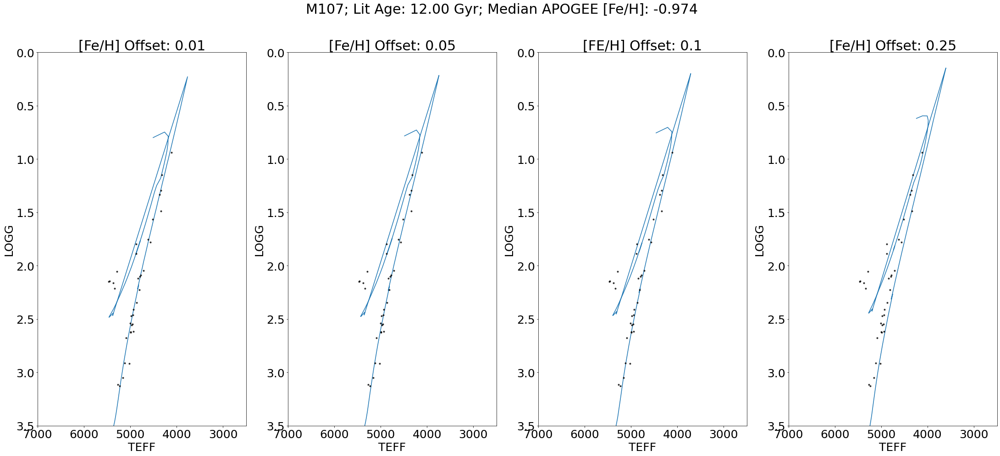

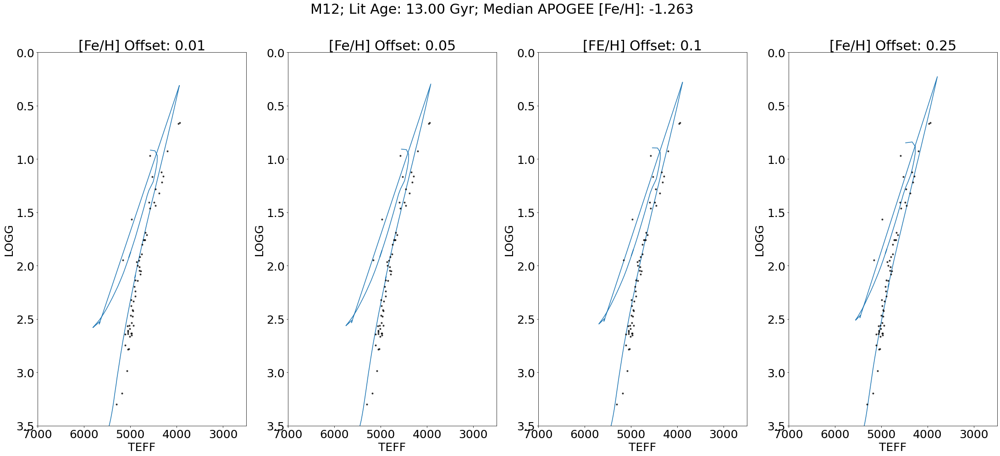

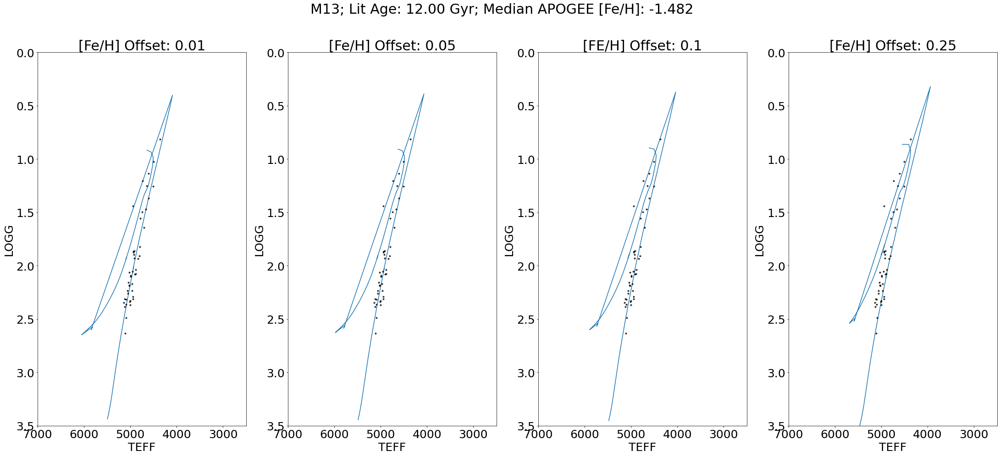

...

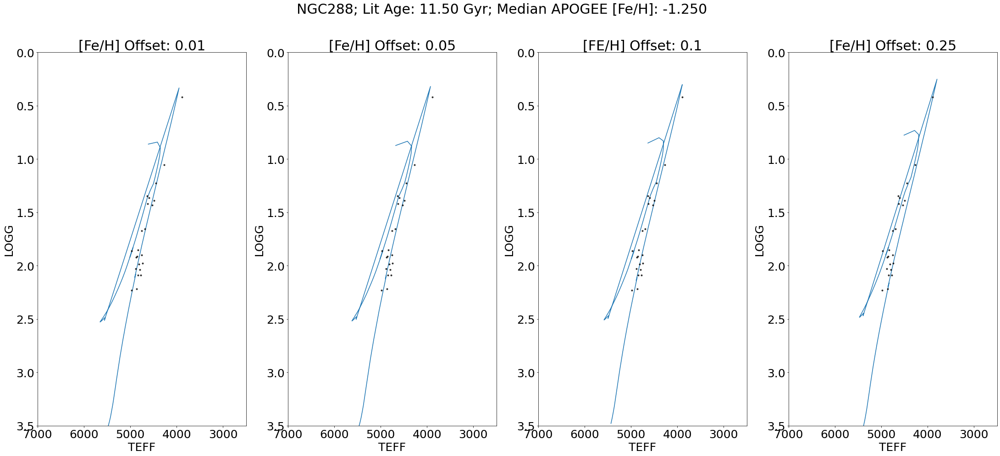

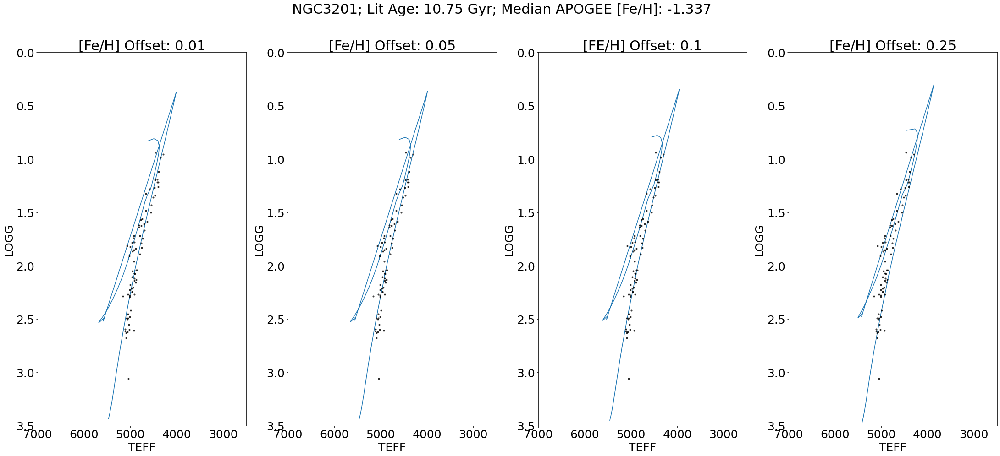

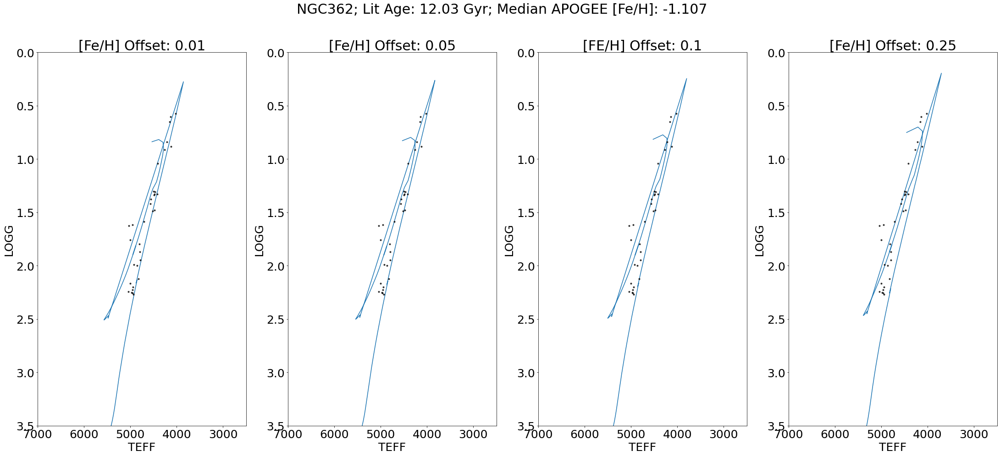

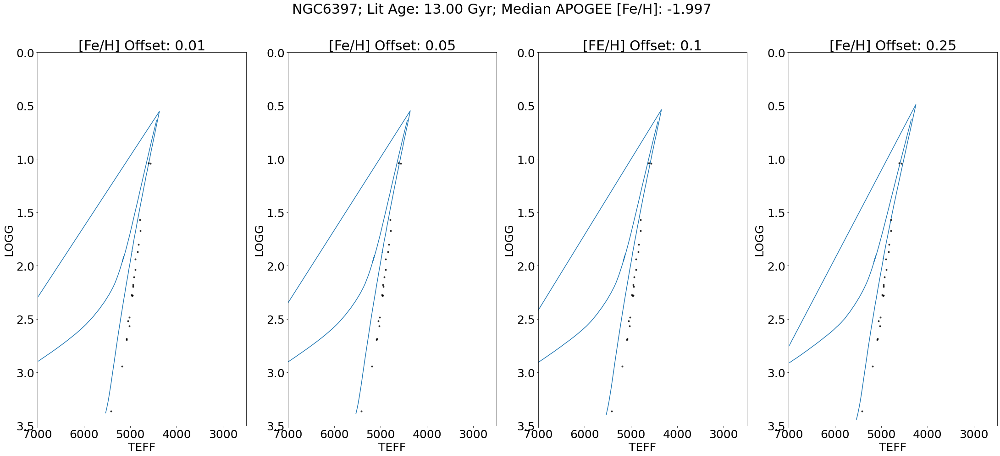

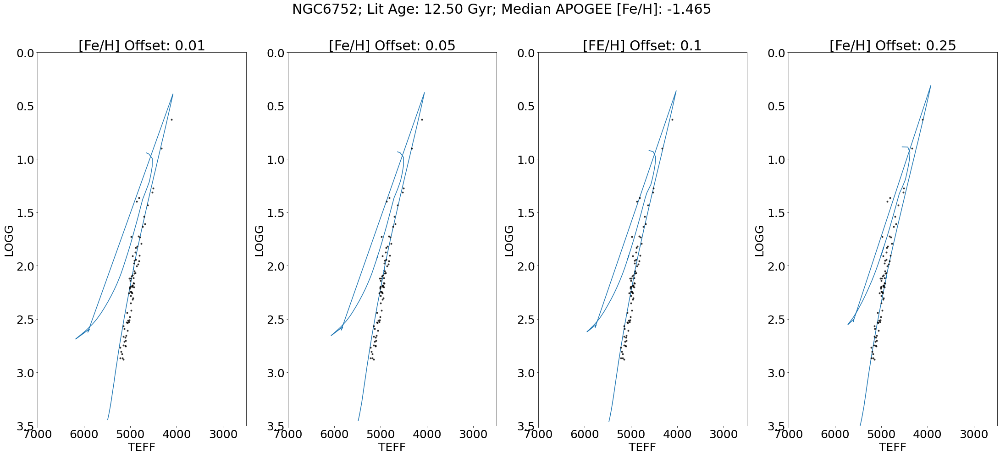

In [212]:
for i in range(len(gcs_clus)):
    clus = np.where(gcs['CLUSTER']==gcs_clus[i])
    isopick1 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(gcsdr17['FE_H'][clus])+0.01))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    isopick2 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(gcsdr17['FE_H'][clus])+0.05))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    isopick3 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(gcsdr17['FE_H'][clus])+0.10))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    isopick4 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(gcsdr17['FE_H'][clus])+0.25))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    fig, ax = plt.subplots(1,4,figsize=[37.5,15])

    ax[0].plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],zorder=0)
    ax[0].set_title(r'[Fe/H] Offset: 0.01')
    ax[0].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[0].set_xlabel(r'TEFF')
    ax[0].set_ylabel(r'LOGG')
    ax[0].set_ylim(0,3.5)
    ax[0].set_xlim(2500,7000)
    ax[0].invert_yaxis()
    ax[0].invert_xaxis()
    
    ax[1].plot(10**massive['logTe'][isopick2],massive['logg'][isopick2],zorder=0)
    ax[1].set_title(r'[Fe/H] Offset: 0.05')
    ax[1].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[1].set_xlabel(r'TEFF')
    ax[1].set_ylabel(r'LOGG')
    ax[1].set_ylim(0,3.5)
    ax[1].set_xlim(2500,7000)
    ax[1].invert_yaxis()
    ax[1].invert_xaxis()
    
    ax[2].plot(10**massive['logTe'][isopick3],massive['logg'][isopick3],zorder=0)
    ax[2].set_title(r'[FE/H] Offset: 0.1')
    ax[2].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[2].set_xlabel(r'TEFF')
    ax[2].set_ylabel(r'LOGG')
    ax[2].set_ylim(0,3.5)
    ax[2].set_xlim(2500,7000)
    ax[2].invert_yaxis()
    ax[2].invert_xaxis()
    
    ax[3].plot(10**massive['logTe'][isopick4],massive['logg'][isopick4],zorder=0)
    ax[3].set_title(r'[Fe/H] Offset: 0.25')
    ax[3].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[3].set_xlabel(r'TEFF')
    ax[3].set_ylabel(r'LOGG')
    ax[3].set_ylim(0,3.5)
    ax[3].set_xlim(2500,7000)
    ax[3].invert_yaxis()
    ax[3].invert_xaxis()
    
    plt.suptitle(r'{}; Lit Age: {:.2f} Gyr; Median APOGEE [Fe/H]: {:.3f}'.format(gcs_clus[i],gcs_ages[i],
                                                               np.nanmedian(gcsdr17['FE_H'][clus])))
    plt.savefig('{}FE_HSideBySideDR17.pdf'.format(gcs_clus[i]),bbox_inches='tight')
    plt.show()

nan


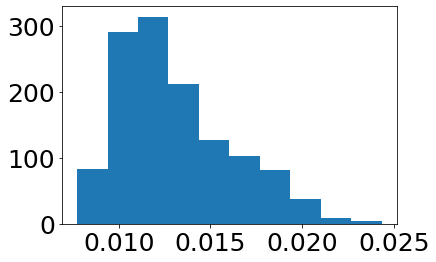

In [213]:
plt.hist(gcsdr17['FE_H_ERR'])
print(np.median(gcsdr17['FE_H_ERR']))

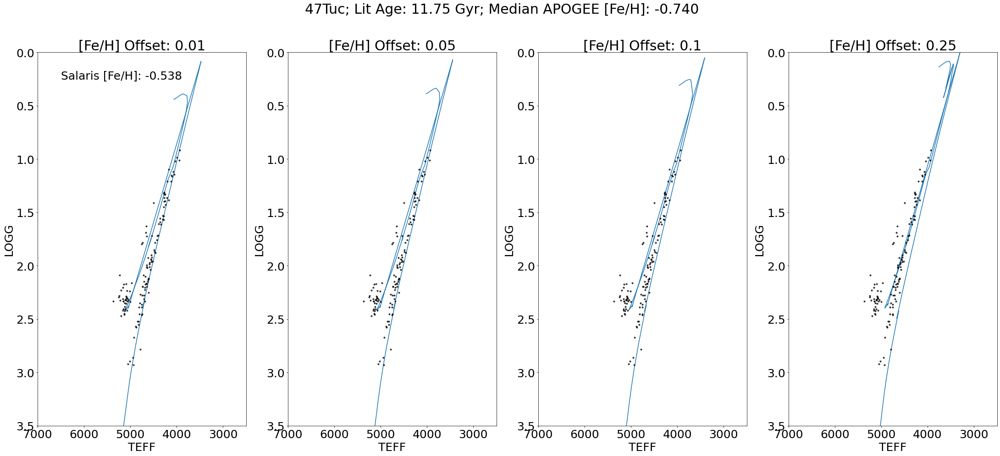

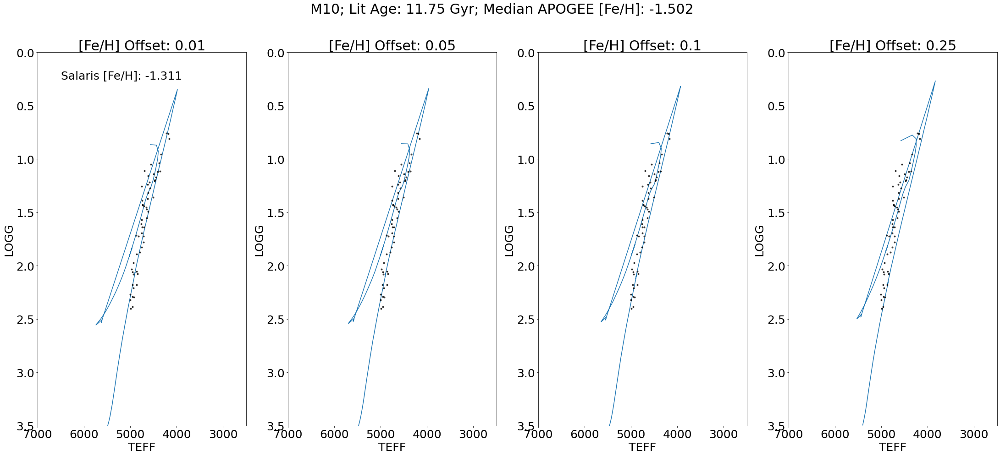

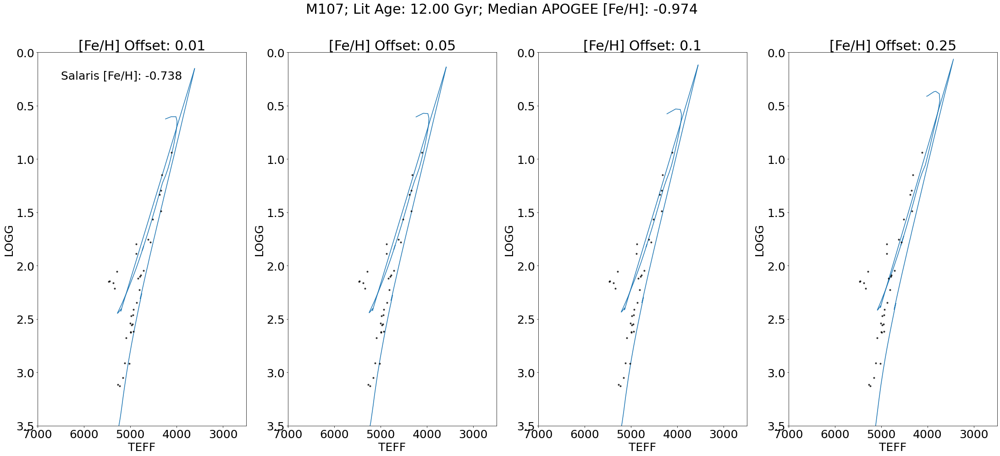

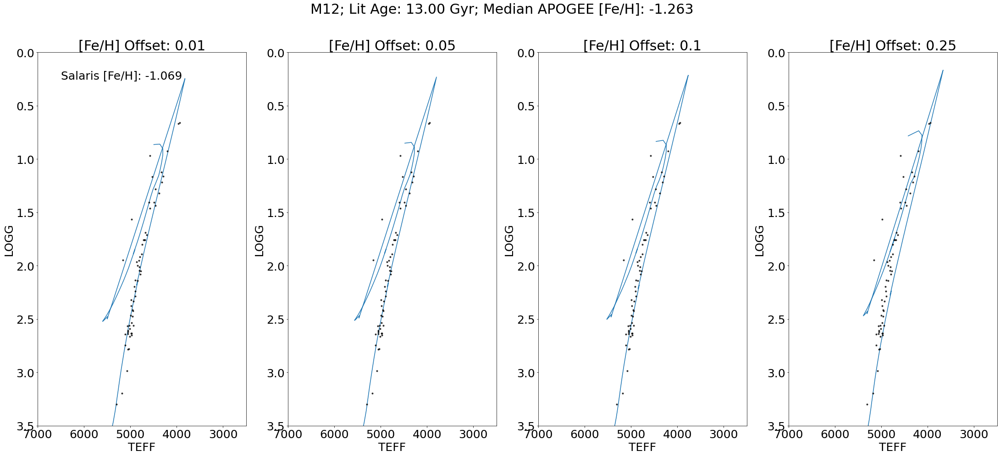

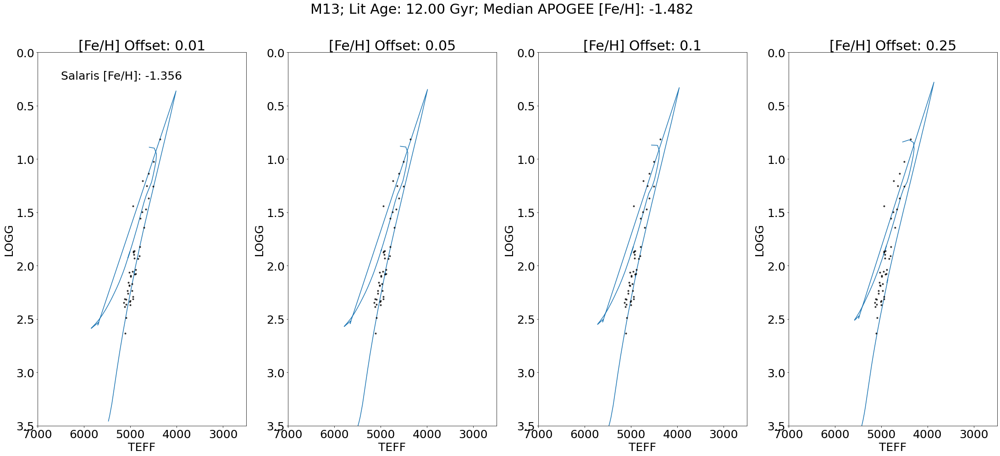

...

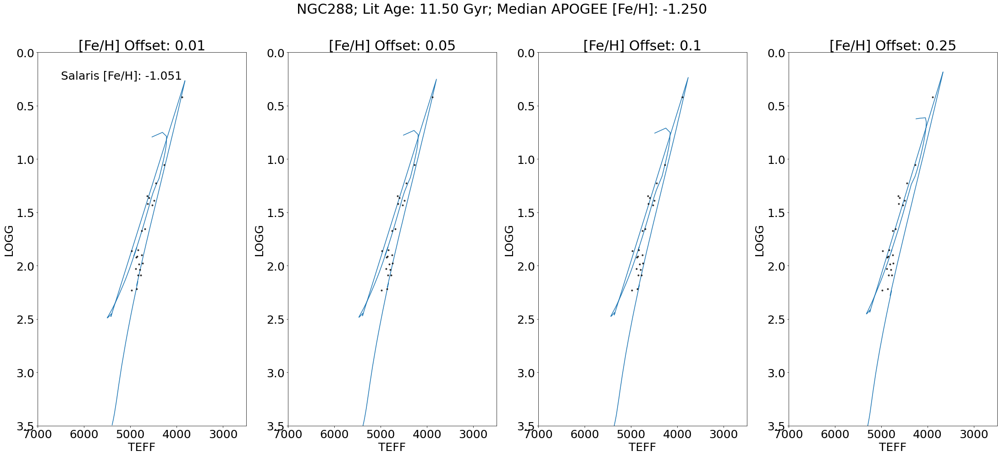

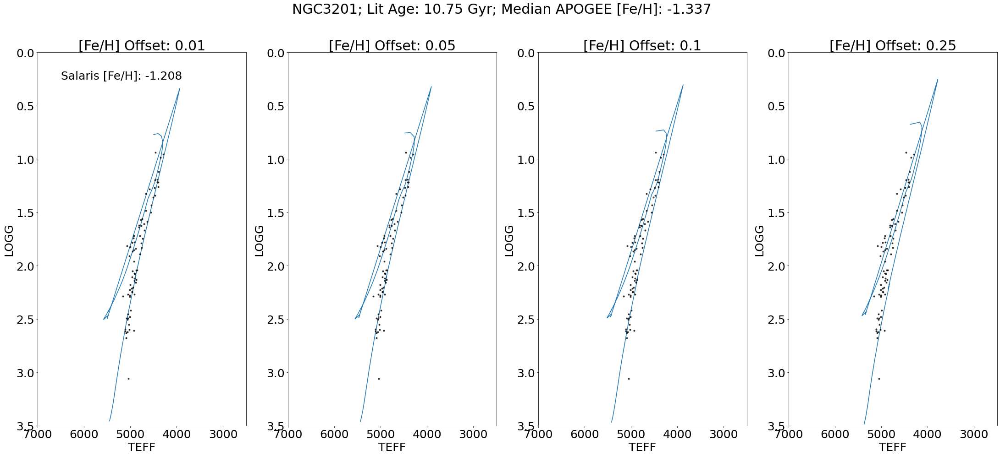

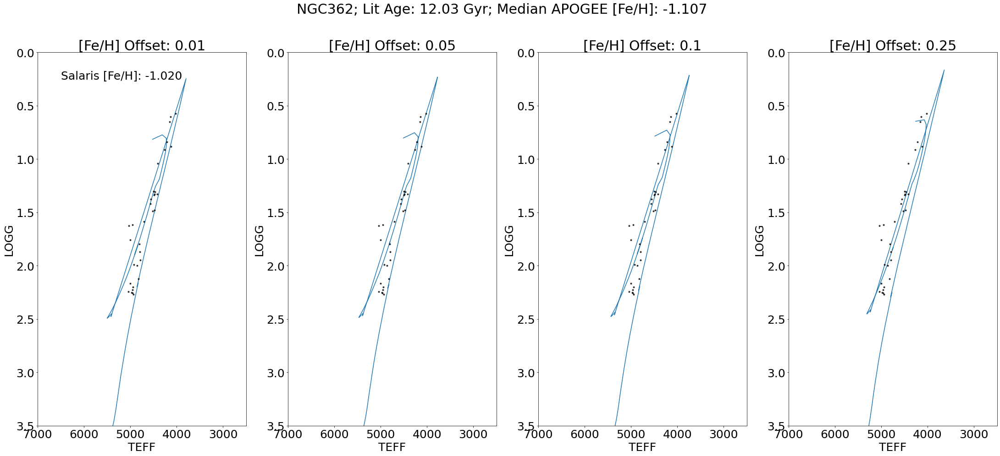

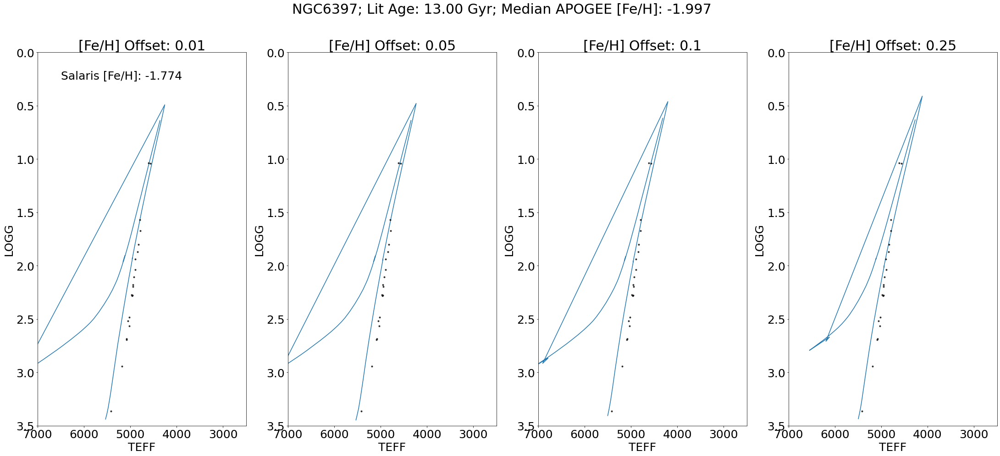

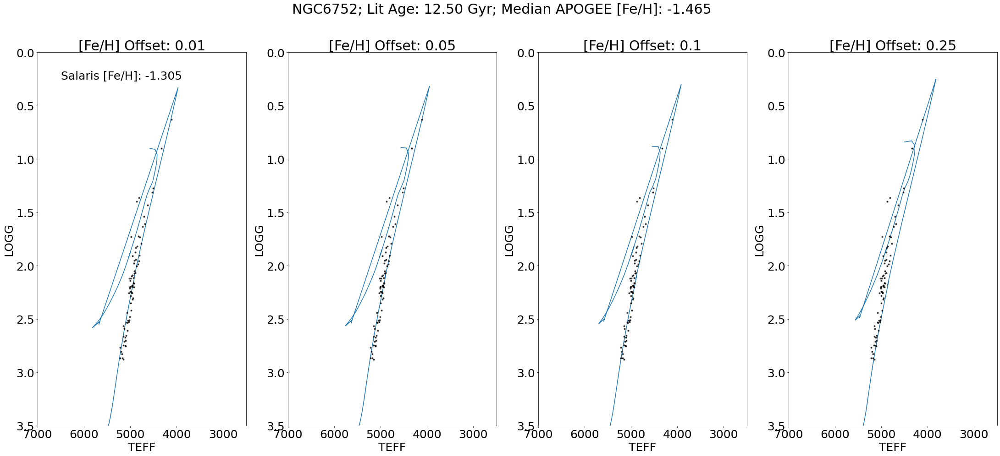

In [214]:
for i in range(len(gcs_clus)):
    clus = np.where(gcs['CLUSTER']==gcs_clus[i])
    isopick1 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(gcsdr17['M_H'][clus])+0.01+
                                               np.log10(0.638*(10**np.nanmedian(gcsdr17['ALPHA_M'][clus]))+0.362)))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    isopick2 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(gcsdr17['M_H'][clus])+0.05+
                                               np.log10(0.638*(10**np.nanmedian(gcsdr17['ALPHA_M'][clus]))+0.362)))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    isopick3 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(gcsdr17['M_H'][clus])+0.10+
                                               np.log10(0.638*(10**np.nanmedian(gcsdr17['ALPHA_M'][clus]))+0.362)))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    isopick4 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(gcsdr17['M_H'][clus])+0.25+
                                               np.log10(0.638*(10**np.nanmedian(gcsdr17['ALPHA_M'][clus]))+0.362)))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    fig, ax = plt.subplots(1,4,figsize=[37.5,15])

    ax[0].plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],zorder=0)
    ax[0].text(6500,0.25,
               r'Salaris [Fe/H]: {:.3f}'.format(np.nanmedian(gcsdr17['M_H'][clus])+
                                                np.log10(0.638*(10**np.nanmedian(gcsdr17['ALPHA_M'][clus]))+0.362)))
    ax[0].set_title(r'[Fe/H] Offset: 0.01')
    ax[0].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[0].set_xlabel(r'TEFF')
    ax[0].set_ylabel(r'LOGG')
    ax[0].set_ylim(0,3.5)
    ax[0].set_xlim(2500,7000)
    ax[0].invert_yaxis()
    ax[0].invert_xaxis()
    
    ax[1].plot(10**massive['logTe'][isopick2],massive['logg'][isopick2],zorder=0)
    ax[1].set_title(r'[Fe/H] Offset: 0.05')
    ax[1].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[1].set_xlabel(r'TEFF')
    ax[1].set_ylabel(r'LOGG')
    ax[1].set_ylim(0,3.5)
    ax[1].set_xlim(2500,7000)
    ax[1].invert_yaxis()
    ax[1].invert_xaxis()
    
    ax[2].plot(10**massive['logTe'][isopick3],massive['logg'][isopick3],zorder=0)
    ax[2].set_title(r'[Fe/H] Offset: 0.1')
    ax[2].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[2].set_xlabel(r'TEFF')
    ax[2].set_ylabel(r'LOGG')
    ax[2].set_ylim(0,3.5)
    ax[2].set_xlim(2500,7000)
    ax[2].invert_yaxis()
    ax[2].invert_xaxis()
    
    ax[3].plot(10**massive['logTe'][isopick4],massive['logg'][isopick4],zorder=0)
    ax[3].set_title(r'[Fe/H] Offset: 0.25')
    ax[3].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[3].set_xlabel(r'TEFF')
    ax[3].set_ylabel(r'LOGG')
    ax[3].set_ylim(0,3.5)
    ax[3].set_xlim(2500,7000)
    ax[3].invert_yaxis()
    ax[3].invert_xaxis()
    
    plt.suptitle(r'{}; Lit Age: {:.2f} Gyr; Median APOGEE [Fe/H]: {:.3f}'.format(gcs_clus[i],gcs_ages[i],
                                                               np.nanmedian(gcsdr17['FE_H'][clus])))
    plt.savefig('{}FE_HSalarisSideBySideDR17.pdf'.format(gcs_clus[i]),bbox_inches='tight')
    plt.show()

In [13]:
medapofeh = [] 
for i in range(len(gcs_clus)):
    clus = np.where(gcs['CLUSTER']==gcs_clus[i])
    print('{} {:.3f}'.format(gcs_clus[i],np.nanmedian(gcsdr17['FE_H'][clus])))
    medapofeh.append(np.nanmedian(gcsdr17['FE_H'][clus]))
    
medapofeh = np.asarray(medapofeh)

NameError: name 'gcs_clus' is not defined

In [11]:
harrisfeh = np.array([-0.72,-1.56,-1.02,-1.37,-1.53,-1.74,-1.65,-1.70,-1.50,-1.16,-1.29,-2.27,-1.49,-1.94,-0.78,
                      -1.60,-1.81,-1.14,-1.32,-1.59,-1.62,-2.02,-1.54])

vandenfeh = np.array([-0.76,-1.57,-1.03,-1.33,-1.58,-1.53,-1.66,-1.70,-1.50,-1.18,-1.33,-2.06,-1.44,-1.93,-0.82,
                      -1.60,-1.18,-1.18,-1.32,-1.51,-1.30,-1.99,-1.55])



In [16]:
# print('Harris-APOGEE',np.median(harrisfeh-medapofeh))
# print('VandenBerg-APOGEE',np.median(vandenfeh-medapofeh))

print(np.mean([-0.08704999923706058,-0.084500002861023]))
print(np.median([-0.08704999923706058,-0.084500002861023]))

-0.08577500104904179
-0.08577500104904179


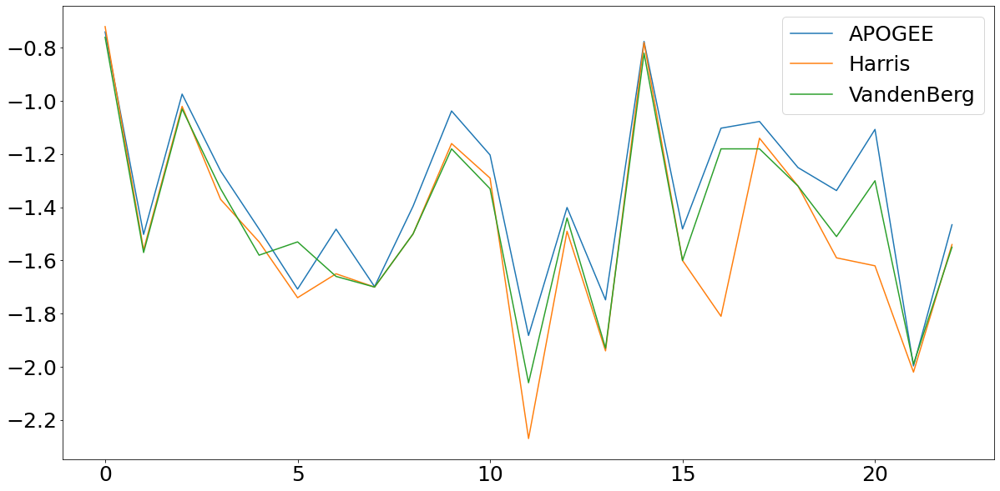

In [229]:
plt.figure(figsize=[20,10])
plt.plot(medapofeh,label='APOGEE')
plt.plot(harrisfeh,label='Harris')
plt.plot(vandenfeh,label='VandenBerg')
plt.legend()
plt.show()

In [ ]:
leave agb assume rgb what happens with ages

In [9]:
import numpy as np
# C,N,O,Mg,Si,S,Ca,Ti
hydro_weigh = 1.008
alphacn_sol = np.array([8.43,7.83,8.69,7.60,7.51,7.12,6.34,4.95])
atomic_wgts = np.array([12.011,14.007,15.999,24.305,28.085,32.06,40.078,47.867])

sal_a = sum(10**(alphacn_sol-12.00)*(atomic_wgts/hydro_weigh)*(1/0.0181))
sal_b = 1-sal_a

# print(sal_a)
# print(sal_b)
print(str.format('{0:.17f}', sal_a))
print(str.format('{0:.17f}', sal_b))

0.78963627131196057
0.21036372868803943


In [240]:
fac_acn = np.array([])
for i in range(len(gcs)):
    xfe = np.array([gcsdr17['C_FE'][i],gcsdr17['N_FE'][i],gcsdr17['O_FE'][i],gcsdr17['MG_FE'][i],gcsdr17['SI_FE'][i],gcsdr17['S_FE'][i],
                    gcsdr17['CA_FE'][i],gcsdr17['TI_FE'][i]])
    
    for j in range(len(xfe)):
        if xfe[j] < -100.:
            xfe[j] = 0.0
    
    # Asplund et al. 2009
    # log epsilon_x: C,N,O,Mg,Si,S,Ca,Ti
    asplund = np.array([8.43,7.83,8.69,7.60,7.51,7.12,6.34,4.95])
    
    fac_acn = np.append(fac_acn,sum(10**(asplund+xfe))/sum(10**asplund))

(array([22., 38.,  6.,  3.,  2.,  0.,  0.,  0.,  0.,  1.]),
 array([-1.41027399, -1.30593214, -1.20159028, -1.09724843, -0.99290658,
        -0.88856472, -0.78422287, -0.67988102, -0.57553917, -0.47119731,
        -0.36685546]),
 <a list of 10 Patch objects>)

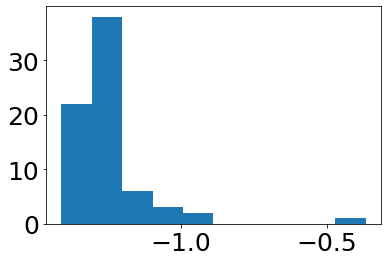

In [244]:
plt.hist((gcsdr17['FE_H']+np.log10(sal_a*fac_acn+sal_b))[clus])

In [241]:
asplund==alphacn_sol

array([ True,  True,  True,  True,  True,  True,  True,  True])

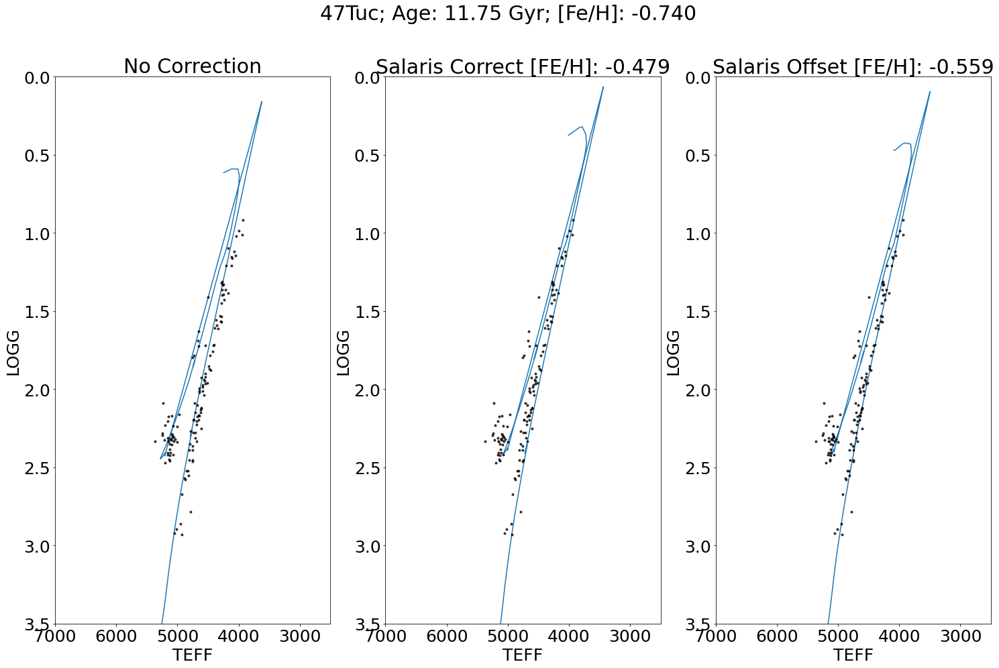

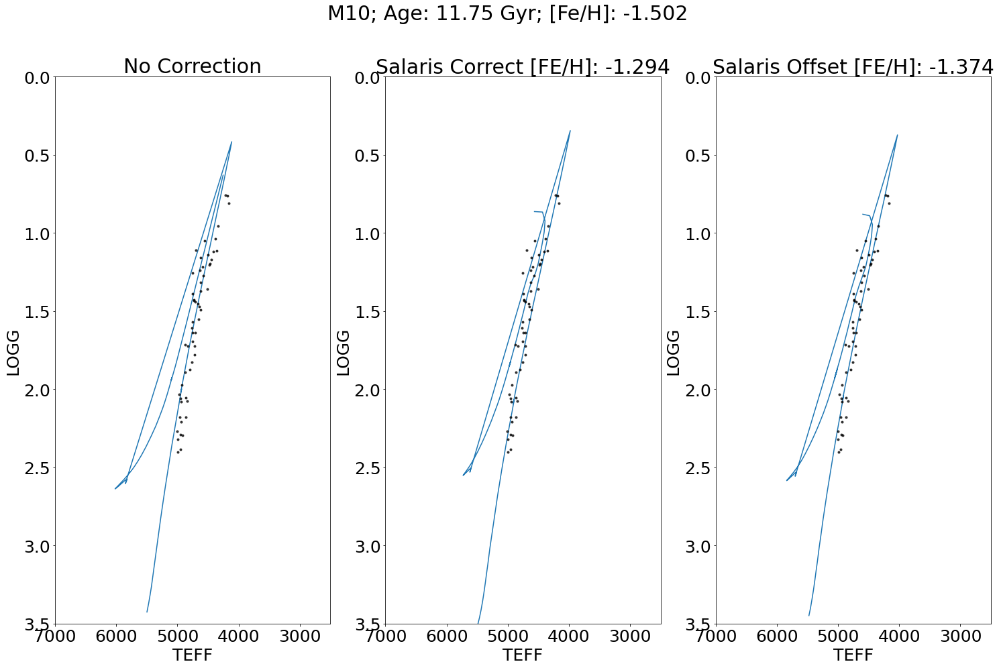

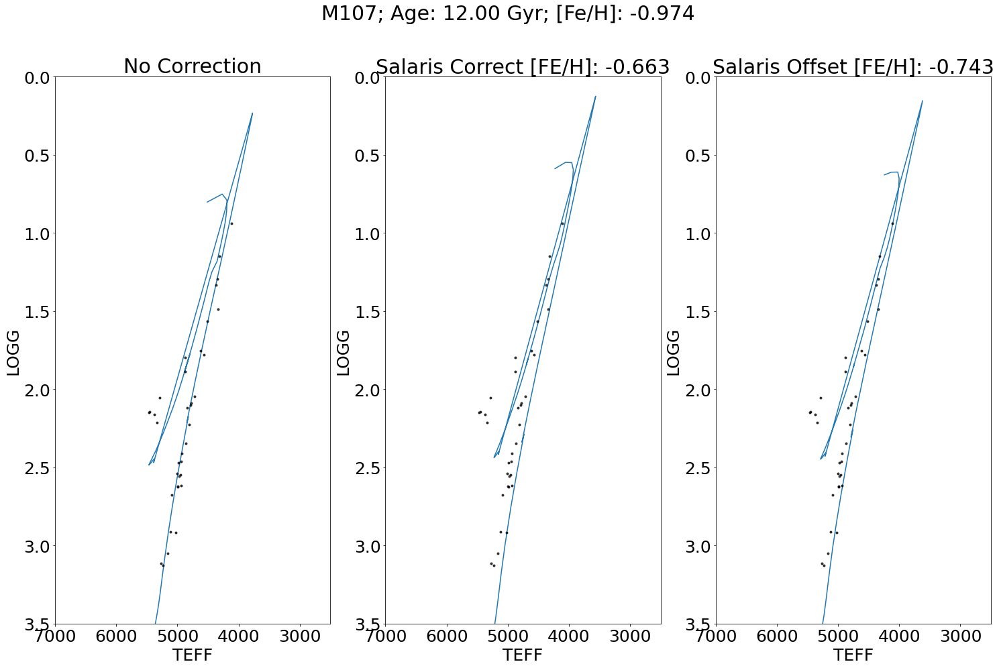

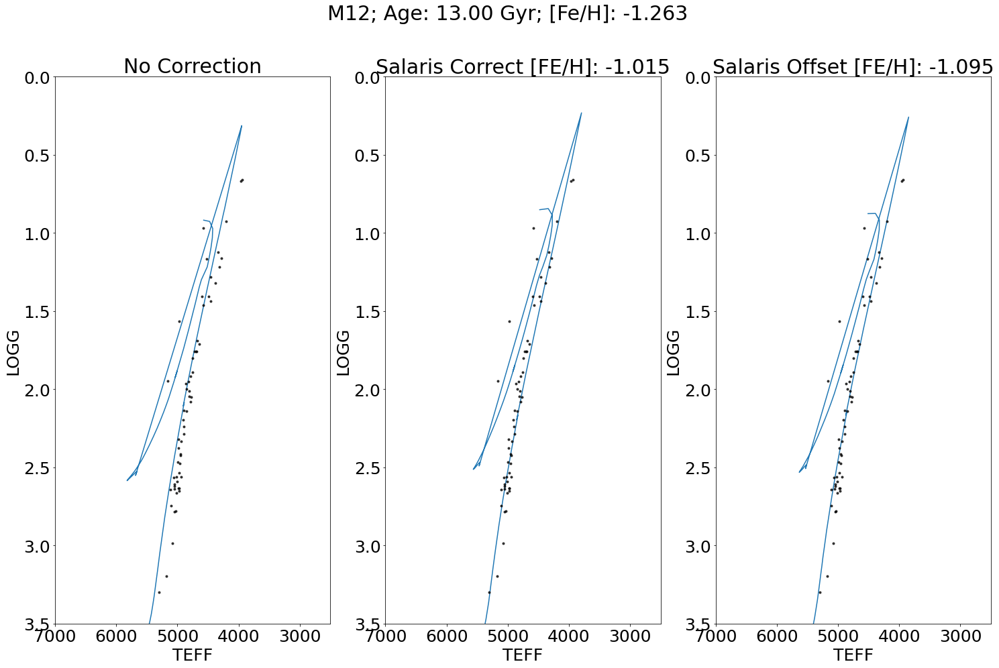

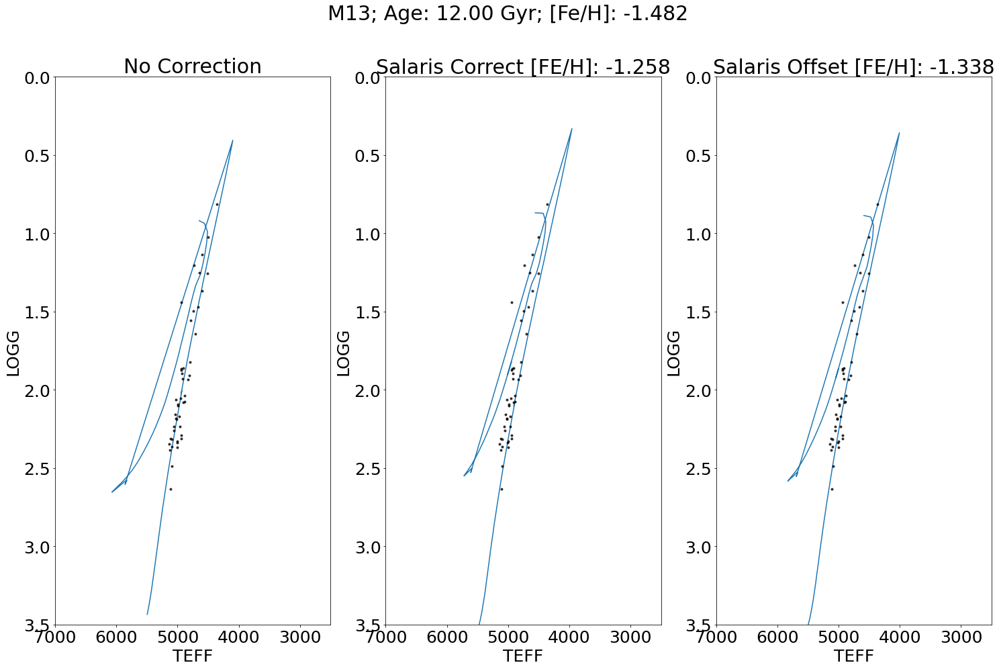

...

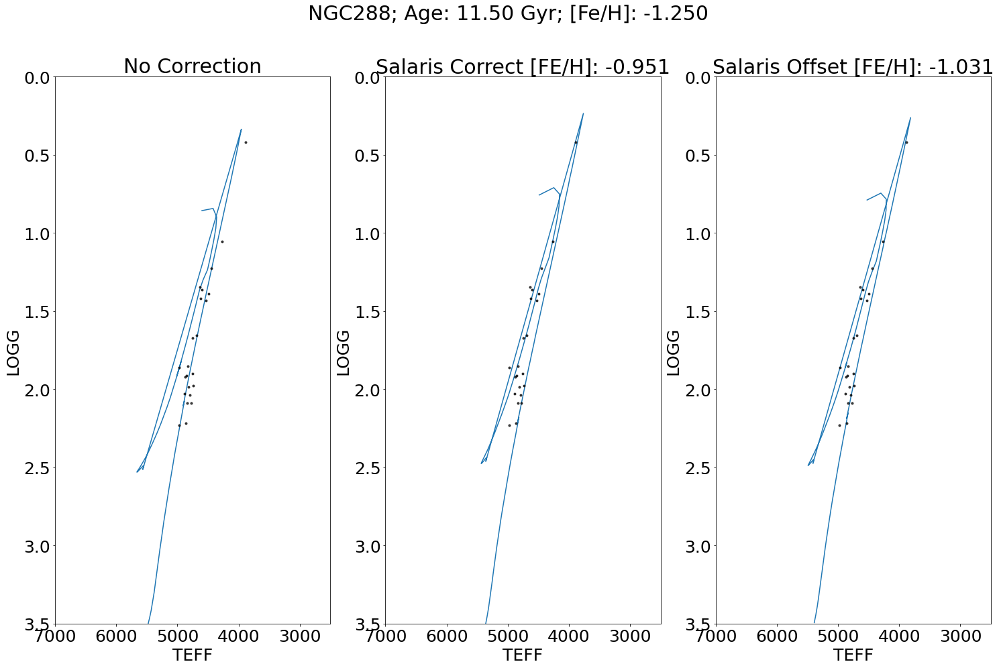

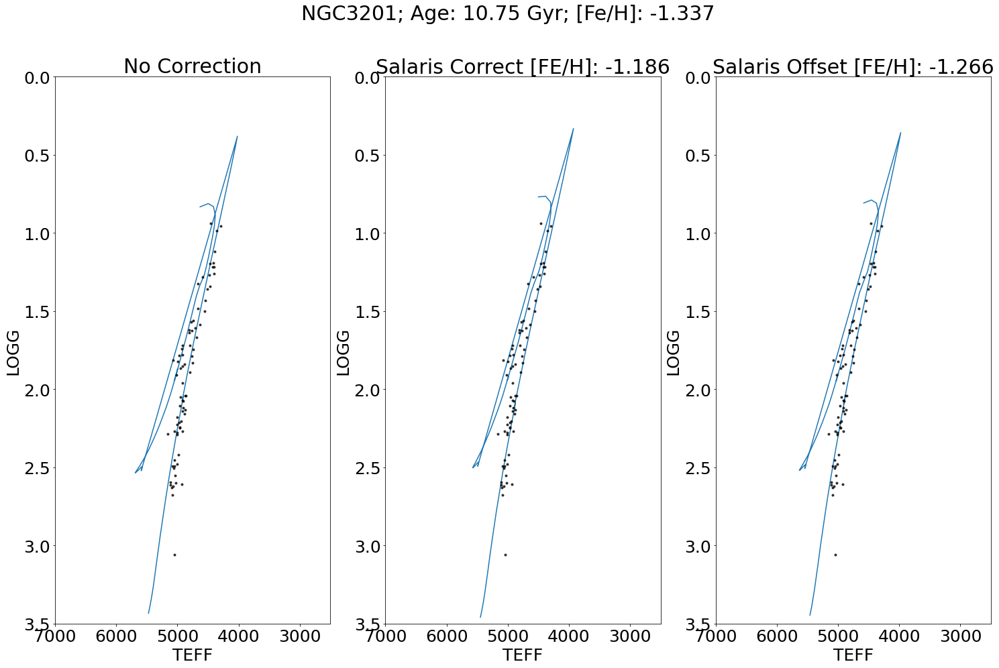

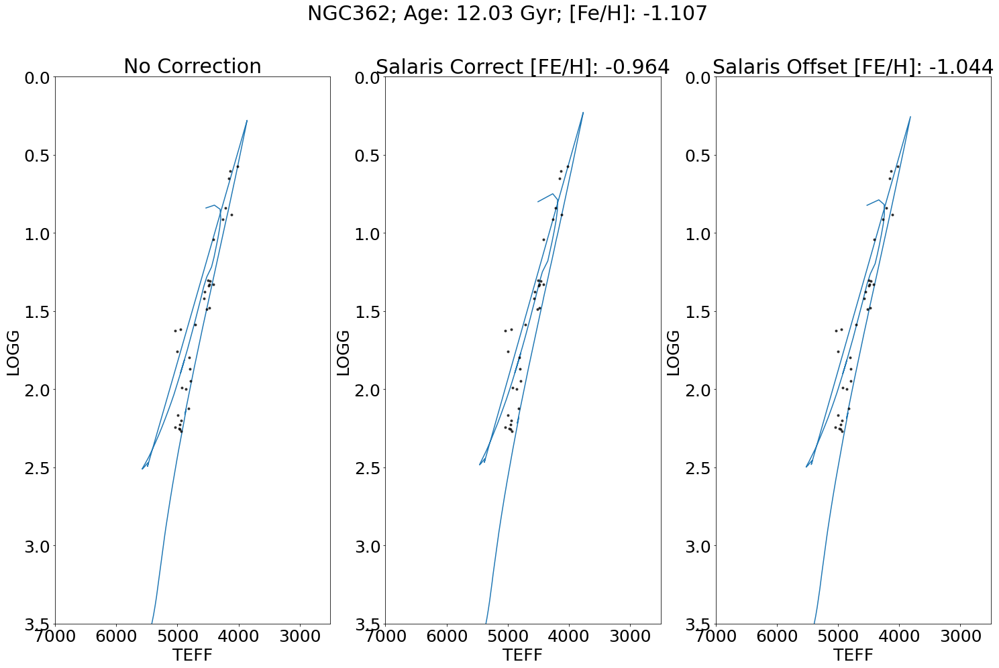

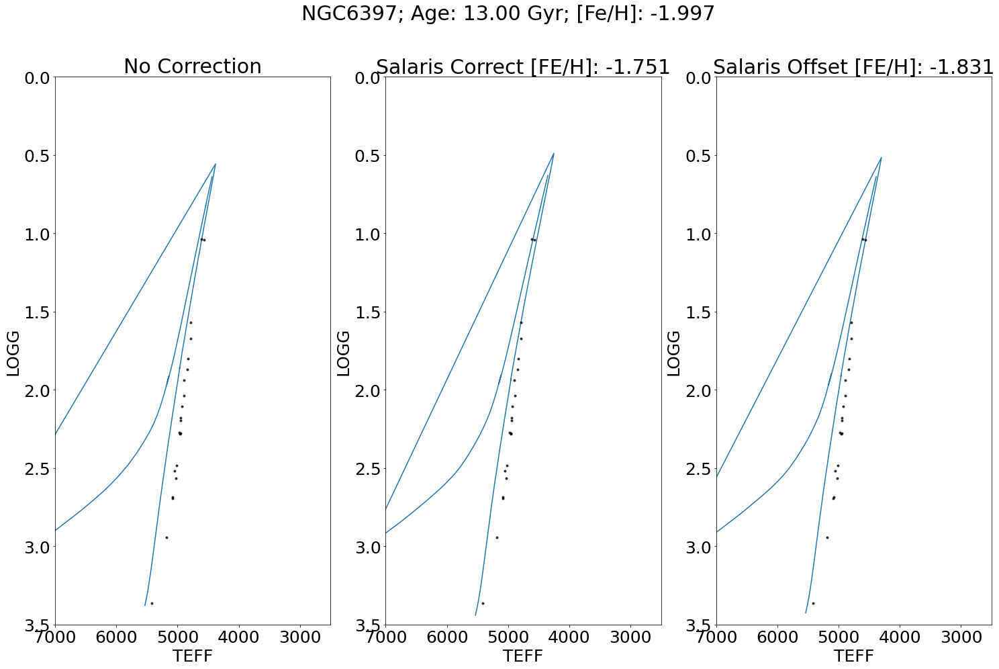

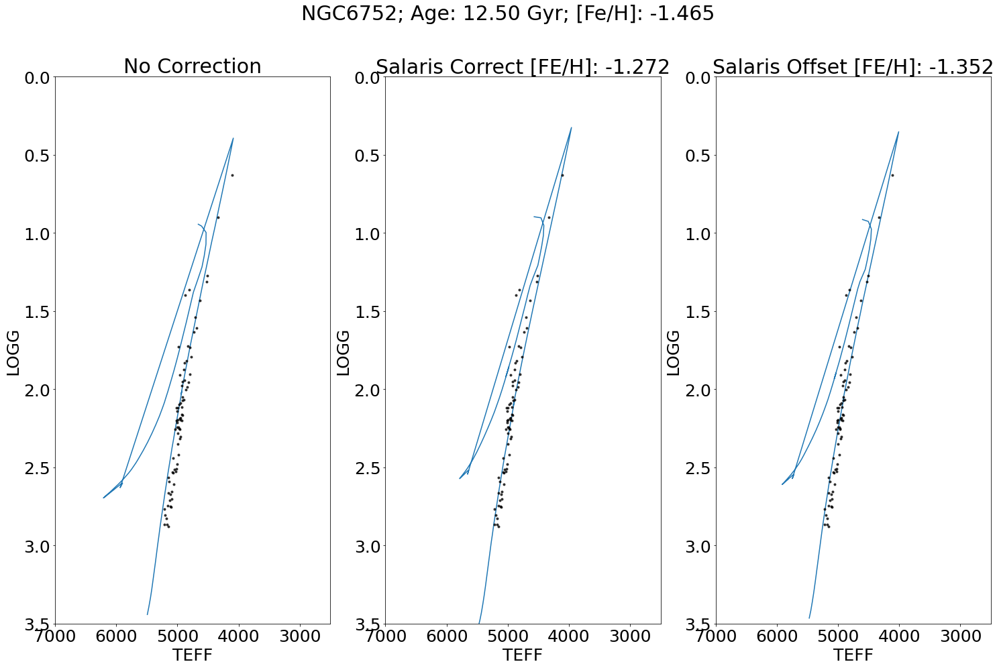

In [254]:
for i in range(len(gcs_clus)):
    clus = np.where(gcs['CLUSTER']==gcs_clus[i])
    isopick1 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian(gcsdr17['FE_H'][clus])))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    isopick2 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian((gcsdr17['FE_H']+np.log10(sal_a*fac_acn+sal_b))[clus])))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    isopick3 = np.where((massive['MH']==closest(massive['MH'],np.nanmedian((gcsdr17['FE_H']-0.08+np.log10(sal_a*fac_acn+sal_b))[clus])))&
                       (massive['logAge']==closest(massive['logAge'],np.log10(gcs_ages[i]*10**9))))
    
    fig, ax = plt.subplots(1,3,figsize=[25,15])

    ax[0].plot(10**massive['logTe'][isopick1],massive['logg'][isopick1],zorder=0)
    ax[0].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[0].set_xlabel(r'TEFF')
    ax[0].set_ylabel(r'LOGG')
    ax[0].set_ylim(0,3.5)
    ax[0].set_xlim(2500,7000)
    ax[0].invert_yaxis()
    ax[0].invert_xaxis()
    ax[0].set_title(r'No Correction')
    
    ax[1].plot(10**massive['logTe'][isopick2],massive['logg'][isopick2],zorder=0)
    ax[1].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[1].set_xlabel(r'TEFF')
    ax[1].set_ylabel(r'LOGG')
    ax[1].set_ylim(0,3.5)
    ax[1].set_xlim(2500,7000)
    ax[1].invert_yaxis()
    ax[1].invert_xaxis()
    ax[1].set_title(r'Salaris Correct [FE/H]: {:.3f}'.format(np.nanmedian((gcsdr17['FE_H']+np.log10(sal_a*fac_acn+sal_b))[clus])))
    
    ax[2].plot(10**massive['logTe'][isopick3],massive['logg'][isopick3],zorder=0)
    ax[2].scatter(gcsdr17['TEFF'][clus],gcsdr17['LOGG'][clus],c='k',marker='.',zorder=1,alpha=0.75)
    ax[2].set_xlabel(r'TEFF')
    ax[2].set_ylabel(r'LOGG')
    ax[2].set_ylim(0,3.5)
    ax[2].set_xlim(2500,7000)
    ax[2].invert_yaxis()
    ax[2].invert_xaxis()
    ax[2].set_title(r'Salaris Offset [FE/H]: {:.3f}'.format(np.nanmedian((gcsdr17['FE_H']-0.08+np.log10(sal_a*fac_acn+sal_b))[clus])))
    
    plt.suptitle(r'{}; Age: {:.2f} Gyr; [Fe/H]: {:.3f}'.format(gcs_clus[i],gcs_ages[i],
                                                                        np.nanmedian(gcsdr17['FE_H'][clus])))
    plt.savefig('{}NEWSalarisOffset.pdf'.format(gcs_clus[i]),bbox_inches='tight')
    plt.show()

In [250]:
np.nanmedian((gcsdr17['FE_H']+np.log10(sal_a*fac_acn+sal_b))[clus])

-0.47882789650835567

In [ ]:
6397 issues maybe toss